## Load

In [22]:
seu <- readRDS("/lustre/fs4/yng_lab/scratch/pkim/Singlecell/2025:01:31/seu.rds")

In [ ]:
# Use raw count matrix
counts <- GetAssayData(seu, slot = "counts", assay = "RNA")

# Create AnnotatedDataFrames for cells and genes
pd <- new("AnnotatedDataFrame", data = seu@meta.data)
fd <- new("AnnotatedDataFrame", data = data.frame(gene_short_name = rownames(counts), row.names = rownames(counts)))

# Create CDS while keeping matrix sparse
cds <- newCellDataSet(counts,
                      phenoData = pd,
                      featureData = fd,
                      expressionFamily = negbinomial.size())


## cds

In [1]:
#load scRNAseq
load("/lustre/fs4/yng_lab/scratch/pkim/Singlecell/2023:06:21/scRNA.image.RData")

In [2]:
library(Seurat)
library(Matrix)
library(monocle)
library(dplyr)

Loading required package: SeuratObject

Loading required package: sp


Attaching package: ‘SeuratObject’


The following objects are masked from ‘package:base’:

    intersect, t


Loading required package: Biobase

Loading required package: BiocGenerics


Attaching package: ‘BiocGenerics’


The following object is masked from ‘package:SeuratObject’:

    intersect


The following objects are masked from ‘package:stats’:

    IQR, mad, sd, var, xtabs


The following objects are masked from ‘package:base’:

    anyDuplicated, aperm, append, as.data.frame, basename, cbind,
    colnames, dirname, do.call, duplicated, eval, evalq, Filter, Find,
    get, grep, grepl, intersect, is.unsorted, lapply, Map, mapply,
    match, mget, order, paste, pmax, pmax.int, pmin, pmin.int,
    Position, rank, rbind, Reduce, rownames, sapply, setdiff, sort,
    table, tapply, union, unique, unsplit, which.max, which.min


Welcome to Bioconductor

    Vignettes contain introductory material; view with
    'br

In [35]:
#saveRDS(cds, "/lustre/fs4/yng_lab/scratch/pkim/Singlecell/2025:01:31/cds.rds")

In [4]:
cds <- cds[,cds$'batch' != '20230925']

In [5]:
cds <- cds[,cds$final_Conditions != 'WT_Fem_CT28_1']
cds <- cds[,cds$final_Conditions != 'WT_Mal_CT28_1']

In [ ]:
unique(cds$final_Conditions)
unique(cds$timepoint)
cds$final_timepoints <- sub(".*(ZT\\d+).*", "\\1", cds$final_Conditions)
cds$final_timepoints <- sub(".*(CT\\d+).*", "\\1", cds$final_timepoints)
unique(cds$final_timepoints)
unique(cds$replicate)
cds$pseudo_replicate <- NA

In [ ]:
# Set the number of desired replicates (Sum & Split)
number_of_replicates <- 2

# Make sure that you don't have NA for unsup_celltype
cds$all_celltype[cds$all_celltype == "nan"] <- "Unannotated"
cds$all_celltype[is.na(cds$all_celltype)] <- "Unannotated"

# Ensure equal splitting of cells by 'Sum' and 'unsup_celltype'
cds$pseudo_replicate <- ave(cds$final_timepoints, cds$final_timepoints, cds$all_celltype, FUN = function(x) {
  # For each combination of 'Sum' and 'unsup_celltype', split into 2 pseudo-replicates
  n <- length(x)
  if (n == 1) {
    # If there's only one cell, assign it to replicate 1
    return(paste0(x, "_1"))
  } else {
    # If more than one cell, assign cells as evenly as possible to the 2 replicates
    replicate_ids <- rep(1:number_of_replicates, length.out = n)
    replicate_ids <- sample(replicate_ids)  # Randomize the assignment
    return(paste0(x, "_", replicate_ids))
  }
})

str(cds$final_timepoints)
str(cds$all_celltype)
str(cds$pseudo_replicate)

In [ ]:
unique(cds$sex)

In [23]:
#cds <- cds[,cds$sex == 'Male']

In [9]:
wtzt <- cds[,(cds$light_condition == "LD") & (cds$genotype == "Wild-type")]
wtct <- cds[,(cds$light_condition == "DD") & (cds$genotype == "Wild-type")]
mtzt <- cds[,(cds$light_condition == "LD") & (cds$genotype == "per0")]
mtct <- cds[,(cds$light_condition == "DD") & (cds$genotype == "per0")]

In [123]:
saveRDS(filtered_master_list, 'filtered_master_list_WT_ZT_rhythmic genes that peak at different phases.rds')

In [113]:
cds$Sum2[cds$pseudo_replicate == "WT0_1"] <- "WT0"
cds$Sum2[cds$pseudo_replicate == "WT4_1"] <- "WT4"
cds$Sum2[cds$pseudo_replicate == "WT8_1"] <- "WT8"
cds$Sum2[cds$pseudo_replicate == "WT12_1"] <- "WT12"
cds$Sum2[cds$pseudo_replicate == "WT16_1"] <- "WT16"
cds$Sum2[cds$pseudo_replicate == "WT20_1"] <- "WT20"
cds$Sum2[cds$pseudo_replicate == "WT0_2"] <- "WT24"
cds$Sum2[cds$pseudo_replicate == "WT4_2"] <- "WT28"
cds$Sum2[cds$pseudo_replicate == "WT8_2"] <- "WT32"
cds$Sum2[cds$pseudo_replicate == "WT12_2"] <- "WT36"
cds$Sum2[cds$pseudo_replicate == "WT16_2"] <- "WT40"
cds$Sum2[cds$pseudo_replicate == "WT20_2"] <- "WT44"

# Load necessary libraries
library(Matrix.utils)
library(pheatmap)
library(ggplot2)
library(grid)
library(gridExtra)
library(tidyr)

# Load JTK_CYCLE script
source("/lustre/fs4/yng_lab/scratch/pkim/JTK_CYCLE/JTKversion3/JTK_CYCLEv3.1.R")

# Assuming gene_mm_celltype is already loaded
# Load the RDS file if necessary
# gene_mm_celltype <- readRDS("path/to/your/gene_mm_celltype.RDS")

# 1. Identify Unique Cell Types
cell_type_info <- strsplit(colnames(gene_mm_celltype), "_WT")
unique_cell_types <- unique(sapply(cell_type_info, `[`, 1))

# Initialize a list to hold dataframes for each valid cell type, chronologically ordered
cell_type_dfs_ordered <- list()

# 2. Filter Out Incomplete Cell Types, 3. Create Separate Dataframes, and 4. Order Chronologically
for (cell_type in unique_cell_types) {
  # Construct the pattern to match columns for this cell type
  pattern <- paste0("^", cell_type, "_WT")
  
  # Subset dataframe for the current cell type
  subset_df <- gene_mm_celltype[, grepl(pattern, colnames(gene_mm_celltype)), drop = FALSE]
  
  # Extract time points, convert them to numeric, and order columns chronologically
  time_points_str <- gsub(paste0(cell_type, "_WT"), "", colnames(subset_df))
  time_points <- as.numeric(time_points_str)
  ordered_cols <- order(time_points)
  subset_df_ordered <- subset_df[, ordered_cols, drop = FALSE]
  
  # Check if all expected time points are present, adjust the range as per your dataset
  expected_time_points <- seq(0, 44, by = 4)  # Example range
  all_time_points_present <- all(expected_time_points %in% time_points)
  
  # If all time points are present, add to the list
  if (all_time_points_present) {
    cell_type_dfs_ordered[[cell_type]] <- subset_df_ordered
  }
}

# Initialize master_list to ensure it's empty before starting the loop
master_list <- list()

# Initialize a list to hold the LAG values for each gene across cell types
gene_lag_list <- list()

# Iterate over each cell type's dataframe
for (cell_type in names(cell_type_dfs_ordered)) {
  df <- cell_type_dfs_ordered[[cell_type]]
  
  # Extracting directly from gene_mm_bulk for JTK_CYCLE
  df_bulk_expr_subset <- df
  new_col_names <- paste0("ZT", seq(0, 44, by = 4))
  colnames(df_bulk_expr_subset) <- new_col_names
  df_bulk_expr_subset <- data.frame(Gene = rownames(df_bulk_expr_subset), df_bulk_expr_subset)
  rownames(df_bulk_expr_subset) <- NULL
  
  # Identify and sum duplicate gene rows
  duplicated_genes <- df_bulk_expr_subset$Gene[duplicated(df_bulk_expr_subset$Gene)]
  for (gene in duplicated_genes) {
    duplicate_rows <- df_bulk_expr_subset$Gene == gene
    duplicate_expr <- unlist(df_bulk_expr_subset[duplicate_rows, -1])
    duplicate_expr <- as.numeric(duplicate_expr)
    sum_expression <- colSums(matrix(duplicate_expr, nrow = sum(duplicate_rows)))
    df_bulk_expr_subset <- df_bulk_expr_subset[!duplicate_rows, ]
    new_row <- c(gene, sum_expression)
    df_bulk_expr_subset <- rbind(df_bulk_expr_subset, new_row)
  }
  
  data <- df_bulk_expr_subset
  data <- as.data.frame(sapply(data, as.numeric))
  data$Gene <- df_bulk_expr_subset$Gene
  annot <- data.frame(df_bulk_expr_subset$Gene)
  
  # Running JTK_CYCLE
  project <- "Trial"
  options(stringsAsFactors = FALSE)
  rownames(data) <- data[, 1]
  data <- data[, -1]
  jtkdist(ncol(data))
  periods <- 6:6
  jtk.init(periods, 4)
  cat("JTK analysis started on", date(), "\n")
  flush.console()
  st <- system.time({
    res <- apply(data, 1, function(z) {
      jtkx(z)
      c(JTK.ADJP, JTK.PERIOD, JTK.LAG, JTK.AMP)
    })
    res <- as.data.frame(t(res))
    bhq <- p.adjust(unlist(res[, 1]), "BH")
    res <- cbind(bhq, res)
    colnames(res) <- c("BH.Q", "ADJ.P", "PER", "LAG", "AMP")
    results <- cbind(annot, res, data)
    results <- results[order(res$ADJ.P, -res$AMP), ]
  })
  print(st)
  
  subdata <- subset(results, ADJ.P < 0.05)
  subdata <- subdata[order(subdata$LAG, decreasing = FALSE), ]
  
  # Extract the gene names and LAG values
  rhythmic_genes <- subdata$df_bulk_expr_subset.Gene
  gene_lags <- subdata$LAG
  
  # Store the LAG values for each gene
  for (i in seq_along(rhythmic_genes)) {
    gene <- rhythmic_genes[i]
    lag_value <- gene_lags[i]
    if (!is.null(gene_lag_list[[gene]])) {
      gene_lag_list[[gene]][[cell_type]] <- lag_value
    } else {
      gene_lag_list[[gene]] <- list(cell_type = lag_value)
    }
  }
}

# Function to check if LAG differences meet the criteria
lag_difference_valid <- function(lags) {
  n <- length(lags)
  if (n < 2) return(FALSE)
  for (i in 1:(n-1)) {
    for (j in (i+1):n) {
      diff <- abs(lags[i] - lags[j])
      if (diff == 12 || diff == 6 || diff == 8 || 10 || (diff == 22 && abs(diff - 24) == 6)) {
        return(TRUE)
      }
    }
  }
  return(FALSE)
}

# Filter genes with the desired LAG differences and clean unwanted entries
filtered_master_list <- list()
for (gene in names(gene_lag_list)) {
  lags <- unlist(gene_lag_list[[gene]])
  if (lag_difference_valid(lags)) {
    # Exclude "cell_type" and "NA" entries
    cell_types <- names(gene_lag_list[[gene]])
    cell_types <- cell_types[!cell_types %in% c("cell_type", "NA", "Unannotated")]
    
    # Ensure the gene is detected in at least two cell types
    if (length(cell_types) >= 2) {
      filtered_master_list[[gene]] <- cell_types
    }
  }
}

# Display the cleaned and filtered master_list
head(filtered_master_list)

# Now cell_type_subdata_list contains the post-JTK_CYCLE filtered data for each cell type.
# You can save the entire list as an RDS file or work with it directly in your analysis.
# saveRDS(filtered_master_list, "filtered_master_list.rds")

Warning message in lapply(X = X, FUN = FUN, ...):
“NAs introduced by coercion”


JTK analysis started on Fri Feb 28 14:14:15 2025 
   user  system elapsed 
  9.621   0.204   9.825 


Warning message in lapply(X = X, FUN = FUN, ...):
“NAs introduced by coercion”


JTK analysis started on Fri Feb 28 14:14:25 2025 
   user  system elapsed 
  9.833   0.086   9.921 


Warning message in lapply(X = X, FUN = FUN, ...):
“NAs introduced by coercion”


JTK analysis started on Fri Feb 28 14:14:36 2025 
   user  system elapsed 
  9.480   0.134   9.614 


Warning message in lapply(X = X, FUN = FUN, ...):
“NAs introduced by coercion”


JTK analysis started on Fri Feb 28 14:14:46 2025 
   user  system elapsed 
  9.572   0.177   9.750 


Warning message in lapply(X = X, FUN = FUN, ...):
“NAs introduced by coercion”


JTK analysis started on Fri Feb 28 14:14:57 2025 
   user  system elapsed 
  9.420   0.139   9.560 


Warning message in lapply(X = X, FUN = FUN, ...):
“NAs introduced by coercion”


JTK analysis started on Fri Feb 28 14:15:07 2025 
   user  system elapsed 
  9.595   0.135   9.731 


Warning message in lapply(X = X, FUN = FUN, ...):
“NAs introduced by coercion”


JTK analysis started on Fri Feb 28 14:15:17 2025 
   user  system elapsed 
  9.038   0.145   9.183 


Warning message in lapply(X = X, FUN = FUN, ...):
“NAs introduced by coercion”


JTK analysis started on Fri Feb 28 14:15:27 2025 
   user  system elapsed 
  9.285   0.136   9.421 


Warning message in lapply(X = X, FUN = FUN, ...):
“NAs introduced by coercion”


JTK analysis started on Fri Feb 28 14:15:37 2025 
   user  system elapsed 
 10.025   0.133  10.159 


Warning message in lapply(X = X, FUN = FUN, ...):
“NAs introduced by coercion”


JTK analysis started on Fri Feb 28 14:15:48 2025 
   user  system elapsed 
  9.795   0.173   9.968 


Warning message in lapply(X = X, FUN = FUN, ...):
“NAs introduced by coercion”


JTK analysis started on Fri Feb 28 14:15:58 2025 
   user  system elapsed 
  9.691   0.156   9.848 


Warning message in lapply(X = X, FUN = FUN, ...):
“NAs introduced by coercion”


JTK analysis started on Fri Feb 28 14:16:09 2025 
   user  system elapsed 
  9.823   0.129   9.953 


Warning message in lapply(X = X, FUN = FUN, ...):
“NAs introduced by coercion”


JTK analysis started on Fri Feb 28 14:16:19 2025 
   user  system elapsed 
  9.688   0.168   9.857 


Warning message in lapply(X = X, FUN = FUN, ...):
“NAs introduced by coercion”


JTK analysis started on Fri Feb 28 14:16:30 2025 
   user  system elapsed 
  9.803   0.183   9.987 


Warning message in lapply(X = X, FUN = FUN, ...):
“NAs introduced by coercion”


JTK analysis started on Fri Feb 28 14:16:40 2025 
   user  system elapsed 
 10.155   0.139  10.294 


Warning message in lapply(X = X, FUN = FUN, ...):
“NAs introduced by coercion”


JTK analysis started on Fri Feb 28 14:16:51 2025 
   user  system elapsed 
  9.744   0.162   9.907 


Warning message in lapply(X = X, FUN = FUN, ...):
“NAs introduced by coercion”


JTK analysis started on Fri Feb 28 14:17:01 2025 
   user  system elapsed 
  9.663   0.147   9.811 


Warning message in lapply(X = X, FUN = FUN, ...):
“NAs introduced by coercion”


JTK analysis started on Fri Feb 28 14:17:12 2025 
   user  system elapsed 
  9.688   0.133   9.822 


Warning message in lapply(X = X, FUN = FUN, ...):
“NAs introduced by coercion”


JTK analysis started on Fri Feb 28 14:17:22 2025 
   user  system elapsed 
  9.667   0.159   9.827 


Warning message in lapply(X = X, FUN = FUN, ...):
“NAs introduced by coercion”


JTK analysis started on Fri Feb 28 14:17:33 2025 
   user  system elapsed 
  9.690   0.172   9.862 


Warning message in lapply(X = X, FUN = FUN, ...):
“NAs introduced by coercion”


JTK analysis started on Fri Feb 28 14:17:43 2025 
   user  system elapsed 
 10.150   0.136  10.286 


Warning message in lapply(X = X, FUN = FUN, ...):
“NAs introduced by coercion”


JTK analysis started on Fri Feb 28 14:17:54 2025 
   user  system elapsed 
  9.645   0.162   9.808 


Warning message in lapply(X = X, FUN = FUN, ...):
“NAs introduced by coercion”


JTK analysis started on Fri Feb 28 14:18:04 2025 
   user  system elapsed 
  9.493   0.156   9.650 


Warning message in lapply(X = X, FUN = FUN, ...):
“NAs introduced by coercion”


JTK analysis started on Fri Feb 28 14:18:14 2025 
   user  system elapsed 
  9.076   0.124   9.201 


Warning message in lapply(X = X, FUN = FUN, ...):
“NAs introduced by coercion”


JTK analysis started on Fri Feb 28 14:18:24 2025 
   user  system elapsed 
  8.915   0.158   9.073 


Warning message in lapply(X = X, FUN = FUN, ...):
“NAs introduced by coercion”


JTK analysis started on Fri Feb 28 14:18:34 2025 
   user  system elapsed 
  9.459   0.160   9.620 


Warning message in lapply(X = X, FUN = FUN, ...):
“NAs introduced by coercion”


JTK analysis started on Fri Feb 28 14:18:44 2025 
   user  system elapsed 
  9.839   0.141   9.980 


Warning message in lapply(X = X, FUN = FUN, ...):
“NAs introduced by coercion”


JTK analysis started on Fri Feb 28 14:18:55 2025 
   user  system elapsed 
  9.629   0.167   9.797 


Warning message in lapply(X = X, FUN = FUN, ...):
“NAs introduced by coercion”


JTK analysis started on Fri Feb 28 14:19:05 2025 
   user  system elapsed 
  9.381   0.167   9.548 


Warning message in lapply(X = X, FUN = FUN, ...):
“NAs introduced by coercion”


JTK analysis started on Fri Feb 28 14:19:15 2025 
   user  system elapsed 
  9.506   0.144   9.650 


Warning message in lapply(X = X, FUN = FUN, ...):
“NAs introduced by coercion”


JTK analysis started on Fri Feb 28 14:19:25 2025 
   user  system elapsed 
  9.338   0.157   9.496 


Warning message in lapply(X = X, FUN = FUN, ...):
“NAs introduced by coercion”


JTK analysis started on Fri Feb 28 14:19:35 2025 
   user  system elapsed 
  9.424   0.166   9.590 


Warning message in lapply(X = X, FUN = FUN, ...):
“NAs introduced by coercion”


JTK analysis started on Fri Feb 28 14:19:46 2025 
   user  system elapsed 
  9.746   0.145   9.891 


Warning message in lapply(X = X, FUN = FUN, ...):
“NAs introduced by coercion”


JTK analysis started on Fri Feb 28 14:19:56 2025 
   user  system elapsed 
  9.419   0.150   9.569 


Warning message in lapply(X = X, FUN = FUN, ...):
“NAs introduced by coercion”


JTK analysis started on Fri Feb 28 14:20:06 2025 
   user  system elapsed 
  9.685   0.176   9.861 


Warning message in lapply(X = X, FUN = FUN, ...):
“NAs introduced by coercion”


JTK analysis started on Fri Feb 28 14:20:17 2025 
   user  system elapsed 
  9.628   0.137   9.766 


Warning message in lapply(X = X, FUN = FUN, ...):
“NAs introduced by coercion”


JTK analysis started on Fri Feb 28 14:20:27 2025 
   user  system elapsed 
  9.570   0.146   9.716 


Warning message in lapply(X = X, FUN = FUN, ...):
“NAs introduced by coercion”


JTK analysis started on Fri Feb 28 14:20:37 2025 
   user  system elapsed 
  9.684   0.186   9.870 


Warning message in lapply(X = X, FUN = FUN, ...):
“NAs introduced by coercion”


JTK analysis started on Fri Feb 28 14:20:48 2025 
   user  system elapsed 
 10.104   0.137  10.242 


Warning message in lapply(X = X, FUN = FUN, ...):
“NAs introduced by coercion”


JTK analysis started on Fri Feb 28 14:20:58 2025 
   user  system elapsed 
  9.852   0.157  10.008 


Warning message in lapply(X = X, FUN = FUN, ...):
“NAs introduced by coercion”


JTK analysis started on Fri Feb 28 14:21:09 2025 
   user  system elapsed 
  9.858   0.185  10.043 


Warning message in lapply(X = X, FUN = FUN, ...):
“NAs introduced by coercion”


JTK analysis started on Fri Feb 28 14:21:20 2025 
   user  system elapsed 
  9.822   0.143   9.965 


Warning message in lapply(X = X, FUN = FUN, ...):
“NAs introduced by coercion”


JTK analysis started on Fri Feb 28 14:21:30 2025 
   user  system elapsed 
  9.842   0.157  10.000 


Warning message in lapply(X = X, FUN = FUN, ...):
“NAs introduced by coercion”


JTK analysis started on Fri Feb 28 14:21:41 2025 
   user  system elapsed 
 10.258   0.219  10.478 


Warning message in lapply(X = X, FUN = FUN, ...):
“NAs introduced by coercion”


JTK analysis started on Fri Feb 28 14:21:52 2025 
   user  system elapsed 
  9.913   0.144  10.057 


Warning message in lapply(X = X, FUN = FUN, ...):
“NAs introduced by coercion”


JTK analysis started on Fri Feb 28 14:22:02 2025 
   user  system elapsed 
  9.829   0.164   9.993 


Warning message in lapply(X = X, FUN = FUN, ...):
“NAs introduced by coercion”


JTK analysis started on Fri Feb 28 14:22:13 2025 
   user  system elapsed 
  9.775   0.175   9.950 


Warning message in lapply(X = X, FUN = FUN, ...):
“NAs introduced by coercion”


JTK analysis started on Fri Feb 28 14:22:23 2025 
   user  system elapsed 
  9.890   0.147  10.038 


Warning message in lapply(X = X, FUN = FUN, ...):
“NAs introduced by coercion”


JTK analysis started on Fri Feb 28 14:22:34 2025 
   user  system elapsed 
  9.826   0.164   9.990 


Warning message in lapply(X = X, FUN = FUN, ...):
“NAs introduced by coercion”


JTK analysis started on Fri Feb 28 14:22:45 2025 
   user  system elapsed 
 10.296   0.181  10.477 


Warning message in lapply(X = X, FUN = FUN, ...):
“NAs introduced by coercion”


JTK analysis started on Fri Feb 28 14:22:56 2025 
   user  system elapsed 
  9.789   0.147   9.936 


Warning message in lapply(X = X, FUN = FUN, ...):
“NAs introduced by coercion”


JTK analysis started on Fri Feb 28 14:23:06 2025 
   user  system elapsed 
  9.748   0.168   9.917 


Warning message in lapply(X = X, FUN = FUN, ...):
“NAs introduced by coercion”


JTK analysis started on Fri Feb 28 14:23:17 2025 
   user  system elapsed 
  9.955   0.165  10.119 


Warning message in lapply(X = X, FUN = FUN, ...):
“NAs introduced by coercion”


JTK analysis started on Fri Feb 28 14:23:27 2025 
   user  system elapsed 
  9.671   0.140   9.811 


Warning message in lapply(X = X, FUN = FUN, ...):
“NAs introduced by coercion”


JTK analysis started on Fri Feb 28 14:23:38 2025 
   user  system elapsed 
 10.197   0.171  10.368 


Warning message in lapply(X = X, FUN = FUN, ...):
“NAs introduced by coercion”


JTK analysis started on Fri Feb 28 14:23:49 2025 
   user  system elapsed 
  9.799   0.183   9.983 


Warning message in lapply(X = X, FUN = FUN, ...):
“NAs introduced by coercion”


JTK analysis started on Fri Feb 28 14:23:59 2025 
   user  system elapsed 
  9.764   0.129   9.894 


Warning message in lapply(X = X, FUN = FUN, ...):
“NAs introduced by coercion”


JTK analysis started on Fri Feb 28 14:24:10 2025 
   user  system elapsed 
  9.786   0.167   9.953 


Warning message in lapply(X = X, FUN = FUN, ...):
“NAs introduced by coercion”


JTK analysis started on Fri Feb 28 14:24:20 2025 
   user  system elapsed 
  9.379   0.168   9.548 


Warning message in lapply(X = X, FUN = FUN, ...):
“NAs introduced by coercion”


JTK analysis started on Fri Feb 28 14:24:30 2025 
   user  system elapsed 
  9.710   0.144   9.854 


Warning message in lapply(X = X, FUN = FUN, ...):
“NAs introduced by coercion”


JTK analysis started on Fri Feb 28 14:24:41 2025 
   user  system elapsed 
  9.908   0.168  10.076 


Warning message in lapply(X = X, FUN = FUN, ...):
“NAs introduced by coercion”


JTK analysis started on Fri Feb 28 14:24:52 2025 
   user  system elapsed 
  9.649   0.183   9.832 


Warning message in lapply(X = X, FUN = FUN, ...):
“NAs introduced by coercion”


JTK analysis started on Fri Feb 28 14:25:02 2025 
   user  system elapsed 
  9.264   0.139   9.403 


Warning message in lapply(X = X, FUN = FUN, ...):
“NAs introduced by coercion”


JTK analysis started on Fri Feb 28 14:25:12 2025 
   user  system elapsed 
  9.833   0.171  10.005 


Warning message in lapply(X = X, FUN = FUN, ...):
“NAs introduced by coercion”


JTK analysis started on Fri Feb 28 14:25:22 2025 
   user  system elapsed 
  9.662   0.175   9.838 


Warning message in lapply(X = X, FUN = FUN, ...):
“NAs introduced by coercion”


JTK analysis started on Fri Feb 28 14:25:33 2025 
   user  system elapsed 
  9.634   0.143   9.778 


Warning message in lapply(X = X, FUN = FUN, ...):
“NAs introduced by coercion”


JTK analysis started on Fri Feb 28 14:25:43 2025 
   user  system elapsed 
  9.994   0.170  10.165 


Warning message in lapply(X = X, FUN = FUN, ...):
“NAs introduced by coercion”


JTK analysis started on Fri Feb 28 14:25:54 2025 
   user  system elapsed 
  9.850   0.166  10.016 


Warning message in lapply(X = X, FUN = FUN, ...):
“NAs introduced by coercion”


JTK analysis started on Fri Feb 28 14:26:05 2025 
   user  system elapsed 
  9.738   0.142   9.880 


Warning message in lapply(X = X, FUN = FUN, ...):
“NAs introduced by coercion”


JTK analysis started on Fri Feb 28 14:26:15 2025 
   user  system elapsed 
  9.697   0.167   9.864 


Warning message in lapply(X = X, FUN = FUN, ...):
“NAs introduced by coercion”


JTK analysis started on Fri Feb 28 14:26:25 2025 
   user  system elapsed 
  9.505   0.162   9.668 


Warning message in lapply(X = X, FUN = FUN, ...):
“NAs introduced by coercion”


JTK analysis started on Fri Feb 28 14:26:36 2025 
   user  system elapsed 
  9.864   0.150  10.015 


Warning message in lapply(X = X, FUN = FUN, ...):
“NAs introduced by coercion”


JTK analysis started on Fri Feb 28 14:26:46 2025 
   user  system elapsed 
 10.105   0.172  10.278 


Warning message in lapply(X = X, FUN = FUN, ...):
“NAs introduced by coercion”


JTK analysis started on Fri Feb 28 14:26:57 2025 
   user  system elapsed 
  9.807   0.173   9.981 


Warning message in lapply(X = X, FUN = FUN, ...):
“NAs introduced by coercion”


JTK analysis started on Fri Feb 28 14:27:08 2025 
   user  system elapsed 
  9.727   0.146   9.873 


Warning message in lapply(X = X, FUN = FUN, ...):
“NAs introduced by coercion”


JTK analysis started on Fri Feb 28 14:27:18 2025 
   user  system elapsed 
  9.381   0.163   9.544 


Warning message in lapply(X = X, FUN = FUN, ...):
“NAs introduced by coercion”


JTK analysis started on Fri Feb 28 14:27:28 2025 
   user  system elapsed 
  8.347   0.143   8.490 


Warning message in lapply(X = X, FUN = FUN, ...):
“NAs introduced by coercion”


JTK analysis started on Fri Feb 28 14:27:37 2025 
   user  system elapsed 
  9.382   0.138   9.521 


Warning message in lapply(X = X, FUN = FUN, ...):
“NAs introduced by coercion”


JTK analysis started on Fri Feb 28 14:27:48 2025 
   user  system elapsed 
  9.829   0.148   9.978 


Warning message in lapply(X = X, FUN = FUN, ...):
“NAs introduced by coercion”


JTK analysis started on Fri Feb 28 14:27:58 2025 
   user  system elapsed 
  9.608   0.174   9.782 


Warning message in lapply(X = X, FUN = FUN, ...):
“NAs introduced by coercion”


JTK analysis started on Fri Feb 28 14:28:08 2025 
   user  system elapsed 
  9.867   0.143  10.010 


Warning message in lapply(X = X, FUN = FUN, ...):
“NAs introduced by coercion”


JTK analysis started on Fri Feb 28 14:28:19 2025 
   user  system elapsed 
  9.382   0.141   9.524 


Warning message in lapply(X = X, FUN = FUN, ...):
“NAs introduced by coercion”


JTK analysis started on Fri Feb 28 14:28:29 2025 
   user  system elapsed 
  9.647   0.186   9.833 


Warning message in lapply(X = X, FUN = FUN, ...):
“NAs introduced by coercion”


JTK analysis started on Fri Feb 28 14:28:40 2025 
   user  system elapsed 
 10.026   0.141  10.168 


Warning message in lapply(X = X, FUN = FUN, ...):
“NAs introduced by coercion”


JTK analysis started on Fri Feb 28 14:28:50 2025 
   user  system elapsed 
  9.595   0.146   9.743 


Warning message in lapply(X = X, FUN = FUN, ...):
“NAs introduced by coercion”


JTK analysis started on Fri Feb 28 14:29:01 2025 
   user  system elapsed 
  9.566   0.194   9.760 


Warning message in lapply(X = X, FUN = FUN, ...):
“NAs introduced by coercion”


JTK analysis started on Fri Feb 28 14:29:11 2025 
   user  system elapsed 
  9.503   0.128   9.632 


Warning message in lapply(X = X, FUN = FUN, ...):
“NAs introduced by coercion”


JTK analysis started on Fri Feb 28 14:29:21 2025 
   user  system elapsed 
  9.611   0.151   9.764 


Warning message in lapply(X = X, FUN = FUN, ...):
“NAs introduced by coercion”


JTK analysis started on Fri Feb 28 14:29:32 2025 
   user  system elapsed 
  9.454   0.207   9.662 


Warning message in lapply(X = X, FUN = FUN, ...):
“NAs introduced by coercion”


JTK analysis started on Fri Feb 28 14:29:42 2025 
   user  system elapsed 
  9.843   0.119   9.962 


Warning message in lapply(X = X, FUN = FUN, ...):
“NAs introduced by coercion”


JTK analysis started on Fri Feb 28 14:29:52 2025 
   user  system elapsed 
  9.734   0.151   9.884 


Warning message in lapply(X = X, FUN = FUN, ...):
“NAs introduced by coercion”


JTK analysis started on Fri Feb 28 14:30:03 2025 
   user  system elapsed 
  9.889   0.198  10.087 


Warning message in lapply(X = X, FUN = FUN, ...):
“NAs introduced by coercion”


JTK analysis started on Fri Feb 28 14:30:14 2025 
   user  system elapsed 
  9.643   0.122   9.765 


Warning message in lapply(X = X, FUN = FUN, ...):
“NAs introduced by coercion”


JTK analysis started on Fri Feb 28 14:30:24 2025 
   user  system elapsed 
  9.544   0.149   9.693 


Warning message in lapply(X = X, FUN = FUN, ...):
“NAs introduced by coercion”


JTK analysis started on Fri Feb 28 14:30:34 2025 
   user  system elapsed 
  9.876   0.199  10.075 


Warning message in lapply(X = X, FUN = FUN, ...):
“NAs introduced by coercion”


JTK analysis started on Fri Feb 28 14:30:45 2025 
   user  system elapsed 
 10.003   0.126  10.129 


Warning message in lapply(X = X, FUN = FUN, ...):
“NAs introduced by coercion”


JTK analysis started on Fri Feb 28 14:30:56 2025 
   user  system elapsed 
  9.680   0.148   9.829 


Warning message in lapply(X = X, FUN = FUN, ...):
“NAs introduced by coercion”


JTK analysis started on Fri Feb 28 14:31:06 2025 
   user  system elapsed 
  9.680   0.207   9.915 


Warning message in lapply(X = X, FUN = FUN, ...):
“NAs introduced by coercion”


JTK analysis started on Fri Feb 28 14:31:16 2025 
   user  system elapsed 
  9.729   0.117   9.848 


Warning message in lapply(X = X, FUN = FUN, ...):
“NAs introduced by coercion”


JTK analysis started on Fri Feb 28 14:31:27 2025 
   user  system elapsed 
  9.735   0.153   9.888 


Warning message in lapply(X = X, FUN = FUN, ...):
“NAs introduced by coercion”


JTK analysis started on Fri Feb 28 14:31:37 2025 
   user  system elapsed 
 10.184   0.241  10.426 


Warning message in lapply(X = X, FUN = FUN, ...):
“NAs introduced by coercion”


JTK analysis started on Fri Feb 28 14:31:48 2025 
   user  system elapsed 
  9.798   0.131   9.929 


Warning message in lapply(X = X, FUN = FUN, ...):
“NAs introduced by coercion”


JTK analysis started on Fri Feb 28 14:31:59 2025 
   user  system elapsed 
  8.317   0.134   8.453 


$CG1578
[1] "L1"   "OAN"  "OCR"  "R1-6" "T1"  

$Alk
[1] "Dm1"  "L1"   "LC6"  "MUS"  "OAN"  "PGM"  "R1-6" "Tm9" 

$Ltn1
[1] "Lai"  "Mi15" "RNPG"

$nSyb
[1] "CBG"    "CONE_1" "FAT_2"  "HE"     "L3"     "LC10d"  "Pm4"    "R1-6"  
[9] "RNPG"  

$CG42271
[1] "DCN" "Mi1"

$Hcf
[1] "KCab"  "LAWF1" "Tm1"

In [122]:
filtered_master_list

$CG1578
[1] "L1"   "OAN"  "OCR"  "R1-6" "T1"  

$Alk
[1] "Dm1"  "L1"   "LC6"  "MUS"  "OAN"  "PGM"  "R1-6" "Tm9" 

$Ltn1
[1] "Lai"  "Mi15" "RNPG"

$nSyb
[1] "CBG"    "CONE_1" "FAT_2"  "HE"     "L3"     "LC10d"  "Pm4"    "R1-6"  
[9] "RNPG"  

$CG42271
[1] "DCN" "Mi1"

$Hcf
[1] "KCab"  "LAWF1" "Tm1"  

$wry
[1] "CLKN"       "EB-RN"      "KCapbp"     "L3"         "LC22_LPLC4"
[6] "R1-6"       "T1"        

$Apc
[1] "C2"   "DCN"  "HE"   "PB"   "R1-6" "T4T5"

$Atet
[1] "Dm11" "DRA"  "PNG"  "R1-6" "Tm4" 

$`lncRNA:noe`
 [1] "CONE_1" "CONE_2" "Dm8"    "Dm9"    "ENSG"   "L5"     "LAWF2"  "Mi1"   
 [9] "OCHG"   "PNG"    "R1-6"   "R7"     "RNPG"   "T3"     "T4T5"   "Tm2"   
[17] "Tm5a"   "TmY8"  

$ush
[1] "Dm3"  "Dm9"  "OAN"  "OCHG" "PGM"  "R1-6" "R7"   "R8"  

$Tl
[1] "LPLC2" "R1-6"  "Tm1"  

$CG31221
 [1] "CBG"    "CONE_1" "CONE_2" "EPI"    "JON"    "L5"     "MUS"    "PGM"   
 [9] "PNG"    "Tm1"    "Tm4"    "Tm9"    "TmY4"  

$Uba1
[1] "CONE_2" "L3"     "R1-6"   "Tm4"   

$DUBAI
[1] "EPI"   "L3"    "OLCTG" "R1-6" 

$`lncRNA:CR45938`
[1] "EB-RN" "R1-6"  "Tm2"  

$`Rbcn-3B`
[1] "Lai"   "Mi4"   "T3"    "TmY14"

$CG18171
[1] "CONE_1" "EPI"    "FAT_1"  "R1-6"   "R8"    

$Frq1
 [1] "CLKN"   "CONE_1" "DCN"    "L1"     "L3"     "L4"     "LC16"   "LC4"   
 [9] "OCR"    "PGM"    "R1-6"   "T1"    

$dlg1
[1] "C3"    "DAN"   "FAT_1" "L3"    "PGM"   "R7"    "R8"    "Tm20" 

$Sdc
[1] "AudSN"  "CONE_1" "EB-RN"  "FAT_1"  "Mi1"    "Pm2"    "R1-6"   "Tm5c"  

$`Hsc70-5`
[1] "DCN" "LC4" "MUS" "R8" 

$lig
[1] "LEMG" "R1-6" "TmY8"

$CG8500
[1] "Dm2"   "OLCTG"

$plx
[1] "CONE_2" "LPLC1"  "T4T5cd" "Tm1"    "TYRN"  

$Sb
[1] "CONE_2" "FAT_2"  "LC4"    "PNG"    "R1-6"  

$rictor
[1] "FAT_1" "HE"    "Mi4"  

$`p24-2`
[1] "CLKN"  "FAT_1" "L3"   

$`beat-Vc`
[1] "C2"    "LC20"  "LPLC1"

$sr
 [1] "C3"    "Dm4"   "Dm8"   "L1"    "LAWF1" "LC18"  "LLPC1" "Mi1"   "Mi9"  
[10] "PB"    "R1-6"  "R7"   

$chrb
[1] "C2"         "CLKN"       "FAT_1"      "KCab"       "KCy"       
[6] "L1"         "L3"         "LC22_LPLC4" "R1-6"      

$CG44247
 [1] "Dm11"  "Dm8"   "HE"    "L5"    "LC10d" "LC16"  "Mi4"   "OCR"   "R1-6" 
[10] "R7"    "R8"    "RNPG" 

$prd1
[1] "CONE_1" "LC11"   "OLCTG"  "R1-6"  

$GluRIB
[1] "C3"    "EB-RN" "LC20"  "PGM"   "R1-6"  "T1"    "T3"    "Tm1"   "Tm9"  

$Madm
[1] "Dm3" "Dm9" "T1" 

$CG14015
[1] "Pm3"   "TmY14"

$CG9705
[1] "R1-6" "Tm5a"

$phyl
[1] "T2"    "TmY14"

$CG17162
[1] "FAT_1" "L4"    "MUS"   "R1-6" 

$CG17528
[1] "KCy"   "L5"    "LAWF2" "LEMG"  "Mi1"   "T2"    "Tm5a" 

$CG4497
[1] "L1"    "OLCTG"

$CG31122
[1] "EB-RN"  "LLPC1"  "T4T5cd"

$RASSF8
[1] "dFB"   "LC10d" "Pm2"   "R1-6" 

$Ae2
 [1] "C3"     "L2"     "OCR"    "PNG"    "R1-6"   "R7"     "T4T5ab" "Tm1"   
 [9] "Tm5a"   "Tm5c"   "Tm9"    "TmY14" 

$Ythdf
[1] "T4T5cd" "Tm20"  

$CG11857
[1] "EPI" "Mi4"

$fid
[1] "LPC1" "Mi1"  "R1-6" "Tm4" 

$CG11883
[1] "EPI"   "FAT_2" "OCHG" 

$CG17883
[1] "LEMG" "R1-6"

$mats
[1] "T4T5" "Tm1"  "TmY8"

$CG32206
[1] "Dm8"   "LAWF1" "LC17"  "T1"   

$onecut
[1] "CONE_1" "LPLC1"  "Mi9"    "R1-6"   "TmY3"  

$`BI-1`
[1] "FAT_2" "KCab"  "R1-6"  "Tm2"  

$Golgin245
[1] "PAM-DAN" "PB"     

$CG3662
[1] "FAT_1" "L2"   

$SoxN
[1] "LC17" "TmY3"

$Kdm2
[1] "L5"   "R1-6"

$`l(1)G0469`
[1] "Mi15" "R1-6" "R7"   "R8"  

$jbug
[1] "EPI"   "FAT_1"

$CG43367
[1] "Dm12" "ENSG" "LC4"  "PGM"  "R7"  

$CG11030
[1] "LC10b" "Mi4"   "PB"    "R1-6" 

$FAM21
[1] "DAN" "L5"  "Tm1"

$CG7065
[1] "HE"    "KCy"   "LPLC2" "TmY14"

$CG42674
[1] "CONE_1" "DAN"    "Dm3"    "HE"    

$Gyc32E
[1] "CLKN" "JON" 

$CG7536
[1] "L4"  "Lai"

$eys
[1] "CONE_1" "LC10d"  "LC17"   "LPC1"   "Pm3"    "R1-6"   "R8"     "Tm4"   
[9] "TYRN"  

$CG34401
[1] "dFB"   "FAT_2" "MUS"   "PGM"  

$Cow
[1] "CONE_2" "KCab"   "KCapbp" "LC13"   "R1-6"   "Tm1"    "Tm2"   

$`DIP-gamma`
[1] "R1-6"  "T2a"   "Tm9"   "TmY14"

$tup
[1] "JON"  "T4T5"

$Gprk1
[1] "DRA"   "FAT_1" "L5"    "R1-6"  "T3"   

$Edc3
[1] "EPI" "R7" 

$prage
[1] "FAT_1" "KCab"  "R1-6"  "Tm1"  

$Cad87A
[1] "FAT_2" "KCy"   "PNG"  

$Sfxn2
[1] "

In [53]:
#cds <- readRDS("/lustre/fs4/yng_lab/scratch/pkim/Singlecell/2025:01:31/cds.rds")
#mtct <- cds[,(cds$light_condition == "DD") & (cds$genotype == "per0")]

In [92]:
cds <- mtct

str(cds$final_timepoints)
str(cds$all_celltype)
str(cds$pseudo_replicate)

 chr [1:33116] "CT0" "CT0" "CT0" "CT8" "CT16" "CT20" "CT4" "CT8" "CT16" ...
 chr [1:33116] "R1-6" "FAT-1" "T4T5" "Unannotated" "Unannotated" "JON" ...
 chr [1:33116] "CT0_2" "CT0_1" "CT0_1" "CT8_2" "CT16_2" "CT20_2" "CT4_1" ...


In [93]:
# Set the number of desired replicates (Sum & Split)
number_of_replicates <- 2

# Make sure that you don't have NA for unsup_celltype
cds$all_celltype[is.na(cds$all_celltype)] <- "Unannotated"
cds$all_celltype[cds$all_celltype == ""] <- "Unannotated"

# Ensure equal splitting of cells by 'Sum' and 'unsup_celltype'
cds$pseudo_replicate <- ave(cds$final_timepoints, cds$final_timepoints, cds$all_celltype, FUN = function(x) {
  # For each combination of 'Sum' and 'unsup_celltype', split into 2 pseudo-replicates
  n <- length(x)
  if (n == 1) {
    # If there's only one cell, assign it to replicate 1
    return(paste0(x, "_1"))
  } else {
    # If more than one cell, assign cells as evenly as possible to the 2 replicates
    replicate_ids <- rep(1:number_of_replicates, length.out = n)
    replicate_ids <- sample(replicate_ids)  # Randomize the assignment
    return(paste0(x, "_", replicate_ids))
  }
})

# Now 'cds.WT.LD' contains balanced pseudo-replicates for each time point and cell type

cds$Sum2 <- NA

cds$Sum2[cds$pseudo_replicate == "CT0_1"] <- "MT00"
cds$Sum2[cds$pseudo_replicate == "CT4_1"] <- "MT04"
cds$Sum2[cds$pseudo_replicate == "CT8_1"] <- "MT08"
cds$Sum2[cds$pseudo_replicate == "CT12_1"] <- "MT12"
cds$Sum2[cds$pseudo_replicate == "CT16_1"] <- "MT16"
cds$Sum2[cds$pseudo_replicate == "CT20_1"] <- "MT20"
cds$Sum2[cds$pseudo_replicate == "CT0_2"] <- "MT24"
cds$Sum2[cds$pseudo_replicate == "CT4_2"] <- "MT28"
cds$Sum2[cds$pseudo_replicate == "CT8_2"] <- "MT32"
cds$Sum2[cds$pseudo_replicate == "CT12_2"] <- "MT36"
cds$Sum2[cds$pseudo_replicate == "CT16_2"] <- "MT40"
cds$Sum2[cds$pseudo_replicate == "CT20_2"] <- "MT44"

cds$celltype_Conditions <- paste(cds$all_celltype, sep = "_", cds$Sum2)



In [94]:
# Assuming gene_mm_celltype is already loaded
cds_cell_type_exprs <- function(cds, cell_type) {
  cds_agg = cds_aggregate_by_type(cds, cell_type)
  gene_expr = exprs(cds_agg)
  gene_expr = t(t(gene_expr) / colSums(gene_expr)) * 1000000
  #gene_expr = t(t(gene_expr) / colSums(gene_expr)) * 100000
  gene_expr = log2(gene_expr + 1)
  colnames(gene_expr) = cds_agg$sample
  return(gene_expr)
}
# Load the RDS file if necessary
# gene_mm_celltype <- readRDS("path/to/your/gene_mm_celltype.RDS")

genotype <- "MT" # "WT" or "MT"
cds_celltype <- cds_cell_type_exprs(cds, cds$celltype_Conditions) # or cds$celltype_Conditions
rownames(cds_celltype) <- fData(cds)$gene_name
gene_mm_bulk_all <- as.data.frame(as.matrix(cds_celltype))
rownames(gene_mm_bulk_all) <- fData(cds)$gene_short_name
gene_mm_celltype <- gene_mm_bulk_all

# 1. Identify Unique Cell Types
cell_type_info <- strsplit(colnames(gene_mm_celltype), "_", genotype)
unique_cell_types <- unique(sapply(cell_type_info, `[`, 1))

# Initialize a list to hold dataframes for each valid cell type, chronologically ordered
cell_type_dfs_ordered <- list()

# 2. Filter Out Incomplete Cell Types, 3. Create Separate Dataframes, and 4. Order Chronologically
for (cell_type in unique_cell_types) {
  # Construct the pattern to match columns for this cell type
  pattern <- paste0("^", cell_type, "_", genotype)
  
  # Subset dataframe for the current cell type
  subset_df <- gene_mm_celltype[, grepl(pattern, colnames(gene_mm_celltype)), drop = FALSE]
  
  # Extract time points, convert them to numeric, and order columns chronologically
  time_points_str <- gsub(paste0(cell_type, "_", genotype), "", colnames(subset_df))
  time_points <- as.numeric(time_points_str)
  ordered_cols <- order(time_points)
  subset_df_ordered <- subset_df[, ordered_cols, drop = FALSE]
  
  # Check if all expected time points are present, adjust the range as per your dataset
  expected_time_points <- seq(0, 44, by = 4)  # Example range
  all_time_points_present <- all(expected_time_points %in% time_points)
  
  # If all time points are present, add to the list
  if (all_time_points_present) {
    # Calculate the median expression across all time points for each gene
    median_expr <- apply(subset_df_ordered, 1, median)
    
    # Add the median expression as a new column to the data frame
    subset_df_ordered$median_expr <- median_expr
    
    # Calculate the max expression across time points for each gene
    max_expr <- apply(subset_df_ordered[, -ncol(subset_df_ordered)], 1, max)  # Exclude the 'median_expr' column
    
    # Calculate the min expression across time points for each gene
    min_expr <- apply(subset_df_ordered[, -ncol(subset_df_ordered)], 1, min)  # Exclude the 'median_expr' column
    
    # Replace zeros in min_expr with a small non-zero value to avoid division by zero
    min_expr[min_expr == 0] <- 1e-10
    
    # Calculate the fold-change (max/min) for each gene
    fold_change <- max_expr / min_expr
    
    # Add the fold-change as a new column to the data frame
    subset_df_ordered$fold_change <- fold_change
    
    # Set the thresholds
    median_threshold <- 1.0
    fold_change_threshold <- 1.5
    
    # Filter genes that meet the criteria
    filtered_genes <- subset_df_ordered[
      subset_df_ordered$median_expr >= median_threshold & 
        subset_df_ordered$fold_change >= fold_change_threshold, 
    ]
    
    # Remove the median_expr and fold_change columns
    filtered_genes <- filtered_genes[, !(colnames(filtered_genes) %in% c("median_expr", "fold_change"))]
    
    # Store the filtered data in the list for the current cell type
    cell_type_dfs_ordered[[cell_type]] <- filtered_genes
  }
}

# At this point, cell_type_dfs_ordered contains a filtered and ordered dataframe for each cell type
# Access a specific cell type's filtered dataframe using cell_type_dfs_ordered[["cell_type_name"]]
head(cell_type_dfs_ordered)

The following `from` values were not present in `x`: gene_name



,AL-PN_MT00,AL-PN_MT04,AL-PN_MT08,AL-PN_MT12,AL-PN_MT16,AL-PN_MT20,AL-PN_MT24,AL-PN_MT28,AL-PN_MT32,AL-PN_MT36,AL-PN_MT40,AL-PN_MT44
,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>
14-3-3epsilon,8.957909,0.000000,9.260908,8.745727,0.000000,9.114494,11.518433,9.955653,6.591258,9.615713,9.912549,0.000000
18SrRNA-Psi:CR41602,8.374396,8.176882,9.260908,0.000000,0.000000,8.922220,0.000000,7.546897,6.591258,0.000000,0.000000,0.000000
18SrRNA:CR41548,0.000000,9.980672,0.000000,0.000000,11.910369,11.360365,0.000000,5.977283,10.484116,0.000000,13.370619,0.000000
18SrRNA:CR45838,8.957909,8.760182,9.675357,0.000000,0.000000,10.200578,9.519907,9.126707,8.901166,8.617551,8.330577,0.000000
18SrRNA:CR45841,0.000000,7.181859,7.680641,0.000000,0.000000,7.122281,0.000000,0.000000,7.583757,8.617551,0.000000,9.239310
28SrRNA-Psi:CR40596,7.378737,7.181859,0.000000,0.000000,0.000000,8.117094,0.000000,6.965787,8.901166,9.201289,0.000000,7.659113
28SrRNA-Psi:CR40741,7.378737,8.176882,0.000000,0.000000,0.000000,6.132599,0.000000,6.965787,0.000000,8.617551,9.328335,0.000000
28SrRNA-Psi:CR45851,7.378737,8.176882,0.000000,0.000000,9.105261,0.000000,10.518924,8.280774,6.591258,7.621220,8.330577,0.000000
28SrRNA-Psi:CR45859,0.000000,7.181859,7.680641,8.745727,0.000000,7.703788,0.000000,6.965787,7.583757,7.621220,9.328335,0.000000


In [95]:
# cell_type_subdata_list will contain the post-JTK_CYCLE filtered data for each cell type.
genotype <- "MT" #"WT" or "M"
timepoint <- "CT" #"CT" or "ZT"
# Load the RDS file if necessary

source("/lustre/fs4/yng_lab/scratch/pkim/JTK_CYCLE/JTKversion3/JTK_CYCLEv3.1.R")

cds_celltype <- cds_cell_type_exprs(cds, cds$celltype_Conditions) # or cds$celltype_Conditions
rownames(cds_celltype) <- fData(cds)$gene_name
gene_mm_bulk_all <- as.data.frame(as.matrix(cds_celltype))
rownames(gene_mm_bulk_all) <- fData(cds)$gene_short_name
gene_mm_celltype <- gene_mm_bulk_all

# 1. Identify Unique Cell Types
cell_type_info <- strsplit(colnames(gene_mm_celltype), "_", genotype)
unique_cell_types <- unique(sapply(cell_type_info, `[`, 1))

# Initialize a list to hold subdata for each cell type post-JTK_CYCLE (p < 0.05)
cell_type_subdata_list <- list()

# 2. Filter Out Incomplete Cell Types, 3. Create Separate Dataframes, and 4. Order Chronologically
for (cell_type in unique_cell_types) {
  # Construct the pattern to match columns for this cell type
  pattern <- paste0("^", cell_type, "_", genotype)
  
  # Subset dataframe for the current cell type
  subset_df <- gene_mm_celltype[, grepl(pattern, colnames(gene_mm_celltype)), drop = FALSE]
  
  # Extract time points, convert them to numeric, and order columns chronologically
  time_points_str <- gsub(paste0(cell_type, "_", genotype), "", colnames(subset_df))
  time_points <- as.numeric(time_points_str)
  ordered_cols <- order(time_points)
  subset_df_ordered <- subset_df[, ordered_cols, drop = FALSE]
  
  # Check if all expected time points are present, adjust the range as per your dataset
  expected_time_points <- seq(0, 44, by = 4)  # Example range
  all_time_points_present <- all(expected_time_points %in% time_points)
  
  # If all time points are present, proceed with JTK_CYCLE analysis
  if (all_time_points_present) {
    df <- subset_df_ordered
    
    # Extracting directly from gene_mm_bulk for JTK_CYCLE
    df_bulk_expr_subset <- df
    
    # Generate the new column names with "ZT" and interval 4
    new_col_names <- paste0(timepoint, seq(0, 44, by = 4))
    colnames(df_bulk_expr_subset) <- new_col_names
    df_bulk_expr_subset <- data.frame(Gene = rownames(df_bulk_expr_subset), df_bulk_expr_subset)
    rownames(df_bulk_expr_subset) <- NULL
    
    # Identify and sum duplicate gene rows
    duplicated_genes <- df_bulk_expr_subset$Gene[duplicated(df_bulk_expr_subset$Gene)]
    for (gene in duplicated_genes) {
      duplicate_rows <- df_bulk_expr_subset$Gene == gene
      duplicate_expr <- unlist(df_bulk_expr_subset[duplicate_rows, -1])
      duplicate_expr <- as.numeric(duplicate_expr)
      sum_expression <- colSums(matrix(duplicate_expr, nrow = sum(duplicate_rows)))
      df_bulk_expr_subset <- df_bulk_expr_subset[!duplicate_rows, ]
      new_row <- c(gene, sum_expression)
      df_bulk_expr_subset <- rbind(df_bulk_expr_subset, new_row)
    }
    
    data <- df_bulk_expr_subset
    data <- as.data.frame(sapply(data, as.numeric))
    data$Gene <- df_bulk_expr_subset$Gene
    annot <- data.frame(df_bulk_expr_subset$Gene)
    
    # For running JTK Cycle from scratch
    project <- "Trial"
    options(stringsAsFactors = FALSE)
    rownames(data) <- data[, 1]
    data <- data[, -1]
    jtkdist(ncol(data))
    periods <- 6:6
    jtk.init(periods, 4)
    cat("JTK analysis started on", date(), "\n")
    flush.console()
    st <- system.time({
      res <- apply(data, 1, function(z) {
        jtkx(z)
        c(JTK.ADJP, JTK.PERIOD, JTK.LAG, JTK.AMP)
      })
      res <- as.data.frame(t(res))
      bhq <- p.adjust(unlist(res[, 1]), "BH")
      res <- cbind(bhq, res)
      colnames(res) <- c("BH.Q", "ADJ.P", "PER", "LAG", "AMP")
      results <- cbind(annot, res, data)
      results <- results[order(res$ADJ.P, -res$AMP), ]
    })
    print(st)
    
    #subdata <- subset(results, ADJ.P < 0.05)
    subdata <- results
    subdata <- subdata[order(subdata$LAG, decreasing = FALSE), ]
    
    # Add the subdata to the list for this cell type
    cell_type_subdata_list[[cell_type]] <- subdata
  }
}

# Now cell_type_subdata_list contains the post-JTK_CYCLE filtered data for each cell type.
# You can save the entire list as an RDS file or work with it directly in your analysis.
# saveRDS(cell_type_subdata_list, "cell_type_subdata_list.rds")


The following `from` values were not present in `x`: gene_name

Warning message in lapply(X = X, FUN = FUN, ...):
“NAs introduced by coercion”


JTK analysis started on Mon Jul  7 17:48:50 2025 
   user  system elapsed 
  9.161   0.000   9.160 


Warning message in lapply(X = X, FUN = FUN, ...):
“NAs introduced by coercion”


JTK analysis started on Mon Jul  7 17:49:00 2025 
   user  system elapsed 
  9.179   0.035   9.214 


Warning message in lapply(X = X, FUN = FUN, ...):
“NAs introduced by coercion”


JTK analysis started on Mon Jul  7 17:49:09 2025 
   user  system elapsed 
  9.191   0.030   9.220 


Warning message in lapply(X = X, FUN = FUN, ...):
“NAs introduced by coercion”


JTK analysis started on Mon Jul  7 17:49:19 2025 
   user  system elapsed 
  9.552   0.001   9.553 


Warning message in lapply(X = X, FUN = FUN, ...):
“NAs introduced by coercion”


JTK analysis started on Mon Jul  7 17:49:29 2025 
   user  system elapsed 
  9.185   0.032   9.216 


Warning message in lapply(X = X, FUN = FUN, ...):
“NAs introduced by coercion”


JTK analysis started on Mon Jul  7 17:49:39 2025 
   user  system elapsed 
  9.272   0.021   9.292 


Warning message in lapply(X = X, FUN = FUN, ...):
“NAs introduced by coercion”


JTK analysis started on Mon Jul  7 17:49:49 2025 
   user  system elapsed 
  9.256   0.008   9.264 


Warning message in lapply(X = X, FUN = FUN, ...):
“NAs introduced by coercion”


JTK analysis started on Mon Jul  7 17:49:59 2025 
   user  system elapsed 
  8.914   0.039   8.952 


Warning message in lapply(X = X, FUN = FUN, ...):
“NAs introduced by coercion”


JTK analysis started on Mon Jul  7 17:50:09 2025 
   user  system elapsed 
  9.141   0.019   9.160 


Warning message in lapply(X = X, FUN = FUN, ...):
“NAs introduced by coercion”


JTK analysis started on Mon Jul  7 17:50:18 2025 
   user  system elapsed 
  9.160   0.012   9.171 


Warning message in lapply(X = X, FUN = FUN, ...):
“NAs introduced by coercion”


JTK analysis started on Mon Jul  7 17:50:28 2025 
   user  system elapsed 
  9.286   0.053   9.338 


Warning message in lapply(X = X, FUN = FUN, ...):
“NAs introduced by coercion”


JTK analysis started on Mon Jul  7 17:50:38 2025 
   user  system elapsed 
  9.736   0.032   9.766 


Warning message in lapply(X = X, FUN = FUN, ...):
“NAs introduced by coercion”


JTK analysis started on Mon Jul  7 17:50:48 2025 
   user  system elapsed 
  9.260   0.006   9.265 


Warning message in lapply(X = X, FUN = FUN, ...):
“NAs introduced by coercion”


JTK analysis started on Mon Jul  7 17:50:58 2025 
   user  system elapsed 
  9.351   0.046   9.397 


Warning message in lapply(X = X, FUN = FUN, ...):
“NAs introduced by coercion”


JTK analysis started on Mon Jul  7 17:51:08 2025 
   user  system elapsed 
  9.294   0.027   9.320 


Warning message in lapply(X = X, FUN = FUN, ...):
“NAs introduced by coercion”


JTK analysis started on Mon Jul  7 17:51:18 2025 
   user  system elapsed 
  9.211   0.009   9.220 


Warning message in lapply(X = X, FUN = FUN, ...):
“NAs introduced by coercion”


JTK analysis started on Mon Jul  7 17:51:28 2025 
   user  system elapsed 
  9.258   0.042   9.299 


Warning message in lapply(X = X, FUN = FUN, ...):
“NAs introduced by coercion”


JTK analysis started on Mon Jul  7 17:51:38 2025 
   user  system elapsed 
  9.213   0.030   9.243 


Warning message in lapply(X = X, FUN = FUN, ...):
“NAs introduced by coercion”


JTK analysis started on Mon Jul  7 17:51:48 2025 
   user  system elapsed 
  9.645   0.008   9.653 


Warning message in lapply(X = X, FUN = FUN, ...):
“NAs introduced by coercion”


JTK analysis started on Mon Jul  7 17:51:58 2025 
   user  system elapsed 
  9.274   0.039   9.312 


Warning message in lapply(X = X, FUN = FUN, ...):
“NAs introduced by coercion”


JTK analysis started on Mon Jul  7 17:52:08 2025 
   user  system elapsed 
  9.193   0.025   9.217 


Warning message in lapply(X = X, FUN = FUN, ...):
“NAs introduced by coercion”


JTK analysis started on Mon Jul  7 17:52:18 2025 
   user  system elapsed 
  9.071   0.002   9.072 


Warning message in lapply(X = X, FUN = FUN, ...):
“NAs introduced by coercion”


JTK analysis started on Mon Jul  7 17:52:27 2025 
   user  system elapsed 
  8.597   0.043   8.639 


Warning message in lapply(X = X, FUN = FUN, ...):
“NAs introduced by coercion”


JTK analysis started on Mon Jul  7 17:52:36 2025 
   user  system elapsed 
  9.089   0.024   9.112 


Warning message in lapply(X = X, FUN = FUN, ...):
“NAs introduced by coercion”


JTK analysis started on Mon Jul  7 17:52:46 2025 
   user  system elapsed 
  9.205   0.009   9.214 


Warning message in lapply(X = X, FUN = FUN, ...):
“NAs introduced by coercion”


JTK analysis started on Mon Jul  7 17:52:56 2025 
   user  system elapsed 
  9.289   0.042   9.330 


Warning message in lapply(X = X, FUN = FUN, ...):
“NAs introduced by coercion”


JTK analysis started on Mon Jul  7 17:53:06 2025 
   user  system elapsed 
  9.586   0.027   9.613 


Warning message in lapply(X = X, FUN = FUN, ...):
“NAs introduced by coercion”


JTK analysis started on Mon Jul  7 17:53:16 2025 
   user  system elapsed 
  9.200   0.008   9.207 


Warning message in lapply(X = X, FUN = FUN, ...):
“NAs introduced by coercion”


JTK analysis started on Mon Jul  7 17:53:26 2025 
   user  system elapsed 
  9.074   0.038   9.111 


Warning message in lapply(X = X, FUN = FUN, ...):
“NAs introduced by coercion”


JTK analysis started on Mon Jul  7 17:53:36 2025 
   user  system elapsed 
  9.199   0.021   9.221 


Warning message in lapply(X = X, FUN = FUN, ...):
“NAs introduced by coercion”


JTK analysis started on Mon Jul  7 17:53:45 2025 
   user  system elapsed 
  9.157   0.009   9.165 


Warning message in lapply(X = X, FUN = FUN, ...):
“NAs introduced by coercion”


JTK analysis started on Mon Jul  7 17:53:55 2025 
   user  system elapsed 
  9.276   0.043   9.318 


Warning message in lapply(X = X, FUN = FUN, ...):
“NAs introduced by coercion”


JTK analysis started on Mon Jul  7 17:54:05 2025 
   user  system elapsed 
  9.287   0.024   9.310 


Warning message in lapply(X = X, FUN = FUN, ...):
“NAs introduced by coercion”


JTK analysis started on Mon Jul  7 17:54:15 2025 
   user  system elapsed 
  9.693   0.007   9.699 


Warning message in lapply(X = X, FUN = FUN, ...):
“NAs introduced by coercion”


JTK analysis started on Mon Jul  7 17:54:25 2025 
   user  system elapsed 
  9.231   0.054   9.285 


Warning message in lapply(X = X, FUN = FUN, ...):
“NAs introduced by coercion”


JTK analysis started on Mon Jul  7 17:54:35 2025 
   user  system elapsed 
  9.300   0.030   9.329 


Warning message in lapply(X = X, FUN = FUN, ...):
“NAs introduced by coercion”


JTK analysis started on Mon Jul  7 17:54:45 2025 
   user  system elapsed 
  9.307   0.002   9.309 


Warning message in lapply(X = X, FUN = FUN, ...):
“NAs introduced by coercion”


JTK analysis started on Mon Jul  7 17:54:55 2025 
   user  system elapsed 
  9.315   0.052   9.366 


Warning message in lapply(X = X, FUN = FUN, ...):
“NAs introduced by coercion”


JTK analysis started on Mon Jul  7 17:55:05 2025 
   user  system elapsed 
  9.321   0.024   9.344 


Warning message in lapply(X = X, FUN = FUN, ...):
“NAs introduced by coercion”


JTK analysis started on Mon Jul  7 17:55:15 2025 
   user  system elapsed 
  9.282   0.004   9.285 


Warning message in lapply(X = X, FUN = FUN, ...):
“NAs introduced by coercion”


JTK analysis started on Mon Jul  7 17:55:25 2025 
   user  system elapsed 
  9.246   0.035   9.280 


Warning message in lapply(X = X, FUN = FUN, ...):
“NAs introduced by coercion”


JTK analysis started on Mon Jul  7 17:55:35 2025 
   user  system elapsed 
  9.799   0.034   9.832 


Warning message in lapply(X = X, FUN = FUN, ...):
“NAs introduced by coercion”


JTK analysis started on Mon Jul  7 17:55:45 2025 
   user  system elapsed 
  9.503   0.002   9.505 


Warning message in lapply(X = X, FUN = FUN, ...):
“NAs introduced by coercion”


JTK analysis started on Mon Jul  7 17:55:55 2025 
   user  system elapsed 
  9.320   0.048   9.368 


Warning message in lapply(X = X, FUN = FUN, ...):
“NAs introduced by coercion”


JTK analysis started on Mon Jul  7 17:56:05 2025 
   user  system elapsed 
  9.329   0.031   9.359 


Warning message in lapply(X = X, FUN = FUN, ...):
“NAs introduced by coercion”


JTK analysis started on Mon Jul  7 17:56:15 2025 
   user  system elapsed 
  9.268   0.001   9.269 


Warning message in lapply(X = X, FUN = FUN, ...):
“NAs introduced by coercion”


JTK analysis started on Mon Jul  7 17:56:25 2025 
   user  system elapsed 
  9.388   0.140   9.528 


Warning message in lapply(X = X, FUN = FUN, ...):
“NAs introduced by coercion”


JTK analysis started on Mon Jul  7 17:56:35 2025 
   user  system elapsed 
  9.123   0.056   9.179 


Warning message in lapply(X = X, FUN = FUN, ...):
“NAs introduced by coercion”


JTK analysis started on Mon Jul  7 17:56:45 2025 
   user  system elapsed 
  9.665   0.051   9.716 


Warning message in lapply(X = X, FUN = FUN, ...):
“NAs introduced by coercion”


JTK analysis started on Mon Jul  7 17:56:55 2025 
   user  system elapsed 
  9.206   0.052   9.257 


Warning message in lapply(X = X, FUN = FUN, ...):
“NAs introduced by coercion”


JTK analysis started on Mon Jul  7 17:57:05 2025 
   user  system elapsed 
  9.203   0.010   9.212 


Warning message in lapply(X = X, FUN = FUN, ...):
“NAs introduced by coercion”


JTK analysis started on Mon Jul  7 17:57:15 2025 
   user  system elapsed 
  9.023   0.042   9.065 


Warning message in lapply(X = X, FUN = FUN, ...):
“NAs introduced by coercion”


JTK analysis started on Mon Jul  7 17:57:25 2025 
   user  system elapsed 
  9.338   0.028   9.366 


Warning message in lapply(X = X, FUN = FUN, ...):
“NAs introduced by coercion”


JTK analysis started on Mon Jul  7 17:57:35 2025 
   user  system elapsed 
  9.285   0.000   9.285 


Warning message in lapply(X = X, FUN = FUN, ...):
“NAs introduced by coercion”


JTK analysis started on Mon Jul  7 17:57:45 2025 
   user  system elapsed 
  9.318   0.034   9.351 


Warning message in lapply(X = X, FUN = FUN, ...):
“NAs introduced by coercion”


JTK analysis started on Mon Jul  7 17:57:54 2025 
   user  system elapsed 
  9.743   0.043   9.786 


Warning message in lapply(X = X, FUN = FUN, ...):
“NAs introduced by coercion”


JTK analysis started on Mon Jul  7 17:58:05 2025 
   user  system elapsed 
  9.203   0.002   9.204 


Warning message in lapply(X = X, FUN = FUN, ...):
“NAs introduced by coercion”


JTK analysis started on Mon Jul  7 17:58:15 2025 
   user  system elapsed 
  9.277   0.052   9.329 


Warning message in lapply(X = X, FUN = FUN, ...):
“NAs introduced by coercion”


JTK analysis started on Mon Jul  7 17:58:25 2025 
   user  system elapsed 
  9.144   0.001   9.144 


Warning message in lapply(X = X, FUN = FUN, ...):
“NAs introduced by coercion”


JTK analysis started on Mon Jul  7 18:00:13 2025 
   user  system elapsed 
  9.185   0.036   9.220 


Warning message in lapply(X = X, FUN = FUN, ...):
“NAs introduced by coercion”


JTK analysis started on Mon Jul  7 18:00:23 2025 
   user  system elapsed 
  9.638   0.045   9.682 


Warning message in lapply(X = X, FUN = FUN, ...):
“NAs introduced by coercion”


JTK analysis started on Mon Jul  7 18:00:33 2025 
   user  system elapsed 
  9.126   0.000   9.125 


Warning message in lapply(X = X, FUN = FUN, ...):
“NAs introduced by coercion”


JTK analysis started on Mon Jul  7 18:00:43 2025 
   user  system elapsed 
  9.202   0.044   9.246 


Warning message in lapply(X = X, FUN = FUN, ...):
“NAs introduced by coercion”


JTK analysis started on Mon Jul  7 18:00:52 2025 
   user  system elapsed 
  9.308   0.022   9.329 


Warning message in lapply(X = X, FUN = FUN, ...):
“NAs introduced by coercion”


JTK analysis started on Mon Jul  7 18:01:02 2025 
   user  system elapsed 
  9.203   0.000   9.202 


Warning message in lapply(X = X, FUN = FUN, ...):
“NAs introduced by coercion”


JTK analysis started on Mon Jul  7 18:01:12 2025 
   user  system elapsed 
  9.130   0.047   9.177 


Warning message in lapply(X = X, FUN = FUN, ...):
“NAs introduced by coercion”


JTK analysis started on Mon Jul  7 18:01:22 2025 
   user  system elapsed 
  9.344   0.030   9.373 


Warning message in lapply(X = X, FUN = FUN, ...):
“NAs introduced by coercion”


JTK analysis started on Mon Jul  7 18:01:32 2025 
   user  system elapsed 
  9.242   0.000   9.241 


Warning message in lapply(X = X, FUN = FUN, ...):
“NAs introduced by coercion”


JTK analysis started on Mon Jul  7 18:01:42 2025 
   user  system elapsed 
  9.710   0.052   9.762 


Warning message in lapply(X = X, FUN = FUN, ...):
“NAs introduced by coercion”


JTK analysis started on Mon Jul  7 18:01:52 2025 
   user  system elapsed 
  9.213   0.022   9.235 


Warning message in lapply(X = X, FUN = FUN, ...):
“NAs introduced by coercion”


JTK analysis started on Mon Jul  7 18:02:02 2025 
   user  system elapsed 
  9.177   0.001   9.177 


Warning message in lapply(X = X, FUN = FUN, ...):
“NAs introduced by coercion”


JTK analysis started on Mon Jul  7 18:02:12 2025 
   user  system elapsed 
  9.184   0.054   9.237 


Warning message in lapply(X = X, FUN = FUN, ...):
“NAs introduced by coercion”


JTK analysis started on Mon Jul  7 18:02:22 2025 
   user  system elapsed 
  9.165   0.035   9.199 


Warning message in lapply(X = X, FUN = FUN, ...):
“NAs introduced by coercion”


JTK analysis started on Mon Jul  7 18:02:31 2025 
   user  system elapsed 
  8.336   0.004   8.340 


In [96]:
#saveRDS(cell_type_subdata_list, "cell_type_subdata_list_MT_DD.rds")
#saveRDS(cell_type_subdata_list, "cell_type_subdata_list_MT_DD_2.rds")
saveRDS(cell_type_subdata_list, "cell_type_subdata_list_MT_DD_3.rds")

In [2]:
getwd()

[1] "/lustre/fs4/yng_lab/scratch/pkim/Singlecell/2025:01:31"

In [43]:
WTLD <- readRDS("cell_type_subdata_list_WT_LD.rds")
WTDD <- readRDS("cell_type_subdata_list_WT_DD.rds")
MTLD <- readRDS("cell_type_subdata_list_MT_LD.rds")
MTDD <- readRDS("cell_type_subdata_list_MT_DD.rds")

In [109]:
WTLD_1 <- readRDS("cell_type_subdata_list_WT_LD.rds")
WTLD_2 <- readRDS("cell_type_subdata_list_WT_LD_2.rds")
WTLD_3 <- readRDS("cell_type_subdata_list_WT_LD_3.rds")

# Get all cell types (assumes all replicates have the same structure)
cell_types <- intersect(names(WTLD_1), intersect(names(WTLD_2), names(WTLD_3)))

# Initialize an empty list to store the final consensus rhythmic genes
WTLD <- list()

# Loop over each cell type
for (ct in cell_types) {
  # Get gene names from each replicate
  genes1 <- WTLD_1[[ct]]$Gene
  genes2 <- WTLD_2[[ct]]$Gene
  genes3 <- WTLD_3[[ct]]$Gene
  
  # Find common genes in all three
  common_genes <- Reduce(intersect, list(genes1, genes2, genes3))
  
  # Subset the data from one replicate to retain full info (e.g., from replicate 1)
  WTLD[[ct]] <- WTLD_1[[ct]][WTLD_1[[ct]]$Gene %in% common_genes, ]
}

# Optional: check the number of rhythmic genes per cell type
sapply(WTLD, nrow)


AL-PN         ALG       AudSN          C2          C3          CG 
       2529        2888        1257        2907        2816        3207 
        CHG        CLKN      CONE-1      CONE-2         DAN         DCN 
       2705        2402        4297        4189        2713        1534 
        dFB         Dm1        Dm10        Dm11        Dm12         Dm2 
       2210        1379        1946         974        1680        1760 
        Dm3         Dm4         Dm8         Dm9         DRA       EB-RN 
       2353        1920        2220        2262        1429        2599 
         EG         EPI       FAT-1       FAT-2          HE         JON 
       3184        4851        4796        3999        3611        2641 
       KCab      KCapbp         KCy          L1          L2          L3 
       3815        3112        3922        3199        3673        2863 
         L4          L5         Lai       LAWF1       LAWF2       LC10a 
       2194        2332        2982        2165        2157        1057 
      LC10b       LC10d        LC11        LC12        LC13        LC16 
       1325        1207        1460        1465         653        1187 
       LC17        LC18        LC20        LC21  LC22-LPLC4         LC4 
       1893         797        1058         969        1515        1967 
        LC6        LEMG       LLPC1        LPC1       LPLC1       LPLC2 
        774        2567        1537         909        1510        1687 
        Mi1        Mi15         Mi4         Mi9         MUS         OAN 
       3651        1805        2956        2165        3836        1408 
       OCHG         OCR         ORN     PAM-DAN          PB         PGM 
       2364        2150        1549        1913        2155        2877 
        Pm1         Pm2         Pm3         Pm4         PNG        R1-6 
       1045        2196        1613        1836        3046        4696 
         R7          R8        SERN         SPG          T1          T2 
       3132        2804        1516        2598        3800        2641 
        T2a          T3        T4T5      T4T5ab      T4T5cd         Tm1 
       2589        2551        2733        3022        2306        3323 
        Tm2        Tm20        Tm29         Tm4        Tm5a        Tm5c 
       3220        1595         956        2398        2944        1114 
        Tm9       TmY14        TmY3        TmY4       TmY5a        TmY8 
       2392        2225        2345        1776        1736        2079 
       TYRN Unannotated 
       1693        2844

In [110]:
WTDD_1 <- readRDS("cell_type_subdata_list_WT_DD.rds")
WTDD_2 <- readRDS("cell_type_subdata_list_WT_DD_2.rds")
WTDD_3 <- readRDS("cell_type_subdata_list_WT_DD_3.rds")

cell_types <- intersect(names(WTDD_1), intersect(names(WTDD_2), names(WTDD_3)))
WTDD <- list()

for (ct in cell_types) {
  genes1 <- WTDD_1[[ct]]$Gene
  genes2 <- WTDD_2[[ct]]$Gene
  genes3 <- WTDD_3[[ct]]$Gene
  
  common_genes <- Reduce(intersect, list(genes1, genes2, genes3))
  WTDD[[ct]] <- WTDD_1[[ct]][WTDD_1[[ct]]$Gene %in% common_genes, ]
}


In [111]:
MTLD_1 <- readRDS("cell_type_subdata_list_MT_LD.rds")
MTLD_2 <- readRDS("cell_type_subdata_list_MT_LD_2.rds")
MTLD_3 <- readRDS("cell_type_subdata_list_MT_LD_3.rds")

cell_types <- intersect(names(MTLD_1), intersect(names(MTLD_2), names(MTLD_3)))
MTLD <- list()

for (ct in cell_types) {
  genes1 <- MTLD_1[[ct]]$Gene
  genes2 <- MTLD_2[[ct]]$Gene
  genes3 <- MTLD_3[[ct]]$Gene
  
  common_genes <- Reduce(intersect, list(genes1, genes2, genes3))
  MTLD[[ct]] <- MTLD_1[[ct]][MTLD_1[[ct]]$Gene %in% common_genes, ]
}


In [112]:
MTDD_1 <- readRDS("cell_type_subdata_list_MT_DD.rds")
MTDD_2 <- readRDS("cell_type_subdata_list_MT_DD_2.rds")
MTDD_3 <- readRDS("cell_type_subdata_list_MT_DD_3.rds")

cell_types <- intersect(names(MTDD_1), intersect(names(MTDD_2), names(MTDD_3)))
MTDD <- list()

for (ct in cell_types) {
  genes1 <- MTDD_1[[ct]]$Gene
  genes2 <- MTDD_2[[ct]]$Gene
  genes3 <- MTDD_3[[ct]]$Gene
  
  common_genes <- Reduce(intersect, list(genes1, genes2, genes3))
  MTDD[[ct]] <- MTDD_1[[ct]][MTDD_1[[ct]]$Gene %in% common_genes, ]
}


In [16]:
getwd()

[1] "/lustre/fs4/yng_lab/scratch/pkim/Singlecell/2025:01:31"

In [147]:
library(dplyr)
library(purrr)

#--- Function 1: Average p-values across 3 replicates per cell type
average_replicates <- function(rep1, rep2, rep3, p_col = "ADJ.P", threshold = 0.05) {
  cell_types <- intersect(names(rep1), intersect(names(rep2), names(rep3)))
  result <- list()
  
  for (ct in cell_types) {
    df1 <- rep1[[ct]][, c("Gene", "LAG", p_col)]
    df2 <- rep2[[ct]][, c("Gene", "LAG", p_col)]
    df3 <- rep3[[ct]][, c("Gene", "LAG", p_col)]

    colnames(df1)[3] <- "p1"
    colnames(df2)[3] <- "p2"
    colnames(df3)[3] <- "p3"

    merged <- reduce(list(df1, df2, df3), ~inner_join(.x, .y, by = c("Gene", "LAG")))
    merged$avg_p <- rowMeans(merged[, c("p1", "p2", "p3")], na.rm = TRUE)

    result[[ct]] <- merged %>% filter(avg_p < threshold)
  }

  return(result)
}

#--- Function 2: Count rhythmic genes per phase (LAG)
process_dataset <- function(dataset_list, dataset_label) {
  df_out <- data.frame()
  
  for (ct in names(dataset_list)) {
    subdf <- dataset_list[[ct]]
    
    subdf_sig <- subdf %>%
      filter(avg_p < 0.05)
    
    count_by_phase <- subdf_sig %>%
      group_by(LAG) %>%
      summarize(n = n()) %>%
      ungroup() %>%
      mutate(cell_type = ct, dataset = dataset_label)
    
    df_out <- bind_rows(df_out, count_by_phase)
  }
  
  return(df_out)
}

#--- Load RDS replicate data
WTLD_1 <- readRDS("cell_type_subdata_list_WT_LD.rds")
WTLD_2 <- readRDS("cell_type_subdata_list_WT_LD_2.rds")
WTLD_3 <- readRDS("cell_type_subdata_list_WT_LD_3.rds")

WTDD_1 <- readRDS("cell_type_subdata_list_WT_DD.rds")
WTDD_2 <- readRDS("cell_type_subdata_list_WT_DD_2.rds")
WTDD_3 <- readRDS("cell_type_subdata_list_WT_DD_3.rds")

MTLD_1 <- readRDS("cell_type_subdata_list_MT_LD.rds")
MTLD_2 <- readRDS("cell_type_subdata_list_MT_LD_2.rds")
MTLD_3 <- readRDS("cell_type_subdata_list_MT_LD_3.rds")

MTDD_1 <- readRDS("cell_type_subdata_list_MT_DD.rds")
MTDD_2 <- readRDS("cell_type_subdata_list_MT_DD_2.rds")
MTDD_3 <- readRDS("cell_type_subdata_list_MT_DD_3.rds")

standardize_gene_column <- function(dataset_list) {
  lapply(dataset_list, function(df) {
    if ("df_bulk_expr_subset.Gene" %in% names(df)) {
      names(df)[names(df) == "df_bulk_expr_subset.Gene"] <- "Gene"
    }
    return(df)
  })
}


WTDD_1 <- standardize_gene_column(WTDD_1)
WTDD_2 <- standardize_gene_column(WTDD_2)
WTDD_3 <- standardize_gene_column(WTDD_3)

MTLD_1 <- standardize_gene_column(MTLD_1)
MTLD_2 <- standardize_gene_column(MTLD_2)
MTLD_3 <- standardize_gene_column(MTLD_3)

MTDD_1 <- standardize_gene_column(MTDD_1)
MTDD_2 <- standardize_gene_column(MTDD_2)
MTDD_3 <- standardize_gene_column(MTDD_3)



#--- Generate rhythmic gene lists (p < 0.05 average across reps)
WTLD <- average_replicates(WTLD_1, WTLD_2, WTLD_3)
WTDD <- average_replicates(WTDD_1, WTDD_2, WTDD_3)
MTLD <- average_replicates(MTLD_1, MTLD_2, MTLD_3)
MTDD <- average_replicates(MTDD_1, MTDD_2, MTDD_3)

#--- Summarize by LAG (phase) counts
WTLD_phase <- process_dataset(WTLD, "WTLD")
WTDD_phase <- process_dataset(WTDD, "WTDD")
MTLD_phase <- process_dataset(MTLD, "MTLD")
MTDD_phase <- process_dataset(MTDD, "MTDD")

#--- Combine for visualization or export
all_phase_counts <- bind_rows(WTLD_phase, WTDD_phase, MTLD_phase, MTDD_phase)

#--- Optional: Save to CSV
#write.csv(all_phase_counts, "Phase_Counts_All_Conditions.csv", row.names = FALSE)


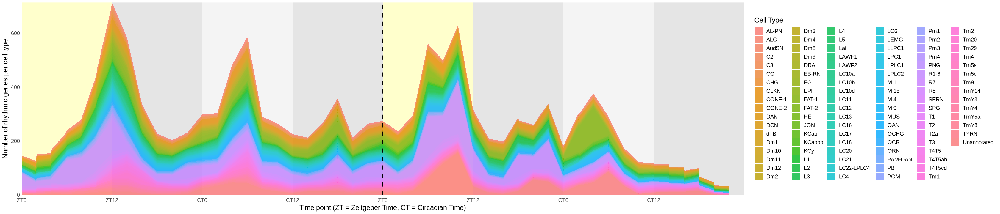

In [148]:
library(dplyr)
library(purrr)
library(ggplot2)

# ----------------------------------------
# Function: Average p-values across 3 replicates
average_replicates <- function(rep1, rep2, rep3, p_col = "ADJ.P", threshold = 0.05) {
  cell_types <- intersect(names(rep1), intersect(names(rep2), names(rep3)))
  result <- list()
  
  for (ct in cell_types) {
    df1 <- rep1[[ct]][, c("Gene", "LAG", p_col)]
    df2 <- rep2[[ct]][, c("Gene", "LAG", p_col)]
    df3 <- rep3[[ct]][, c("Gene", "LAG", p_col)]

    colnames(df1)[3] <- "p1"
    colnames(df2)[3] <- "p2"
    colnames(df3)[3] <- "p3"

    merged <- reduce(list(df1, df2, df3), ~inner_join(.x, .y, by = c("Gene", "LAG")))
    merged$avg_p <- rowMeans(merged[, c("p1", "p2", "p3")], na.rm = TRUE)

    result[[ct]] <- merged %>% filter(avg_p < threshold)
  }

  return(result)
}

# ----------------------------------------
# Function: Count rhythmic genes by phase (LAG)
process_dataset <- function(dataset_list, dataset_label) {
  df_out <- data.frame()
  
  for (ct in names(dataset_list)) {
    subdf_sig <- dataset_list[[ct]] %>%
      filter(avg_p < 0.05) %>%
      group_by(LAG) %>%
      summarize(n = n(), .groups = "drop") %>%
      mutate(cell_type = ct, dataset = dataset_label)
    
    df_out <- bind_rows(df_out, subdf_sig)
  }

  return(df_out)
}

# ----------------------------------------
# Assume WTLD, WTDD, MTLD, MTDD have already been generated using average_replicates()
df_wtld <- process_dataset(WTLD, "WTLD")
df_wtdd <- process_dataset(WTDD, "WTDD")
df_mtld <- process_dataset(MTLD, "MTLD")
df_mtdd <- process_dataset(MTDD, "MTDD")

# Combine all datasets
df_all <- bind_rows(df_wtld, df_wtdd, df_mtld, df_mtdd)

# ----------------------------------------
# Preprocess for plotting
df_all$dataset <- factor(df_all$dataset, levels = c("WTLD", "WTDD", "MTLD", "MTDD"))
df_all$LAG <- as.numeric(as.character(df_all$LAG))

df_all <- df_all %>%
  mutate(
    time = case_when(
      dataset == "WTLD" ~ LAG + 0,
      dataset == "WTDD" ~ LAG + 24,
      dataset == "MTLD" ~ LAG + 48,
      dataset == "MTDD" ~ LAG + 72
    )
  )

# ----------------------------------------
# Plot
ggplot(df_all, aes(x = time, y = n, fill = cell_type)) +
  # Background time boxes
  annotate("rect", xmin = 0, xmax = 12, ymin = 0, ymax = Inf, fill = "yellow", alpha = 0.2) +
  annotate("rect", xmin = 48, xmax = 60, ymin = 0, ymax = Inf, fill = "yellow", alpha = 0.2) +
  annotate("rect", xmin = 24, xmax = 36, ymin = 0, ymax = Inf, fill = "gray80", alpha = 0.2) +
  annotate("rect", xmin = 72, xmax = 84, ymin = 0, ymax = Inf, fill = "gray80", alpha = 0.2) +
  annotate("rect", xmin = 12, xmax = 24, ymin = 0, ymax = Inf, fill = "gray50", alpha = 0.2) +
  annotate("rect", xmin = 36, xmax = 48, ymin = 0, ymax = Inf, fill = "gray50", alpha = 0.2) +
  annotate("rect", xmin = 60, xmax = 72, ymin = 0, ymax = Inf, fill = "gray50", alpha = 0.2) +
  annotate("rect", xmin = 84, xmax = 96, ymin = 0, ymax = Inf, fill = "gray50", alpha = 0.2) +

  # Area plot
  geom_area(position = "stack", alpha = 0.8) +

  # Vertical divider between LD and DD
  geom_vline(xintercept = 48, color = "black", linetype = "dashed", size = 1) +

  # X-axis
  scale_x_continuous(
    breaks = seq(0, 96, 12),
    limits = c(0, 96),
    expand = c(0, 0),
    labels = c("ZT0", "ZT12", "CT0", "CT12", "ZT0", "ZT12", "CT0", "CT12", "")
  ) +

  # Y-axis
  scale_y_continuous(expand = c(0, 0), limits = c(0, NA)) +

  # Labels and theme
  labs(
    x = "Time point (ZT = Zeitgeber Time, CT = Circadian Time)",
    y = "Number of rhythmic genes per cell type",
    fill = "Cell Type"
  ) +
  theme_minimal(base_size = 14) +
  theme(
    panel.grid.major = element_blank(),
    panel.grid.minor = element_blank(),
    axis.text.y = element_text(margin = margin(r = 0)),
    plot.margin = margin(t = 5, r = 5, b = 5, l = 5)
  )


In [150]:
library(dplyr)

# -----------------------------------------
# Helper: Standardize 'Gene' column name
standardize_gene_column <- function(dataset_list) {
  lapply(dataset_list, function(df) {
    if ("df_bulk_expr_subset.Gene" %in% names(df)) {
      names(df)[names(df) == "df_bulk_expr_subset.Gene"] <- "Gene"
    }
    return(df)
  })
}

# -----------------------------------------
# Helper: Find consensus rhythmic genes after p-filtering
intersect_significant_genes <- function(rep1, rep2, rep3, p_col = "ADJ.P", threshold = 0.05) {
  cell_types <- intersect(names(rep1), intersect(names(rep2), names(rep3)))
  result <- list()
  
  for (ct in cell_types) {
    df1 <- rep1[[ct]] %>% filter(.data[[p_col]] < threshold)
    df2 <- rep2[[ct]] %>% filter(.data[[p_col]] < threshold)
    df3 <- rep3[[ct]] %>% filter(.data[[p_col]] < threshold)
    
    genes1 <- df1$Gene
    genes2 <- df2$Gene
    genes3 <- df3$Gene

    common_genes <- Reduce(intersect, list(genes1, genes2, genes3))
    
    result[[ct]] <- df1 %>% filter(Gene %in% common_genes)
  }
  
  return(result)
}

# -----------------------------------------
# Helper: Save results as CSVs (even empty ones)
save_list_to_csv <- function(data_list, prefix, all_celltypes) {
  for (name in all_celltypes) {
    if (name %in% names(data_list)) {
      write.csv(data_list[[name]], paste0(prefix, "_", name, ".csv"), row.names = FALSE)
    } else {
      write.csv(data.frame(), paste0(prefix, "_", name, ".csv"), row.names = FALSE)
    }
  }
}

# -----------------------------------------
# Load and standardize input RDS files

WTLD_1 <- readRDS("cell_type_subdata_list_WT_LD.rds")
WTLD_2 <- readRDS("cell_type_subdata_list_WT_LD_2.rds")
WTLD_3 <- readRDS("cell_type_subdata_list_WT_LD_3.rds")

WTDD_1 <- standardize_gene_column(readRDS("cell_type_subdata_list_WT_DD.rds"))
WTDD_2 <- standardize_gene_column(readRDS("cell_type_subdata_list_WT_DD_2.rds"))
WTDD_3 <- standardize_gene_column(readRDS("cell_type_subdata_list_WT_DD_3.rds"))

MTLD_1 <- standardize_gene_column(readRDS("cell_type_subdata_list_MT_LD.rds"))
MTLD_2 <- standardize_gene_column(readRDS("cell_type_subdata_list_MT_LD_2.rds"))
MTLD_3 <- standardize_gene_column(readRDS("cell_type_subdata_list_MT_LD_3.rds"))

MTDD_1 <- standardize_gene_column(readRDS("cell_type_subdata_list_MT_DD.rds"))
MTDD_2 <- standardize_gene_column(readRDS("cell_type_subdata_list_MT_DD_2.rds"))
MTDD_3 <- standardize_gene_column(readRDS("cell_type_subdata_list_MT_DD_3.rds"))

# -----------------------------------------
# Process datasets

WTLD <- intersect_significant_genes(WTLD_1, WTLD_2, WTLD_3)
WTDD <- intersect_significant_genes(WTDD_1, WTDD_2, WTDD_3)
MTLD <- intersect_significant_genes(MTLD_1, MTLD_2, MTLD_3)
MTDD <- intersect_significant_genes(MTDD_1, MTDD_2, MTDD_3)

# -----------------------------------------
# Save results

all_celltypes <- unique(c(names(WTLD), names(WTDD), names(MTLD), names(MTDD)))

save_list_to_csv(WTLD, "WTLD", all_celltypes)
save_list_to_csv(WTDD, "WTDD", all_celltypes)
save_list_to_csv(MTLD, "MTLD", all_celltypes)
save_list_to_csv(MTDD, "MTDD", all_celltypes)


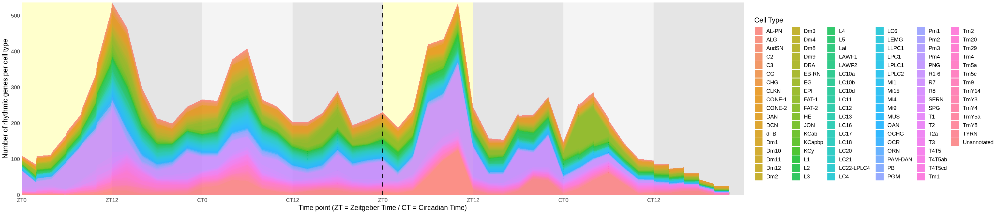

In [151]:
library(dplyr)
library(ggplot2)

# ----------------------------------------
# Aggregates rhythmic gene counts per LAG per dataset
process_dataset_intersected <- function(dataset_list, dataset_label) {
  df_out <- data.frame()
  
  for (ct in names(dataset_list)) {
    subdf <- dataset_list[[ct]]
    
    if (nrow(subdf) == 0) next  # Skip empty data

    count_by_phase <- subdf %>%
      group_by(LAG) %>%
      summarize(n = n(), .groups = "drop") %>%
      mutate(cell_type = ct, dataset = dataset_label)
    
    df_out <- bind_rows(df_out, count_by_phase)
  }

  return(df_out)
}

# ----------------------------------------
# Use this after running intersect_significant_genes()
df_wtld <- process_dataset_intersected(WTLD, "WTLD")
df_wtdd <- process_dataset_intersected(WTDD, "WTDD")
df_mtld <- process_dataset_intersected(MTLD, "MTLD")
df_mtdd <- process_dataset_intersected(MTDD, "MTDD")

# Combine
df_all <- bind_rows(df_wtld, df_wtdd, df_mtld, df_mtdd)

# ----------------------------------------
# Preprocessing for plotting
df_all$dataset <- factor(df_all$dataset, levels = c("WTLD", "WTDD", "MTLD", "MTDD"))
df_all$LAG <- as.numeric(as.character(df_all$LAG))

df_all <- df_all %>%
  mutate(
    time = case_when(
      dataset == "WTLD" ~ LAG + 0,
      dataset == "WTDD" ~ LAG + 24,
      dataset == "MTLD" ~ LAG + 48,
      dataset == "MTDD" ~ LAG + 72
    )
  )

# ----------------------------------------
# Plot
ggplot(df_all, aes(x = time, y = n, fill = cell_type)) +
  # Background LD/DD shading
  annotate("rect", xmin = 0, xmax = 12, ymin = 0, ymax = Inf, fill = "yellow", alpha = 0.2) +
  annotate("rect", xmin = 48, xmax = 60, ymin = 0, ymax = Inf, fill = "yellow", alpha = 0.2) +
  annotate("rect", xmin = 24, xmax = 36, ymin = 0, ymax = Inf, fill = "gray80", alpha = 0.2) +
  annotate("rect", xmin = 72, xmax = 84, ymin = 0, ymax = Inf, fill = "gray80", alpha = 0.2) +
  annotate("rect", xmin = 12, xmax = 24, ymin = 0, ymax = Inf, fill = "gray50", alpha = 0.2) +
  annotate("rect", xmin = 36, xmax = 48, ymin = 0, ymax = Inf, fill = "gray50", alpha = 0.2) +
  annotate("rect", xmin = 60, xmax = 72, ymin = 0, ymax = Inf, fill = "gray50", alpha = 0.2) +
  annotate("rect", xmin = 84, xmax = 96, ymin = 0, ymax = Inf, fill = "gray50", alpha = 0.2) +

  # Area plot
  geom_area(position = "stack", alpha = 0.8) +

  # Vertical line separating WT and MT
  geom_vline(xintercept = 48, color = "black", linetype = "dashed", size = 1) +

  # X-axis labeling
  scale_x_continuous(
    breaks = seq(0, 96, 12),
    limits = c(0, 96),
    expand = c(0, 0),
    labels = c("ZT0", "ZT12", "CT0", "CT12", "ZT0", "ZT12", "CT0", "CT12", "")
  ) +

  # Y-axis
  scale_y_continuous(expand = c(0, 0), limits = c(0, NA)) +

  # Labels and styling
  labs(
    x = "Time point (ZT = Zeitgeber Time / CT = Circadian Time)",
    y = "Number of rhythmic genes per cell type",
    fill = "Cell Type"
  ) +
  theme_minimal(base_size = 14) +
  theme(
    panel.grid.major = element_blank(),
    panel.grid.minor = element_blank(),
    axis.text.y = element_text(margin = margin(r = 0)),
    plot.margin = margin(t = 5, r = 5, b = 5, l = 5)
  )


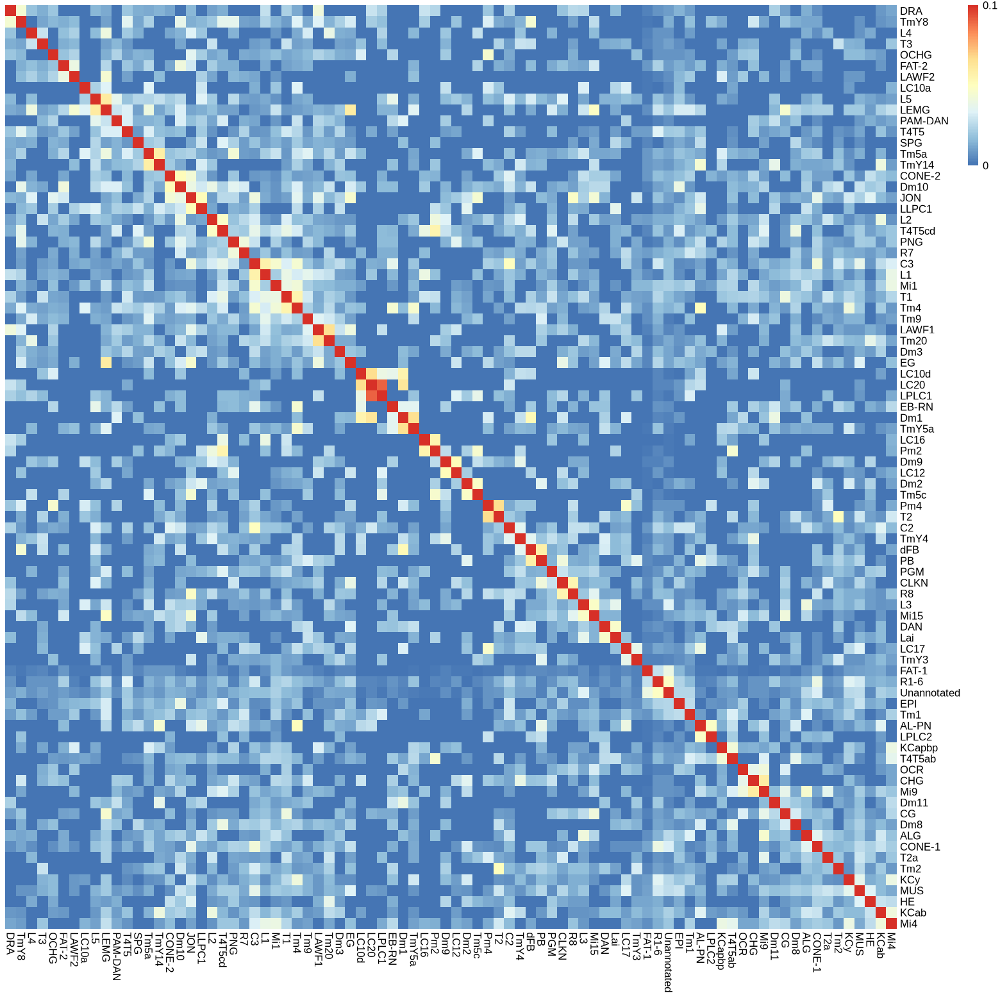

In [17]:
# 1) Get the names of the cell types (e.g., "AL-PN", "ab", etc.)
cell_types <- names(MTDD)

# 2) For each cell type, extract the vector of genes from df_bulk_expr_subset.Gene
MTDD_rhythmic_genes <- lapply(cell_types, function(ct) {
  MTDD[[ct]]$df_bulk_expr_subset.Gene
})

# 3) Give the resulting list the same names as the cell types
names(MTDD_rhythmic_genes) <- cell_types


compute_shared_fraction <- function(rhythmic_list) {
  cts <- names(rhythmic_list)
  n_cts <- length(cts)
  mat <- matrix(0, nrow = n_cts, ncol = n_cts,
                dimnames = list(cts, cts))
  
  for (i in seq_len(n_cts)) {
    for (j in seq_len(n_cts)) {
      genes_i <- rhythmic_list[[i]]
      genes_j <- rhythmic_list[[j]]
      inter   <- length(intersect(genes_i, genes_j))
      unio    <- length(union(genes_i, genes_j))
      mat[i, j] <- inter / unio
    }
  }
  mat
}

# Create the matrix for WTLD
shared_mat_MTDD <- compute_shared_fraction(MTDD_rhythmic_genes)


library(pheatmap)
library(cowplot)    # for plot_grid()

# 1) Define your own breakpoints from 0 to some max (e.g., 0.5):
my_breaks <- seq(0, 0.1, length.out = 101)

# 2) Define a color palette that spans these breaks
#my_colors <- colorRampPalette(c("navy", "white", "darkgreen"))(length(my_breaks) - 1)

# Adjust these values as you like (in inches)
options(repr.plot.width = 13, repr.plot.height = 13)

# Generate the pheatmap and store the result silently
pheatmap(shared_mat_MTDD,
                  cluster_rows = TRUE,
                  cluster_cols = TRUE,
                  #color = my_colors,
                  breaks = my_breaks,
                  legend_breaks = seq(0, 0.5, 0.1),  # optional: nicer legend tick marks
                  treeheight_row = 0,      # hide row dendrogram
                  treeheight_col = 0,      # hide column dendrogram
                  border_color = NA)


Keeping 72 cell-types with ≥20genes each.



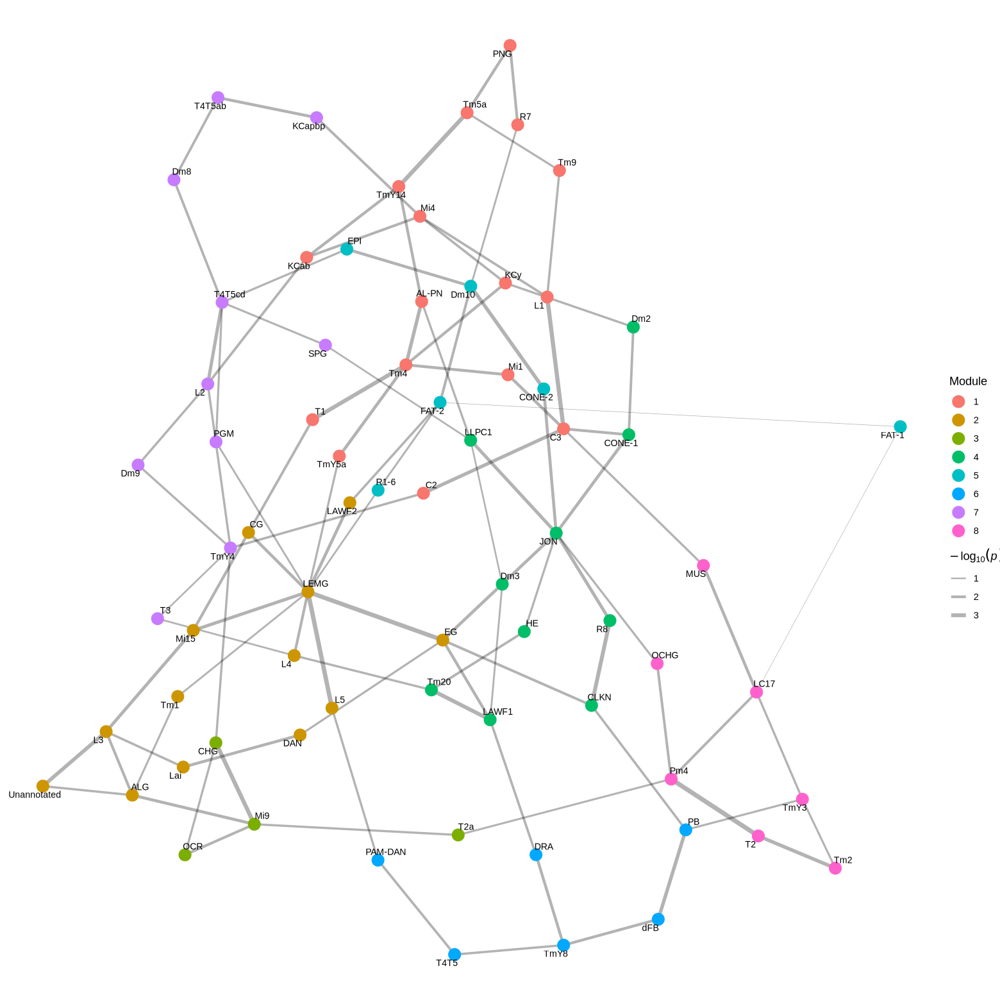

In [30]:
# ————————————————————————————————————————
#  MT DD backbone via intersection- and kNN-filtering
# ————————————————————————————————————————

library(igraph)
library(ggraph)
library(tidyverse)

# 1) Load MT DD
MTDD <- readRDS("cell_type_subdata_list_MT_DD.rds")

# 2) Extract gene lists
genes_list <- lapply(MTDD, function(x) x$df_bulk_expr_subset.Gene)
cell_types <- names(genes_list)

# 3) Filter out tiny gene-sets (<50% of median size)
sizes <- lengths(genes_list)
min_genes <- floor(median(sizes) * 0.5)
keep_ct <- cell_types[sizes >= min_genes]
genes_list <- genes_list[keep_ct]
cell_types  <- keep_ct
message("Keeping ", length(cell_types),
        " cell-types with ≥", min_genes, "genes each.")

# 4) Build intersection counts & hypergeometric p-value matrix
U <- length(unique(unlist(genes_list)))
n <- length(cell_types)
int_mat <- p_mat <- matrix(0, n, n,
                           dimnames = list(cell_types, cell_types))

for(i in seq_len(n)) {
  for(j in seq_len(n)) {
    A <- genes_list[[i]]; B <- genes_list[[j]]
    k <- length(intersect(A, B))   # absolute overlap
    m <- length(A); x <- length(B)
    int_mat[i,j] <- k
    # P(X ≥ k) under hypergeometric:
    p_mat[i,j] <- phyper(k-1, m, U-m, x, lower.tail = FALSE)
  }
}
diag(p_mat) <- 1   # self → p=1

# 5) Convert to –log10(p) weights; zero out self-loops
w_mat <- -log10(p_mat)
diag(w_mat) <- 0

# 6) Absolute-overlap filter: require ≥2 shared genes
min_overlap <- 2
w_mat[int_mat < min_overlap] <- 0

# 7) Build a k-NN adjacency (k = 2)
k <- 2
knn_mat <- matrix(0, n, n, dimnames = list(cell_types, cell_types))
for(i in seq_len(n)) {
  roww <- w_mat[i, ]
  # find the top-k non‐zero neighbors
  topk <- names(sort(roww, decreasing = TRUE))[1:k]
  knn_mat[i, topk] <- roww[topk]
}
# symmetrize: keep edge if either direction wanted it
adj_knn <- pmax(knn_mat, t(knn_mat))

# 8) Build igraph
g <- graph_from_adjacency_matrix(adj_knn,
                                 mode    = "undirected",
                                 weighted= TRUE,
                                 diag    = FALSE)

# 9) Louvain community detection
com <- cluster_louvain(g, weights = E(g)$weight)
V(g)$module <- com$membership

# 10) Plot it
set.seed(42)
ggraph(g, layout = "fr") +
  geom_edge_link(aes(width = weight), alpha = 0.3) +
  geom_node_point(aes(color = factor(module)), size = 5) +
  geom_node_text(aes(label = name), repel = TRUE, size = 3) +
  scale_edge_width(range = c(0.2, 2)) +
  theme_void() +
  labs(color = "Module",
       edge_width = expression(-log[10](italic(p))))


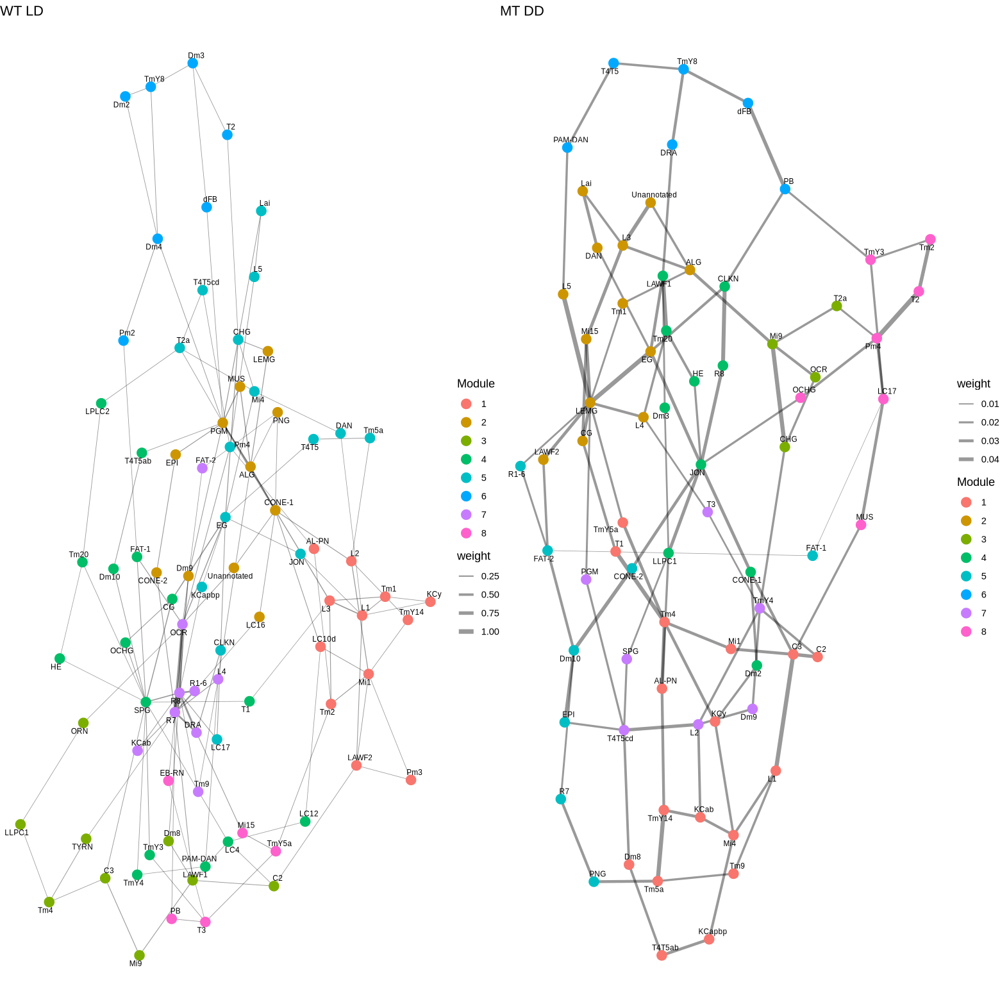

In [31]:
library(igraph)
library(ggraph)
library(tidyverse)
library(cowplot)

# --- 1) a helper to go from list→normalized adjacency  ---
make_adj <- function(rhythmic_list, k = 2, min_genes = NULL, min_overlap = 2) {
  # optional size filter
  if(!is.null(min_genes)) {
    keep <- lengths(rhythmic_list) >= min_genes
    rhythmic_list <- rhythmic_list[keep]
  }
  cts <- names(rhythmic_list)
  U   <- length(unique(unlist(rhythmic_list)))
  n   <- length(cts)

  # build –log10(p) matrix + intersection matrix
  p_mat <- int_mat <- matrix(0, n, n, dimnames = list(cts, cts))
  for(i in seq_len(n)) for(j in seq_len(n)) {
    A <- rhythmic_list[[i]]; B <- rhythmic_list[[j]]
    k_ij <- length(intersect(A, B))
    p_mat[i,j] <-   phyper(k_ij-1, length(A), U-length(A),
                            length(B), lower.tail = FALSE)
    int_mat[i,j] <- k_ij
  }
  diag(p_mat) <- 1
  w_mat <- -log10(p_mat)
  diag(w_mat) <- 0

  # prune tiny overlaps
  w_mat[int_mat < min_overlap] <- 0

  # k-NN sparsify
  knn <- matrix(0, n, n, dimnames = list(cts, cts))
  for(i in seq_len(n)) {
    topk <- names(sort(w_mat[i, ], decreasing = TRUE)[1:k])
    knn[i, topk] <- w_mat[i, topk]
  }
  adj <- pmax(knn, t(knn))
  adj
}

# --- 2) Load both datasets and make raw adjacencies ---
WTLD <- readRDS("cell_type_subdata_list_WT_LD.rds")  %>%
          lapply(., `[[`, "df_bulk_expr_subset.Gene")
MTDD <- readRDS("cell_type_subdata_list_MT_DD.rds")  %>%
          lapply(., `[[`, "df_bulk_expr_subset.Gene")

# optional: filter based on each median
ming_W <- floor(median(lengths(WTLD))*0.5)
ming_M <- floor(median(lengths(MTDD))*0.5)

A_WT <- make_adj(WTLD, k=2, min_genes=ming_W, min_overlap=2)
A_MT <- make_adj(MTDD, k=2, min_genes=ming_M, min_overlap=2)

# --- 3) find global maximum and normalize both ---
W_max <- max(c(A_WT, A_MT))
A_WT_norm <- A_WT / W_max
A_MT_norm <- A_MT / W_max

# --- 4) build igraphs ---
g_WT <- graph_from_adjacency_matrix(A_WT_norm,
                                   mode="undirected", weighted=TRUE)
g_MT <- graph_from_adjacency_matrix(A_MT_norm,
                                   mode="undirected", weighted=TRUE)

# detect communities
V(g_WT)$mod <- cluster_louvain(g_WT, weights=E(g_WT)$weight)$membership
V(g_MT)$mod <- cluster_louvain(g_MT, weights=E(g_MT)$weight)$membership

# --- 5) plot side by side with SAME edge‐width scale ---
plot_WT <- ggraph(g_WT, layout="fr") +
  geom_edge_link(aes(width=weight), alpha=0.4) +
  geom_node_point(aes(color=factor(mod)), size=4) +
  geom_node_text(aes(label=name), repel=TRUE, size=2.5) +
  scale_edge_width(range=c(0.2, 2)) +
  labs(title="WT LD", color="Module") +
  theme_void()

plot_MT <- ggraph(g_MT, layout="fr") +
  geom_edge_link(aes(width=weight), alpha=0.4) +
  geom_node_point(aes(color=factor(mod)), size=4) +
  geom_node_text(aes(label=name), repel=TRUE, size=2.5) +
  scale_edge_width(range=c(0.2, 2)) +
  labs(title="MT DD", color="Module") +
  theme_void()

plot_grid(plot_WT, plot_MT, ncol=2)


In [33]:
V(g_MT)$module <- cluster_louvain(g_MT, weights=E(g_MT)$weight)$membership


In [34]:
geom_node_point(aes(color = factor(mod)), size = 4)


mapping: colour = ~factor(mod), x = ~x, y = ~y 
geom_point: na.rm = FALSE
stat_filter: na.rm = FALSE
position_identity 

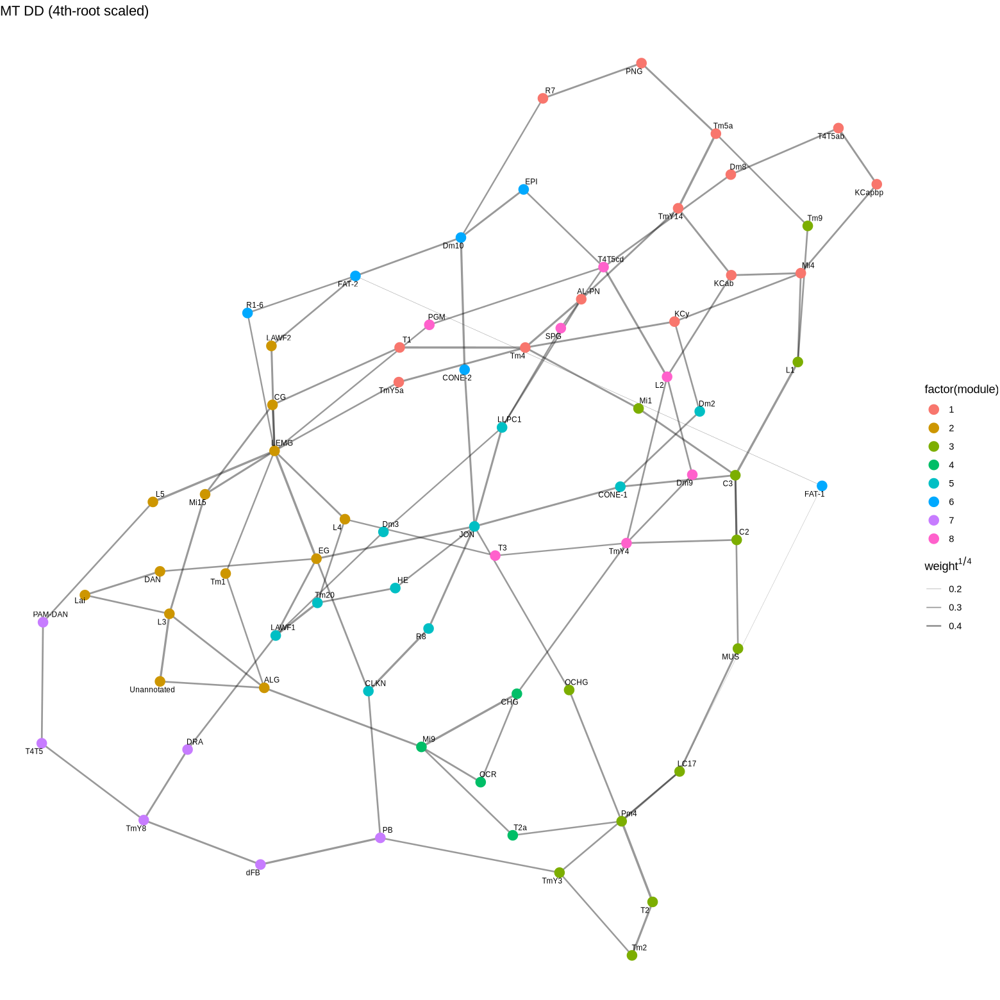

In [36]:
# assume g_MT is your MT DD igraph with E(g_MT)$weight in [0,1] already

# 1) Precompute a plotting‐width attribute
E(g_MT)$plot_w <- E(g_MT)$weight^(1/4)   

# 2) Draw, using a narrower thickness band
set.seed(42)
ggraph(g_MT, layout="fr") +
  geom_edge_link(aes(width = plot_w), alpha = 0.4) +
  geom_node_point(aes(color = factor(module)), size = 4) +
  geom_node_text(aes(label = name), repel = TRUE, size = 2.5) +
  # now our “thickest” edge is sqrt(sqrt(1))*1 = 1, and the plot‐range is smallish
  scale_edge_width(range = c(0.1, 1)) +
  theme_void() +
  labs(title = "MT DD (4th-root scaled)", 
       edge_width = expression(weight^{1/4}))


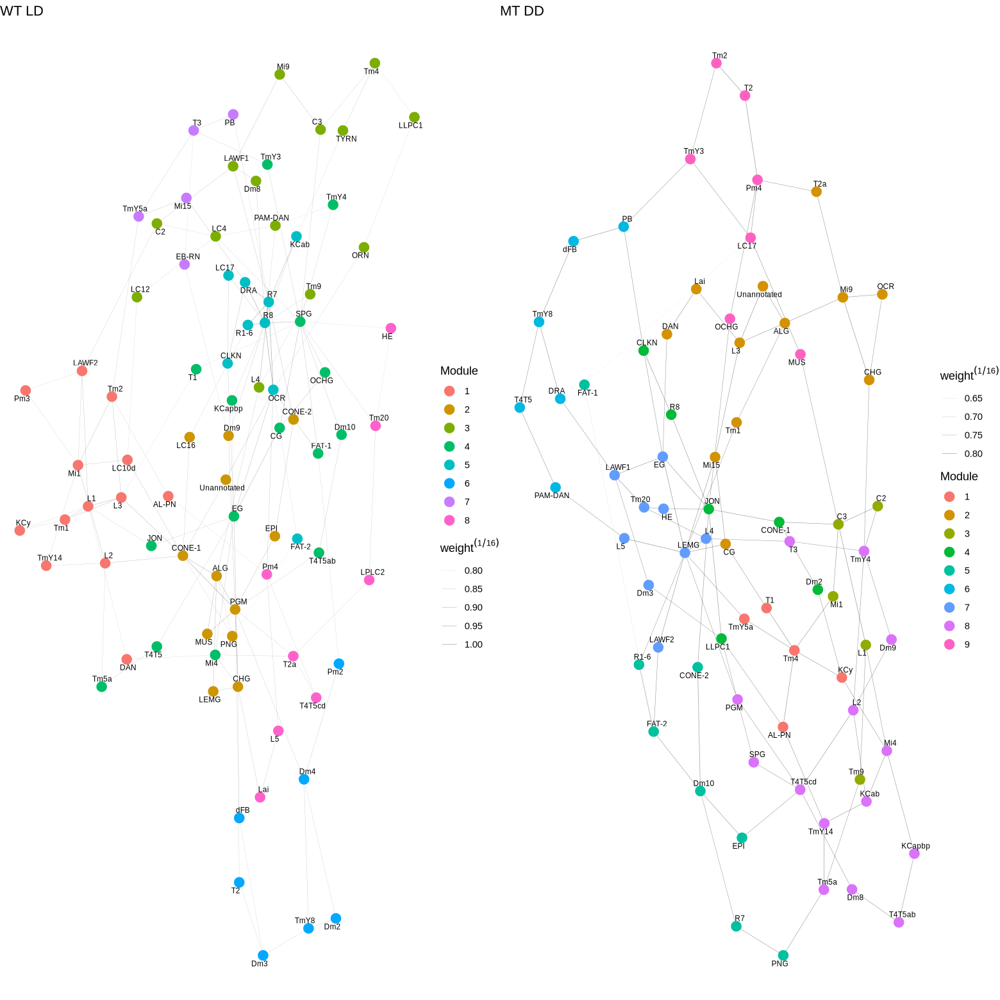

In [41]:
#———————————————————————————————————————
# Compare WT LD vs MT DD with 16ᵗʰ-root scaling
#———————————————————————————————————————

library(igraph)
library(ggraph)
library(tidyverse)
library(cowplot)

# 1) Helper: build pruned adjacency from named gene-lists
make_adj <- function(rhythmic_list,
                     min_genes_frac = 0.5,
                     min_overlap    = 2,
                     k              = 2) {
  sizes    <- lengths(rhythmic_list)
  ming     <- floor(median(sizes) * min_genes_frac)
  keep     <- sizes >= ming
  rhythmic <- rhythmic_list[keep]
  cts      <- names(rhythmic)
  U        <- length(unique(unlist(rhythmic)))
  n        <- length(cts)

  pmat   <- intmat <- matrix(0, n, n, dimnames = list(cts, cts))
  for(i in seq_len(n)) for(j in seq_len(n)) {
    A    <- rhythmic[[i]]; B <- rhythmic[[j]]
    k_ij <- length(intersect(A,B))
    intmat[i,j] <- k_ij
    pmat[i,j]   <- phyper(k_ij - 1,
                          length(A),
                          U - length(A),
                          length(B),
                          lower.tail = FALSE)
  }
  diag(pmat) <- 1

  wmat       <- -log10(pmat)       # transform to –log10(p)
  diag(wmat) <- 0
  wmat[intmat < min_overlap] <- 0  # drop tiny overlaps

  # k-NN sparsify
  knn <- matrix(0, n, n, dimnames = list(cts, cts))
  for(i in seq_len(n)) {
    topk       <- names(sort(wmat[i, ], decreasing = TRUE)[1:k])
    knn[i,topk] <- wmat[i, topk]
  }
  pmax(knn, t(knn))
}

# 2) Load & extract gene vectors
WTLD_raw <- readRDS("cell_type_subdata_list_WT_LD.rds")
MTDD_raw <- readRDS("cell_type_subdata_list_MT_DD.rds")

WTLD_list <- map(WTLD_raw, "df_bulk_expr_subset.Gene")
MTDD_list <- map(MTDD_raw, "df_bulk_expr_subset.Gene")

# 3) Build raw adjacency matrices
A_WT <- make_adj(WTLD_list)
A_MT <- make_adj(MTDD_list)

# 4) Normalize both to [0,1] using the same global max
W_max     <- max(c(A_WT, A_MT))
A_WT_norm <- A_WT / W_max
A_MT_norm <- A_MT / W_max

# 5) Create igraph objects
g_WT <- graph_from_adjacency_matrix(A_WT_norm, mode="undirected", weighted=TRUE)
g_MT <- graph_from_adjacency_matrix(A_MT_norm, mode="undirected", weighted=TRUE)

# 6) Community detection → 'module'
V(g_WT)$module <- cluster_louvain(g_WT, weights=E(g_WT)$weight)$membership
V(g_MT)$module <- cluster_louvain(g_MT, weights=E(g_MT)$weight)$membership

# 7) Compute 16ᵗʰ-root scaled plotting widths
#    This strongly compresses the dynamic range.
E(g_WT)$plot_w <- E(g_WT)$weight^(1/16)
E(g_MT)$plot_w <- E(g_MT)$weight^(1/16)

# 8) Plot side-by-side with a very tight width range
plot_WT <- ggraph(g_WT, layout = "fr") +
  geom_edge_link(aes(width = plot_w), alpha = 0.4) +
  geom_node_point(aes(color = factor(module)), size = 4) +
  geom_node_text(aes(label = name), repel = TRUE, size = 2.5) +
  scale_edge_width(range = c(0.02, 0.2)) +
  labs(title      = "WT LD",
       color      = "Module",
       edge_width = expression(weight^(1/16))) +
  theme_void()

plot_MT <- ggraph(g_MT, layout = "fr") +
  geom_edge_link(aes(width = plot_w), alpha = 0.4) +
  geom_node_point(aes(color = factor(module)), size = 4) +
  geom_node_text(aes(label = name), repel = TRUE, size = 2.5) +
  scale_edge_width(range = c(0.02, 0.2)) +
  labs(title      = "MT DD",
       color      = "Module",
       edge_width = expression(weight^(1/16))) +
  theme_void()

# 9) Combine
plot_grid(plot_WT, plot_MT, ncol = 2)


In [42]:
# after you’ve done A_WT_norm <- … and A_MT_norm <- … in R:
write.csv(A_WT_norm, "adj_WT_norm.csv", quote=FALSE)
write.csv(A_MT_norm, "adj_MT_norm.csv", quote=FALSE)


In [44]:
write.csv(WTLD, "cell_type_subdata_list_WT_LD.csv", quote=FALSE)
write.csv(WTDD, "cell_type_subdata_list_WT_DD.csv", quote=FALSE)
write.csv(MTLD, "cell_type_subdata_list_MT_LD.csv", quote=FALSE)
write.csv(MTDD, "cell_type_subdata_list_MT_DD.csv", quote=FALSE)

ERROR: Error in (function (..., row.names = NULL, check.rows = FALSE, check.names = TRUE, : arguments imply differing number of rows: 119, 288, 47, 160, 166, 220, 207, 148, 712, 315, 112, 59, 106, 55, 92, 53, 58, 117, 128, 101, 139, 104, 127, 115, 459, 637, 213, 186, 140, 165, 198, 252, 296, 316, 185, 138, 149, 46, 54, 86, 57, 70, 31, 69, 81, 33, 89, 158, 90, 56, 76, 287, 175, 394, 179, 219, 66, 93, 103, 344, 72, 75, 174, 2241, 437, 384, 52, 257, 247, 152, 130, 154, 159, 217, 225, 120, 136, 155, 121, 84, 97, 63, 1193


In [51]:
# 1) Read your four RDS lists
WTLD <- readRDS("cell_type_subdata_list_WT_LD.rds")
WTDD <- readRDS("cell_type_subdata_list_WT_DD.rds")
MTLD <- readRDS("cell_type_subdata_list_MT_LD.rds")
MTDD <- readRDS("cell_type_subdata_list_MT_DD.rds")

# 2) Extract the per–cell‐type gene vectors
WTLD_list <- lapply(WTLD, function(x) x$df_bulk_expr_subset.Gene)
WTDD_list <- lapply(WTDD, function(x) x$df_bulk_expr_subset.Gene)
MTLD_list <- lapply(MTLD, function(x) x$df_bulk_expr_subset.Gene)
MTDD_list <- lapply(MTDD, function(x) x$df_bulk_expr_subset.Gene)

# 3) Helper to build an n×n intersection‐count matrix
make_int_mat <- function(gene_list) {
  cts <- names(gene_list)
  n   <- length(cts)
  M   <- matrix(0, n, n, dimnames = list(cts, cts))
  for(i in seq_len(n)) {
    for(j in seq_len(n)) {
      M[i,j] <- length(intersect(gene_list[[i]], gene_list[[j]]))
    }
  }
  M
}

# 4) Compute all four intersection matrices
int_WT_LD <- make_int_mat(WTLD_list)
int_WT_DD <- make_int_mat(WTDD_list)
int_MT_LD <- make_int_mat(MTLD_list)
int_MT_DD <- make_int_mat(MTDD_list)

# 5) Write them out for Python
write.csv(int_WT_LD, "WTLD_int.csv", quote = FALSE)
write.csv(int_WT_DD, "WTDD_int.csv", quote = FALSE)
write.csv(int_MT_LD, "MTLD_int.csv", quote = FALSE)
write.csv(int_MT_DD, "MTDD_int.csv", quote = FALSE)


In [19]:
cds <- wtzt

In [24]:
cds <- wtct

In [31]:
cds <- mtzt

In [38]:
cds <- mtct

In [31]:
cds_cell_type_exprs <- function(cds, cell_type) {
  # aggregate your CDS by cell‐type
  cds_agg <- cds_aggregate_by_type(cds, cell_type)
  
  # pull out raw counts
  gene_expr <- exprs(cds_agg)
  
  # normalize to counts‐per‐million (CPM) rather than counts‐per‐hundred‐thousand
  gene_expr <- t(t(gene_expr) / colSums(gene_expr)) * 1e+06
  
  # log1p transform
  gene_expr <- log(gene_expr + 1)
  
  # restore sample names
  colnames(gene_expr) <- cds_agg$sample
  
  return(gene_expr)
}


# ─── 0) Load libs ───
library(monocle)     # cds_aggregate_by_type(), exprs(), fData()
library(tibble)      # rownames_to_column()
library(MetaCycle)   # meta2d()

# ─── 1) Build pseudo-replicates ───
number_of_replicates <- 2

cds$pseudo_replicate <- ave(
  cds$final_timepoints, 
  cds$final_timepoints, 
  cds$all_celltype,
  FUN = function(x) {
    n <- length(x)
    if (n == 1) {
      paste0(x, "_", sample(1:number_of_replicates, 1))
    } else {
      ids <- rep(1:number_of_replicates, length.out = n)
      ids <- sample(ids)
      paste0(x, "_", ids)
    }
  }
)

# ─── 2) Parse out 0–44 regardless of “ZT” vs “CT” ───
cds$Sum2 <- sapply(cds$pseudo_replicate, function(pr) {
  parts    <- strsplit(pr, "_")[[1]]
  tp_label <- parts[1]
  rep_id   <- as.integer(parts[2])
  base_tp  <- as.numeric(gsub("\\D", "", tp_label))
  new_tp   <- if (rep_id == 1) base_tp else base_tp + 24
  as.character(new_tp)
})

# Annotate for aggregation
cds$celltype_Conditions <- paste0(cds$all_celltype, "_", cds$Sum2)

# ─── 3) Aggregate & CPM-normalize + log1p ───
cds_cell_type_exprs <- function(cds, grouping) {
  cds_agg   <- cds_aggregate_by_type(cds, grouping)
  gene_expr <- exprs(cds_agg)
  gene_expr <- t(t(gene_expr) / colSums(gene_expr)) * 1e6
  gene_expr <- log1p(gene_expr)
  colnames(gene_expr) <- cds_agg$sample
  gene_expr
}

mat_all <- cds_cell_type_exprs(cds, cds$celltype_Conditions)
rownames(mat_all) <- fData(cds)$gene_short_name

# ─── 4) Split by cell type & rename cols to pure numeric times ───
cell_types <- unique(sub("_.*$", "", colnames(mat_all)))
cell_dfs   <- setNames(vector("list", length(cell_types)), cell_types)

for (ct in cell_types) {
  mat_ct    <- mat_all[, grepl(paste0("^", ct, "_"), colnames(mat_all)), drop=FALSE]
  times_str <- sub(".*_(\\d+)$", "\\1", colnames(mat_ct))

  if (any(!grepl("^\\d+$", times_str))) {
    stop("Non-numeric time labels in ", ct, ": ",
         paste(unique(times_str[!grepl("^\\d+$", times_str)]), collapse=", "))
  }

  times_num <- as.numeric(times_str)
  ord       <- order(times_num)
  mat_ct    <- mat_ct[, ord, drop = FALSE]
  colnames(mat_ct) <- times_num[ord]
  cell_dfs[[ct]]  <- mat_ct
}

# ─── 5) Convert each to a data.frame with first column “Gene” ───
meta_input <- lapply(cell_dfs, function(mat) {
  df <- as.data.frame(as.matrix(mat))
  rownames_to_column(df, var = "Gene")
})

# ─── 6) Run MetaCycle::meta2d() with JTK only ───
results <- setNames(vector("list", length(meta_input)), names(meta_input))

for (ct in names(meta_input)) {
  df   <- meta_input[[ct]]
  tpts <- as.numeric(colnames(df)[-1])

  results[[ct]] <- tryCatch({
    meta2d(
      infile     = "inmemory",
      inDF       = df,
      outdir     = paste0("MetaCycle_", ct),
      filestyle  = "txt",
      timepoints = tpts,
      cycMethod  = c("JTK", "ARS", "LS"),
      outputFile = FALSE,
      minper     = 24,
      maxper     = 24
    )
  }, error = function(e) {
    message("Skipping ", ct, ": ", e$message)
    NULL
  })
}

# 'results' now contains only JTK output, skipping problematic cell types.

The following `from` values were not present in `x`: gene_name



The ARS is in process from  01:39:21 AM 07-15-2025 


Warning message in arima0(x, order = c(order, 0L, 0L), include.mean = demean):
“possible convergence problem: optim gave code = 1”
Warning message in arima0(x, order = c(order, 0L, 0L), include.mean = demean):
“possible convergence problem: optim gave code = 1”
Warning message in arima0(x, order = c(order, 0L, 0L), include.mean = demean):
“possible convergence problem: optim gave code = 1”
Warning message in arima0(x, order = c(order, 0L, 0L), include.mean = demean):
“possible convergence problem: optim gave code = 1”
Warning message in arima0(x, order = c(order, 0L, 0L), include.mean = demean):
“possible convergence problem: optim gave code = 1”
Warning message in arima0(x, order = c(order, 0L, 0L), include.mean = demean):
“possible convergence problem: optim gave code = 1”
Warning message in arima0(x, order = c(order, 0L, 0L), include.mean = demean):
“possible convergence problem: optim gave code = 1”
Warning message in arima0(x, order = c(order, 0L, 0L), include.mean = demean):
“pos

The analysis by ARS is finished at  01:41:49 AM 07-15-2025 
The JTK is in process from  01:41:49 AM 07-15-2025 
The analysis by JTK is finished at  01:41:59 AM 07-15-2025 
DONE! The analysis about ' inmemory '  has been finished.
                            user.self           sys.self            elapsed 
      "Time used:" "164.917000000001"            "1.041" "166.118999999999" 
        user.child          sys.child 
               "0"                "0" 


The ARS is in process from  01:42:07 AM 07-15-2025 


Warning message in arima0(x, order = c(order, 0L, 0L), include.mean = demean):
“possible convergence problem: optim gave code = 1”
Warning message in arima0(x, order = c(order, 0L, 0L), include.mean = demean):
“possible convergence problem: optim gave code = 1”
Warning message in arima0(x, order = c(order, 0L, 0L), include.mean = demean):
“possible convergence problem: optim gave code = 1”
Warning message in arima0(x, order = c(order, 0L, 0L), include.mean = demean):
“possible convergence problem: optim gave code = 1”
Warning message in arima0(x, order = c(order, 0L, 0L), include.mean = demean):
“possible convergence problem: optim gave code = 1”
Warning message in arima0(x, order = c(order, 0L, 0L), include.mean = demean):
“possible convergence problem: optim gave code = 1”
Warning message in arima0(x, order = c(order, 0L, 0L), include.mean = demean):
“possible convergence problem: optim gave code = 1”
Warning message in arima0(x, order = c(order, 0L, 0L), include.mean = demean):
“pos

The analysis by ARS is finished at  01:44:51 AM 07-15-2025 
The JTK is in process from  01:44:51 AM 07-15-2025 
The analysis by JTK is finished at  01:45:00 AM 07-15-2025 
DONE! The analysis about ' inmemory '  has been finished.
                            user.self           sys.self            elapsed 
      "Time used:"          "181.038"            "1.005" "182.036999999997" 
        user.child          sys.child 
               "0"                "0" 


The ARS is in process from  01:45:09 AM 07-15-2025 


Warning message in arima0(x, order = c(order, 0L, 0L), include.mean = demean):
“possible convergence problem: optim gave code = 1”
Warning message in arima0(x, order = c(order, 0L, 0L), include.mean = demean):
“possible convergence problem: optim gave code = 1”
Warning message in arima0(x, order = c(order, 0L, 0L), include.mean = demean):
“possible convergence problem: optim gave code = 1”


The analysis by ARS is finished at  01:46:38 AM 07-15-2025 
The JTK is in process from  01:46:38 AM 07-15-2025 
The analysis by JTK is finished at  01:46:48 AM 07-15-2025 
DONE! The analysis about ' inmemory '  has been finished.
                              user.self            sys.self             elapsed 
       "Time used:"  "104.555999999997" "0.502999999999986"  "105.050999999999" 
         user.child           sys.child 
                "0"                 "0" 


The ARS is in process from  01:46:55 AM 07-15-2025 


Warning message in arima0(x, order = c(order, 0L, 0L), include.mean = demean):
“possible convergence problem: optim gave code = 1”
Warning message in arima0(x, order = c(order, 0L, 0L), include.mean = demean):
“possible convergence problem: optim gave code = 1”
Warning message in arima0(x, order = c(order, 0L, 0L), include.mean = demean):
“possible convergence problem: optim gave code = 1”
Warning message in arima0(x, order = c(order, 0L, 0L), include.mean = demean):
“possible convergence problem: optim gave code = 1”
Warning message in arima0(x, order = c(order, 0L, 0L), include.mean = demean):
“possible convergence problem: optim gave code = 1”
Warning message in arima0(x, order = c(order, 0L, 0L), include.mean = demean):
“possible convergence problem: optim gave code = 1”
Warning message in arima0(x, order = c(order, 0L, 0L), include.mean = demean):
“possible convergence problem: optim gave code = 1”
Warning message in arima0(x, order = c(order, 0L, 0L), include.mean = demean):
“pos

The analysis by ARS is finished at  01:49:36 AM 07-15-2025 
The JTK is in process from  01:49:36 AM 07-15-2025 
The analysis by JTK is finished at  01:49:45 AM 07-15-2025 
DONE! The analysis about ' inmemory '  has been finished.
                            user.self           sys.self            elapsed 
      "Time used:" "179.012000000002" "1.00200000000001" "180.010999999999" 
        user.child          sys.child 
               "0"                "0" 


The ARS is in process from  01:49:55 AM 07-15-2025 


Warning message in arima0(x, order = c(order, 0L, 0L), include.mean = demean):
“possible convergence problem: optim gave code = 1”
Warning message in arima0(x, order = c(order, 0L, 0L), include.mean = demean):
“possible convergence problem: optim gave code = 1”
Warning message in arima0(x, order = c(order, 0L, 0L), include.mean = demean):
“possible convergence problem: optim gave code = 1”
Warning message in arima0(x, order = c(order, 0L, 0L), include.mean = demean):
“possible convergence problem: optim gave code = 1”
Warning message in arima0(x, order = c(order, 0L, 0L), include.mean = demean):
“possible convergence problem: optim gave code = 1”
Warning message in arima0(x, order = c(order, 0L, 0L), include.mean = demean):
“possible convergence problem: optim gave code = 1”
Warning message in arima0(x, order = c(order, 0L, 0L), include.mean = demean):
“possible convergence problem: optim gave code = 1”
Warning message in arima0(x, order = c(order, 0L, 0L), include.mean = demean):
“pos

The analysis by ARS is finished at  01:52:26 AM 07-15-2025 
The JTK is in process from  01:52:26 AM 07-15-2025 
The analysis by JTK is finished at  01:52:35 AM 07-15-2025 
DONE! The analysis about ' inmemory '  has been finished.
                            user.self           sys.self            elapsed 
      "Time used:" "168.487999999998" "1.38299999999998" "169.858999999997" 
        user.child          sys.child 
               "0"                "0" 


The ARS is in process from  01:52:45 AM 07-15-2025 


Warning message in arima0(x, order = c(order, 0L, 0L), include.mean = demean):
“possible convergence problem: optim gave code = 1”
Warning message in arima0(x, order = c(order, 0L, 0L), include.mean = demean):
“possible convergence problem: optim gave code = 1”
Warning message in arima0(x, order = c(order, 0L, 0L), include.mean = demean):
“possible convergence problem: optim gave code = 1”
Warning message in arima0(x, order = c(order, 0L, 0L), include.mean = demean):
“possible convergence problem: optim gave code = 1”
Warning message in arima0(x, order = c(order, 0L, 0L), include.mean = demean):
“possible convergence problem: optim gave code = 1”
Warning message in arima0(x, order = c(order, 0L, 0L), include.mean = demean):
“possible convergence problem: optim gave code = 1”
Warning message in arima0(x, order = c(order, 0L, 0L), include.mean = demean):
“possible convergence problem: optim gave code = 1”
Warning message in arima0(x, order = c(order, 0L, 0L), include.mean = demean):
“pos

The analysis by ARS is finished at  01:55:29 AM 07-15-2025 
The JTK is in process from  01:55:29 AM 07-15-2025 
The analysis by JTK is finished at  01:55:38 AM 07-15-2025 
DONE! The analysis about ' inmemory '  has been finished.
                            user.self           sys.self            elapsed 
      "Time used:" "181.368000000002"            "2.137" "183.489999999998" 
        user.child          sys.child 
               "0"                "0" 


The ARS is in process from  01:55:48 AM 07-15-2025 


Warning message in arima0(x, order = c(order, 0L, 0L), include.mean = demean):
“possible convergence problem: optim gave code = 1”
Warning message in arima0(x, order = c(order, 0L, 0L), include.mean = demean):
“possible convergence problem: optim gave code = 1”
Warning message in arima0(x, order = c(order, 0L, 0L), include.mean = demean):
“possible convergence problem: optim gave code = 1”
Warning message in arima0(x, order = c(order, 0L, 0L), include.mean = demean):
“possible convergence problem: optim gave code = 1”
Warning message in arima0(x, order = c(order, 0L, 0L), include.mean = demean):
“possible convergence problem: optim gave code = 1”
Warning message in arima0(x, order = c(order, 0L, 0L), include.mean = demean):
“possible convergence problem: optim gave code = 1”
Warning message in arima0(x, order = c(order, 0L, 0L), include.mean = demean):
“possible convergence problem: optim gave code = 1”
Warning message in arima0(x, order = c(order, 0L, 0L), include.mean = demean):
“pos

The analysis by ARS is finished at  01:57:43 AM 07-15-2025 
The JTK is in process from  01:57:43 AM 07-15-2025 
The analysis by JTK is finished at  01:57:53 AM 07-15-2025 
DONE! The analysis about ' inmemory '  has been finished.
                              user.self            sys.self             elapsed 
       "Time used:"  "131.601999999999" "0.680999999999983"  "132.271999999997" 
         user.child           sys.child 
                "0"                 "0" 


The ARS is in process from  01:58:00 AM 07-15-2025 


Warning message in arima0(x, order = c(order, 0L, 0L), include.mean = demean):
“possible convergence problem: optim gave code = 1”
Warning message in arima0(x, order = c(order, 0L, 0L), include.mean = demean):
“possible convergence problem: optim gave code = 1”
Warning message in arima0(x, order = c(order, 0L, 0L), include.mean = demean):
“possible convergence problem: optim gave code = 1”
Warning message in arima0(x, order = c(order, 0L, 0L), include.mean = demean):
“possible convergence problem: optim gave code = 1”
Warning message in arima0(x, order = c(order, 0L, 0L), include.mean = demean):
“possible convergence problem: optim gave code = 1”
Warning message in arima0(x, order = c(order, 0L, 0L), include.mean = demean):
“possible convergence problem: optim gave code = 1”
Warning message in arima0(x, order = c(order, 0L, 0L), include.mean = demean):
“possible convergence problem: optim gave code = 1”
Warning message in arima0(x, order = c(order, 0L, 0L), include.mean = demean):
“pos

The analysis by ARS is finished at  02:00:14 AM 07-15-2025 
The JTK is in process from  02:00:14 AM 07-15-2025 
The analysis by JTK is finished at  02:00:24 AM 07-15-2025 
DONE! The analysis about ' inmemory '  has been finished.
                            user.self           sys.self            elapsed 
      "Time used:"          "146.909" "1.56399999999996" "151.422999999995" 
        user.child          sys.child 
               "0"                "0" 


The ARS is in process from  02:00:32 AM 07-15-2025 


Warning message in arima0(x, order = c(order, 0L, 0L), include.mean = demean):
“possible convergence problem: optim gave code = 1”
Warning message in arima0(x, order = c(order, 0L, 0L), include.mean = demean):
“possible convergence problem: optim gave code = 1”
Warning message in arima0(x, order = c(order, 0L, 0L), include.mean = demean):
“possible convergence problem: optim gave code = 1”
Warning message in arima0(x, order = c(order, 0L, 0L), include.mean = demean):
“possible convergence problem: optim gave code = 1”
Warning message in arima0(x, order = c(order, 0L, 0L), include.mean = demean):
“possible convergence problem: optim gave code = 1”
Warning message in arima0(x, order = c(order, 0L, 0L), include.mean = demean):
“possible convergence problem: optim gave code = 1”
Warning message in arima0(x, order = c(order, 0L, 0L), include.mean = demean):
“possible convergence problem: optim gave code = 1”
Warning message in arima0(x, order = c(order, 0L, 0L), include.mean = demean):
“pos

The analysis by ARS is finished at  02:03:44 AM 07-15-2025 
The JTK is in process from  02:03:44 AM 07-15-2025 
The analysis by JTK is finished at  02:03:53 AM 07-15-2025 
DONE! The analysis about ' inmemory '  has been finished.
                              user.self            sys.self             elapsed 
       "Time used:"  "210.365000000005" "0.899999999999977"  "211.249000000003" 
         user.child           sys.child 
                "0"                 "0" 


The ARS is in process from  02:04:03 AM 07-15-2025 


Warning message in arima0(x, order = c(order, 0L, 0L), include.mean = demean):
“possible convergence problem: optim gave code = 1”
Warning message in arima0(x, order = c(order, 0L, 0L), include.mean = demean):
“possible convergence problem: optim gave code = 1”
Warning message in arima0(x, order = c(order, 0L, 0L), include.mean = demean):
“possible convergence problem: optim gave code = 1”
Warning message in arima0(x, order = c(order, 0L, 0L), include.mean = demean):
“possible convergence problem: optim gave code = 1”
Warning message in arima0(x, order = c(order, 0L, 0L), include.mean = demean):
“possible convergence problem: optim gave code = 1”
Warning message in arima0(x, order = c(order, 0L, 0L), include.mean = demean):
“possible convergence problem: optim gave code = 1”
Warning message in arima0(x, order = c(order, 0L, 0L), include.mean = demean):
“possible convergence problem: optim gave code = 1”
Warning message in arima0(x, order = c(order, 0L, 0L), include.mean = demean):
“pos

The analysis by ARS is finished at  02:07:16 AM 07-15-2025 
The JTK is in process from  02:07:16 AM 07-15-2025 
The analysis by JTK is finished at  02:07:25 AM 07-15-2025 
DONE! The analysis about ' inmemory '  has been finished.
                              user.self            sys.self             elapsed 
       "Time used:"           "211.373" "0.987000000000023"  "212.345000000001" 
         user.child           sys.child 
                "0"                 "0" 


The ARS is in process from  02:07:36 AM 07-15-2025 


Warning message in arima0(x, order = c(order, 0L, 0L), include.mean = demean):
“possible convergence problem: optim gave code = 1”
Warning message in arima0(x, order = c(order, 0L, 0L), include.mean = demean):
“possible convergence problem: optim gave code = 1”
Warning message in arima0(x, order = c(order, 0L, 0L), include.mean = demean):
“possible convergence problem: optim gave code = 1”
Warning message in arima0(x, order = c(order, 0L, 0L), include.mean = demean):
“possible convergence problem: optim gave code = 1”
Warning message in arima0(x, order = c(order, 0L, 0L), include.mean = demean):
“possible convergence problem: optim gave code = 1”
Warning message in arima0(x, order = c(order, 0L, 0L), include.mean = demean):
“possible convergence problem: optim gave code = 1”
Warning message in arima0(x, order = c(order, 0L, 0L), include.mean = demean):
“possible convergence problem: optim gave code = 1”
Warning message in arima0(x, order = c(order, 0L, 0L), include.mean = demean):
“pos

The analysis by ARS is finished at  02:10:05 AM 07-15-2025 
The JTK is in process from  02:10:05 AM 07-15-2025 
The analysis by JTK is finished at  02:10:15 AM 07-15-2025 
DONE! The analysis about ' inmemory '  has been finished.
                            user.self           sys.self            elapsed 
      "Time used:" "167.109000000004" "1.09000000000003" "168.186999999998" 
        user.child          sys.child 
               "0"                "0" 


The ARS is in process from  02:10:24 AM 07-15-2025 


Warning message in arima0(x, order = c(order, 0L, 0L), include.mean = demean):
“possible convergence problem: optim gave code = 1”
Warning message in arima0(x, order = c(order, 0L, 0L), include.mean = demean):
“possible convergence problem: optim gave code = 1”
Warning message in arima0(x, order = c(order, 0L, 0L), include.mean = demean):
“possible convergence problem: optim gave code = 1”
Warning message in arima0(x, order = c(order, 0L, 0L), include.mean = demean):
“possible convergence problem: optim gave code = 1”
Warning message in arima0(x, order = c(order, 0L, 0L), include.mean = demean):
“possible convergence problem: optim gave code = 1”
Warning message in arima0(x, order = c(order, 0L, 0L), include.mean = demean):
“possible convergence problem: optim gave code = 1”
Warning message in arima0(x, order = c(order, 0L, 0L), include.mean = demean):
“possible convergence problem: optim gave code = 1”
Warning message in arima0(x, order = c(order, 0L, 0L), include.mean = demean):
“pos

The analysis by ARS is finished at  02:11:53 AM 07-15-2025 
The JTK is in process from  02:11:53 AM 07-15-2025 
The analysis by JTK is finished at  02:12:03 AM 07-15-2025 
DONE! The analysis about ' inmemory '  has been finished.
                              user.self            sys.self             elapsed 
       "Time used:"  "105.012000000002" "0.649999999999977"  "105.654999999999" 
         user.child           sys.child 
                "0"                 "0" 


The ARS is in process from  02:12:09 AM 07-15-2025 


Warning message in arima0(x, order = c(order, 0L, 0L), include.mean = demean):
“possible convergence problem: optim gave code = 1”
Warning message in arima0(x, order = c(order, 0L, 0L), include.mean = demean):
“possible convergence problem: optim gave code = 1”
Warning message in arima0(x, order = c(order, 0L, 0L), include.mean = demean):
“possible convergence problem: optim gave code = 1”
Warning message in arima0(x, order = c(order, 0L, 0L), include.mean = demean):
“possible convergence problem: optim gave code = 1”
Warning message in arima0(x, order = c(order, 0L, 0L), include.mean = demean):
“possible convergence problem: optim gave code = 1”
Warning message in arima0(x, order = c(order, 0L, 0L), include.mean = demean):
“possible convergence problem: optim gave code = 1”
Warning message in arima0(x, order = c(order, 0L, 0L), include.mean = demean):
“possible convergence problem: optim gave code = 1”
Warning message in arima0(x, order = c(order, 0L, 0L), include.mean = demean):
“pos

The analysis by ARS is finished at  02:14:17 AM 07-15-2025 
The JTK is in process from  02:14:17 AM 07-15-2025 
The analysis by JTK is finished at  02:14:27 AM 07-15-2025 
DONE! The analysis about ' inmemory '  has been finished.
                            user.self           sys.self            elapsed 
      "Time used:" "144.478000000003" "1.62099999999998" "146.091999999997" 
        user.child          sys.child 
               "0"                "0" 


The ARS is in process from  02:14:36 AM 07-15-2025 


Warning message in arima0(x, order = c(order, 0L, 0L), include.mean = demean):
“possible convergence problem: optim gave code = 1”
Warning message in arima0(x, order = c(order, 0L, 0L), include.mean = demean):
“possible convergence problem: optim gave code = 1”
Warning message in arima0(x, order = c(order, 0L, 0L), include.mean = demean):
“possible convergence problem: optim gave code = 1”
Warning message in arima0(x, order = c(order, 0L, 0L), include.mean = demean):
“possible convergence problem: optim gave code = 1”
Warning message in arima0(x, order = c(order, 0L, 0L), include.mean = demean):
“possible convergence problem: optim gave code = 1”
Warning message in arima0(x, order = c(order, 0L, 0L), include.mean = demean):
“possible convergence problem: optim gave code = 1”
Warning message in arima0(x, order = c(order, 0L, 0L), include.mean = demean):
“possible convergence problem: optim gave code = 1”
Warning message in arima0(x, order = c(order, 0L, 0L), include.mean = demean):
“pos

The analysis by ARS is finished at  02:16:10 AM 07-15-2025 
The JTK is in process from  02:16:10 AM 07-15-2025 
The analysis by JTK is finished at  02:16:20 AM 07-15-2025 
DONE! The analysis about ' inmemory '  has been finished.
                            user.self           sys.self            elapsed 
      "Time used:" "109.726000000002" "1.98499999999996" "111.705000000002" 
        user.child          sys.child 
               "0"                "0" 


The ARS is in process from  02:16:27 AM 07-15-2025 


Warning message in arima0(x, order = c(order, 0L, 0L), include.mean = demean):
“possible convergence problem: optim gave code = 1”
Warning message in arima0(x, order = c(order, 0L, 0L), include.mean = demean):
“possible convergence problem: optim gave code = 1”
Warning message in arima0(x, order = c(order, 0L, 0L), include.mean = demean):
“possible convergence problem: optim gave code = 1”
Warning message in arima0(x, order = c(order, 0L, 0L), include.mean = demean):
“possible convergence problem: optim gave code = 1”
Warning message in arima0(x, order = c(order, 0L, 0L), include.mean = demean):
“possible convergence problem: optim gave code = 1”
Warning message in arima0(x, order = c(order, 0L, 0L), include.mean = demean):
“possible convergence problem: optim gave code = 1”
Warning message in arima0(x, order = c(order, 0L, 0L), include.mean = demean):
“possible convergence problem: optim gave code = 1”
Warning message in arima0(x, order = c(order, 0L, 0L), include.mean = demean):
“pos

The analysis by ARS is finished at  02:18:29 AM 07-15-2025 
The JTK is in process from  02:18:29 AM 07-15-2025 
The analysis by JTK is finished at  02:18:38 AM 07-15-2025 
DONE! The analysis about ' inmemory '  has been finished.
                              user.self            sys.self             elapsed 
       "Time used:"  "138.021999999997" "0.973000000000013"  "138.985000000001" 
         user.child           sys.child 
                "0"                 "0" 


The ARS is in process from  02:18:46 AM 07-15-2025 


Warning message in arima0(x, order = c(order, 0L, 0L), include.mean = demean):
“possible convergence problem: optim gave code = 1”
Warning message in arima0(x, order = c(order, 0L, 0L), include.mean = demean):
“possible convergence problem: optim gave code = 1”
Warning message in arima0(x, order = c(order, 0L, 0L), include.mean = demean):
“possible convergence problem: optim gave code = 1”
Warning message in arima0(x, order = c(order, 0L, 0L), include.mean = demean):
“possible convergence problem: optim gave code = 1”
Warning message in arima0(x, order = c(order, 0L, 0L), include.mean = demean):
“possible convergence problem: optim gave code = 1”
Warning message in arima0(x, order = c(order, 0L, 0L), include.mean = demean):
“possible convergence problem: optim gave code = 1”
Warning message in arima0(x, order = c(order, 0L, 0L), include.mean = demean):
“possible convergence problem: optim gave code = 1”
Warning message in arima0(x, order = c(order, 0L, 0L), include.mean = demean):
“pos

The analysis by ARS is finished at  02:19:58 AM 07-15-2025 
The JTK is in process from  02:19:58 AM 07-15-2025 
The analysis by JTK is finished at  02:20:08 AM 07-15-2025 
DONE! The analysis about ' inmemory '  has been finished.
                              user.self            sys.self             elapsed 
       "Time used:"  "86.6809999999969" "0.798000000000002"  "87.4720000000016" 
         user.child           sys.child 
                "0"                 "0" 


The ARS is in process from  02:20:14 AM 07-15-2025 


Warning message in arima0(x, order = c(order, 0L, 0L), include.mean = demean):
“possible convergence problem: optim gave code = 1”
Warning message in arima0(x, order = c(order, 0L, 0L), include.mean = demean):
“possible convergence problem: optim gave code = 1”
Warning message in arima0(x, order = c(order, 0L, 0L), include.mean = demean):
“possible convergence problem: optim gave code = 1”
Warning message in arima0(x, order = c(order, 0L, 0L), include.mean = demean):
“possible convergence problem: optim gave code = 1”
Warning message in arima0(x, order = c(order, 0L, 0L), include.mean = demean):
“possible convergence problem: optim gave code = 1”
Warning message in arima0(x, order = c(order, 0L, 0L), include.mean = demean):
“possible convergence problem: optim gave code = 1”
Warning message in arima0(x, order = c(order, 0L, 0L), include.mean = demean):
“possible convergence problem: optim gave code = 1”
Warning message in arima0(x, order = c(order, 0L, 0L), include.mean = demean):
“pos

The analysis by ARS is finished at  02:21:58 AM 07-15-2025 
The JTK is in process from  02:21:58 AM 07-15-2025 
The analysis by JTK is finished at  02:22:08 AM 07-15-2025 
DONE! The analysis about ' inmemory '  has been finished.
                              user.self            sys.self             elapsed 
       "Time used:"            "120.82" "0.992000000000019"           "121.803" 
         user.child           sys.child 
                "0"                 "0" 


The ARS is in process from  02:22:16 AM 07-15-2025 


Warning message in arima0(x, order = c(order, 0L, 0L), include.mean = demean):
“possible convergence problem: optim gave code = 1”
Warning message in arima0(x, order = c(order, 0L, 0L), include.mean = demean):
“possible convergence problem: optim gave code = 1”
Warning message in arima0(x, order = c(order, 0L, 0L), include.mean = demean):
“possible convergence problem: optim gave code = 1”
Warning message in arima0(x, order = c(order, 0L, 0L), include.mean = demean):
“possible convergence problem: optim gave code = 1”
Warning message in arima0(x, order = c(order, 0L, 0L), include.mean = demean):
“possible convergence problem: optim gave code = 1”
Warning message in arima0(x, order = c(order, 0L, 0L), include.mean = demean):
“possible convergence problem: optim gave code = 1”
Warning message in arima0(x, order = c(order, 0L, 0L), include.mean = demean):
“possible convergence problem: optim gave code = 1”
Warning message in arima0(x, order = c(order, 0L, 0L), include.mean = demean):
“pos

The analysis by ARS is finished at  02:24:05 AM 07-15-2025 
The JTK is in process from  02:24:05 AM 07-15-2025 
The analysis by JTK is finished at  02:24:15 AM 07-15-2025 
DONE! The analysis about ' inmemory '  has been finished.
                              user.self            sys.self             elapsed 
       "Time used:"           "125.913" "0.620000000000005"  "126.523000000001" 
         user.child           sys.child 
                "0"                 "0" 


The ARS is in process from  02:24:22 AM 07-15-2025 


Warning message in arima0(x, order = c(order, 0L, 0L), include.mean = demean):
“possible convergence problem: optim gave code = 1”
Warning message in arima0(x, order = c(order, 0L, 0L), include.mean = demean):
“possible convergence problem: optim gave code = 1”
Warning message in arima0(x, order = c(order, 0L, 0L), include.mean = demean):
“possible convergence problem: optim gave code = 1”
Warning message in arima0(x, order = c(order, 0L, 0L), include.mean = demean):
“possible convergence problem: optim gave code = 1”
Warning message in arima0(x, order = c(order, 0L, 0L), include.mean = demean):
“possible convergence problem: optim gave code = 1”
Warning message in arima0(x, order = c(order, 0L, 0L), include.mean = demean):
“possible convergence problem: optim gave code = 1”
Warning message in arima0(x, order = c(order, 0L, 0L), include.mean = demean):
“possible convergence problem: optim gave code = 1”
Warning message in arima0(x, order = c(order, 0L, 0L), include.mean = demean):
“pos

The analysis by ARS is finished at  02:26:41 AM 07-15-2025 
The JTK is in process from  02:26:41 AM 07-15-2025 
The analysis by JTK is finished at  02:26:51 AM 07-15-2025 
DONE! The analysis about ' inmemory '  has been finished.
                            user.self           sys.self            elapsed 
      "Time used:" "156.514999999999"            "1.197" "157.701999999997" 
        user.child          sys.child 
               "0"                "0" 


The ARS is in process from  02:27:00 AM 07-15-2025 


Warning message in arima0(x, order = c(order, 0L, 0L), include.mean = demean):
“possible convergence problem: optim gave code = 1”
Warning message in arima0(x, order = c(order, 0L, 0L), include.mean = demean):
“possible convergence problem: optim gave code = 1”
Warning message in arima0(x, order = c(order, 0L, 0L), include.mean = demean):
“possible convergence problem: optim gave code = 1”
Warning message in arima0(x, order = c(order, 0L, 0L), include.mean = demean):
“possible convergence problem: optim gave code = 1”
Warning message in arima0(x, order = c(order, 0L, 0L), include.mean = demean):
“possible convergence problem: optim gave code = 1”
Warning message in arima0(x, order = c(order, 0L, 0L), include.mean = demean):
“possible convergence problem: optim gave code = 1”
Warning message in arima0(x, order = c(order, 0L, 0L), include.mean = demean):
“possible convergence problem: optim gave code = 1”
Warning message in arima0(x, order = c(order, 0L, 0L), include.mean = demean):
“pos

The analysis by ARS is finished at  02:28:48 AM 07-15-2025 
The JTK is in process from  02:28:48 AM 07-15-2025 
The analysis by JTK is finished at  02:28:58 AM 07-15-2025 
DONE! The analysis about ' inmemory '  has been finished.
                            user.self           sys.self            elapsed 
      "Time used:" "123.868000000002"            "1.495" "125.353000000003" 
        user.child          sys.child 
               "0"                "0" 


The ARS is in process from  02:29:05 AM 07-15-2025 


Warning message in arima0(x, order = c(order, 0L, 0L), include.mean = demean):
“possible convergence problem: optim gave code = 1”
Warning message in arima0(x, order = c(order, 0L, 0L), include.mean = demean):
“possible convergence problem: optim gave code = 1”
Warning message in arima0(x, order = c(order, 0L, 0L), include.mean = demean):
“possible convergence problem: optim gave code = 1”
Warning message in arima0(x, order = c(order, 0L, 0L), include.mean = demean):
“possible convergence problem: optim gave code = 1”
Warning message in arima0(x, order = c(order, 0L, 0L), include.mean = demean):
“possible convergence problem: optim gave code = 1”
Warning message in arima0(x, order = c(order, 0L, 0L), include.mean = demean):
“possible convergence problem: optim gave code = 1”
Warning message in arima0(x, order = c(order, 0L, 0L), include.mean = demean):
“possible convergence problem: optim gave code = 1”
Warning message in arima0(x, order = c(order, 0L, 0L), include.mean = demean):
“pos

The analysis by ARS is finished at  02:33:51 AM 07-15-2025 
The JTK is in process from  02:33:51 AM 07-15-2025 
The analysis by JTK is finished at  02:34:02 AM 07-15-2025 
DONE! The analysis about ' inmemory '  has been finished.
                            user.self           sys.self            elapsed 
      "Time used:" "148.831000000006" "1.59300000000002" "150.413999999997" 
        user.child          sys.child 
               "0"                "0" 


The ARS is in process from  02:34:11 AM 07-15-2025 


Warning message in arima0(x, order = c(order, 0L, 0L), include.mean = demean):
“possible convergence problem: optim gave code = 1”
Warning message in arima0(x, order = c(order, 0L, 0L), include.mean = demean):
“possible convergence problem: optim gave code = 1”
Warning message in arima0(x, order = c(order, 0L, 0L), include.mean = demean):
“possible convergence problem: optim gave code = 1”
Warning message in arima0(x, order = c(order, 0L, 0L), include.mean = demean):
“possible convergence problem: optim gave code = 1”
Warning message in arima0(x, order = c(order, 0L, 0L), include.mean = demean):
“possible convergence problem: optim gave code = 1”
Warning message in arima0(x, order = c(order, 0L, 0L), include.mean = demean):
“possible convergence problem: optim gave code = 1”
Warning message in arima0(x, order = c(order, 0L, 0L), include.mean = demean):
“possible convergence problem: optim gave code = 1”
Warning message in arima0(x, order = c(order, 0L, 0L), include.mean = demean):
“pos

The analysis by ARS is finished at  02:35:44 AM 07-15-2025 
The JTK is in process from  02:35:44 AM 07-15-2025 
The analysis by JTK is finished at  02:35:54 AM 07-15-2025 
DONE! The analysis about ' inmemory '  has been finished.
                            user.self           sys.self            elapsed 
      "Time used:" "108.581999999995" "1.12900000000002" "109.703000000001" 
        user.child          sys.child 
               "0"                "0" 


The ARS is in process from  02:36:00 AM 07-15-2025 


Warning message in arima0(x, order = c(order, 0L, 0L), include.mean = demean):
“possible convergence problem: optim gave code = 1”
Warning message in arima0(x, order = c(order, 0L, 0L), include.mean = demean):
“possible convergence problem: optim gave code = 1”
Warning message in arima0(x, order = c(order, 0L, 0L), include.mean = demean):
“possible convergence problem: optim gave code = 1”
Warning message in arima0(x, order = c(order, 0L, 0L), include.mean = demean):
“possible convergence problem: optim gave code = 1”
Warning message in arima0(x, order = c(order, 0L, 0L), include.mean = demean):
“possible convergence problem: optim gave code = 1”
Warning message in arima0(x, order = c(order, 0L, 0L), include.mean = demean):
“possible convergence problem: optim gave code = 1”
Warning message in arima0(x, order = c(order, 0L, 0L), include.mean = demean):
“possible convergence problem: optim gave code = 1”
Warning message in arima0(x, order = c(order, 0L, 0L), include.mean = demean):
“pos

The analysis by ARS is finished at  02:38:18 AM 07-15-2025 
The JTK is in process from  02:38:18 AM 07-15-2025 
The analysis by JTK is finished at  02:38:28 AM 07-15-2025 
DONE! The analysis about ' inmemory '  has been finished.
                              user.self            sys.self             elapsed 
       "Time used:"  "154.701000000001" "0.932999999999993"  "155.624000000003" 
         user.child           sys.child 
                "0"                 "0" 


The ARS is in process from  02:38:36 AM 07-15-2025 


Warning message in arima0(x, order = c(order, 0L, 0L), include.mean = demean):
“possible convergence problem: optim gave code = 1”
Warning message in arima0(x, order = c(order, 0L, 0L), include.mean = demean):
“possible convergence problem: optim gave code = 1”
Warning message in arima0(x, order = c(order, 0L, 0L), include.mean = demean):
“possible convergence problem: optim gave code = 1”
Warning message in arima0(x, order = c(order, 0L, 0L), include.mean = demean):
“possible convergence problem: optim gave code = 1”
Warning message in arima0(x, order = c(order, 0L, 0L), include.mean = demean):
“possible convergence problem: optim gave code = 1”
Warning message in arima0(x, order = c(order, 0L, 0L), include.mean = demean):
“possible convergence problem: optim gave code = 1”
Warning message in arima0(x, order = c(order, 0L, 0L), include.mean = demean):
“possible convergence problem: optim gave code = 1”
Warning message in arima0(x, order = c(order, 0L, 0L), include.mean = demean):
“pos

The analysis by ARS is finished at  02:41:16 AM 07-15-2025 
The JTK is in process from  02:41:16 AM 07-15-2025 
The analysis by JTK is finished at  02:41:26 AM 07-15-2025 
DONE! The analysis about ' inmemory '  has been finished.
                              user.self            sys.self             elapsed 
       "Time used:"  "178.332000000002" "0.754999999999995"  "179.073000000004" 
         user.child           sys.child 
                "0"                 "0" 


The ARS is in process from  02:41:35 AM 07-15-2025 


Warning message in arima0(x, order = c(order, 0L, 0L), include.mean = demean):
“possible convergence problem: optim gave code = 1”
Warning message in arima0(x, order = c(order, 0L, 0L), include.mean = demean):
“possible convergence problem: optim gave code = 1”
Warning message in arima0(x, order = c(order, 0L, 0L), include.mean = demean):
“possible convergence problem: optim gave code = 1”
Warning message in arima0(x, order = c(order, 0L, 0L), include.mean = demean):
“possible convergence problem: optim gave code = 1”
Warning message in arima0(x, order = c(order, 0L, 0L), include.mean = demean):
“possible convergence problem: optim gave code = 1”
Warning message in arima0(x, order = c(order, 0L, 0L), include.mean = demean):
“possible convergence problem: optim gave code = 1”
Warning message in arima0(x, order = c(order, 0L, 0L), include.mean = demean):
“possible convergence problem: optim gave code = 1”
Warning message in arima0(x, order = c(order, 0L, 0L), include.mean = demean):
“pos

The analysis by ARS is finished at  02:45:05 AM 07-15-2025 
The JTK is in process from  02:45:05 AM 07-15-2025 
The analysis by JTK is finished at  02:45:14 AM 07-15-2025 
DONE! The analysis about ' inmemory '  has been finished.
                              user.self            sys.self             elapsed 
       "Time used:"  "229.701999999997" "0.949999999999989"  "230.633999999998" 
         user.child           sys.child 
                "0"                 "0" 


The ARS is in process from  02:45:26 AM 07-15-2025 


Warning message in arima0(x, order = c(order, 0L, 0L), include.mean = demean):
“possible convergence problem: optim gave code = 1”
Warning message in arima0(x, order = c(order, 0L, 0L), include.mean = demean):
“possible convergence problem: optim gave code = 1”
Warning message in arima0(x, order = c(order, 0L, 0L), include.mean = demean):
“possible convergence problem: optim gave code = 1”
Warning message in arima0(x, order = c(order, 0L, 0L), include.mean = demean):
“possible convergence problem: optim gave code = 1”
Warning message in arima0(x, order = c(order, 0L, 0L), include.mean = demean):
“possible convergence problem: optim gave code = 1”
Warning message in arima0(x, order = c(order, 0L, 0L), include.mean = demean):
“possible convergence problem: optim gave code = 1”
Warning message in arima0(x, order = c(order, 0L, 0L), include.mean = demean):
“possible convergence problem: optim gave code = 1”
Warning message in arima0(x, order = c(order, 0L, 0L), include.mean = demean):
“pos

The analysis by ARS is finished at  02:51:40 AM 07-15-2025 
The JTK is in process from  02:51:40 AM 07-15-2025 
The analysis by JTK is finished at  02:51:50 AM 07-15-2025 
DONE! The analysis about ' inmemory '  has been finished.
                            user.self           sys.self            elapsed 
      "Time used:" "140.277999999998" "1.06900000000002" "141.337999999996" 
        user.child          sys.child 
               "0"                "0" 


The ARS is in process from  02:51:58 AM 07-15-2025 


Warning message in arima0(x, order = c(order, 0L, 0L), include.mean = demean):
“possible convergence problem: optim gave code = 1”
Warning message in arima0(x, order = c(order, 0L, 0L), include.mean = demean):
“possible convergence problem: optim gave code = 1”
Warning message in arima0(x, order = c(order, 0L, 0L), include.mean = demean):
“possible convergence problem: optim gave code = 1”
Warning message in arima0(x, order = c(order, 0L, 0L), include.mean = demean):
“possible convergence problem: optim gave code = 1”
Warning message in arima0(x, order = c(order, 0L, 0L), include.mean = demean):
“possible convergence problem: optim gave code = 1”
Warning message in arima0(x, order = c(order, 0L, 0L), include.mean = demean):
“possible convergence problem: optim gave code = 1”
Warning message in arima0(x, order = c(order, 0L, 0L), include.mean = demean):
“possible convergence problem: optim gave code = 1”
Warning message in arima0(x, order = c(order, 0L, 0L), include.mean = demean):
“pos

The analysis by ARS is finished at  02:54:39 AM 07-15-2025 
The JTK is in process from  02:54:39 AM 07-15-2025 
The analysis by JTK is finished at  02:54:49 AM 07-15-2025 
DONE! The analysis about ' inmemory '  has been finished.
                            user.self           sys.self            elapsed 
      "Time used:" "178.741000000002"            "1.334" "180.067000000003" 
        user.child          sys.child 
               "0"                "0" 


The ARS is in process from  02:54:58 AM 07-15-2025 


Warning message in arima0(x, order = c(order, 0L, 0L), include.mean = demean):
“possible convergence problem: optim gave code = 1”
Warning message in arima0(x, order = c(order, 0L, 0L), include.mean = demean):
“possible convergence problem: optim gave code = 1”
Warning message in arima0(x, order = c(order, 0L, 0L), include.mean = demean):
“possible convergence problem: optim gave code = 1”
Warning message in arima0(x, order = c(order, 0L, 0L), include.mean = demean):
“possible convergence problem: optim gave code = 1”
Warning message in arima0(x, order = c(order, 0L, 0L), include.mean = demean):
“possible convergence problem: optim gave code = 1”
Warning message in arima0(x, order = c(order, 0L, 0L), include.mean = demean):
“possible convergence problem: optim gave code = 1”
Warning message in arima0(x, order = c(order, 0L, 0L), include.mean = demean):
“possible convergence problem: optim gave code = 1”
Warning message in arima0(x, order = c(order, 0L, 0L), include.mean = demean):
“pos

The analysis by ARS is finished at  02:57:18 AM 07-15-2025 
The JTK is in process from  02:57:18 AM 07-15-2025 
The analysis by JTK is finished at  02:57:28 AM 07-15-2025 
DONE! The analysis about ' inmemory '  has been finished.
                            user.self           sys.self            elapsed 
      "Time used:" "156.888999999996" "1.03500000000003" "157.911999999997" 
        user.child          sys.child 
               "0"                "0" 


The ARS is in process from  02:57:36 AM 07-15-2025 


Warning message in arima0(x, order = c(order, 0L, 0L), include.mean = demean):
“possible convergence problem: optim gave code = 1”
Warning message in arima0(x, order = c(order, 0L, 0L), include.mean = demean):
“possible convergence problem: optim gave code = 1”
Warning message in arima0(x, order = c(order, 0L, 0L), include.mean = demean):
“possible convergence problem: optim gave code = 1”
Warning message in arima0(x, order = c(order, 0L, 0L), include.mean = demean):
“possible convergence problem: optim gave code = 1”
Warning message in arima0(x, order = c(order, 0L, 0L), include.mean = demean):
“possible convergence problem: optim gave code = 1”
Warning message in arima0(x, order = c(order, 0L, 0L), include.mean = demean):
“possible convergence problem: optim gave code = 1”
Warning message in arima0(x, order = c(order, 0L, 0L), include.mean = demean):
“possible convergence problem: optim gave code = 1”
Warning message in arima0(x, order = c(order, 0L, 0L), include.mean = demean):
“pos

The analysis by ARS is finished at  03:00:48 AM 07-15-2025 
The JTK is in process from  03:00:48 AM 07-15-2025 
The analysis by JTK is finished at  03:00:58 AM 07-15-2025 
DONE! The analysis about ' inmemory '  has been finished.
                            user.self           sys.self            elapsed 
      "Time used:" "211.145000000004" "1.16199999999998" "212.292000000001" 
        user.child          sys.child 
               "0"                "0" 


The ARS is in process from  03:01:09 AM 07-15-2025 


Warning message in arima0(x, order = c(order, 0L, 0L), include.mean = demean):
“possible convergence problem: optim gave code = 1”
Warning message in arima0(x, order = c(order, 0L, 0L), include.mean = demean):
“possible convergence problem: optim gave code = 1”
Warning message in arima0(x, order = c(order, 0L, 0L), include.mean = demean):
“possible convergence problem: optim gave code = 1”
Warning message in arima0(x, order = c(order, 0L, 0L), include.mean = demean):
“possible convergence problem: optim gave code = 1”
Warning message in arima0(x, order = c(order, 0L, 0L), include.mean = demean):
“possible convergence problem: optim gave code = 1”
Warning message in arima0(x, order = c(order, 0L, 0L), include.mean = demean):
“possible convergence problem: optim gave code = 1”
Warning message in arima0(x, order = c(order, 0L, 0L), include.mean = demean):
“possible convergence problem: optim gave code = 1”
Warning message in arima0(x, order = c(order, 0L, 0L), include.mean = demean):
“pos

The analysis by ARS is finished at  03:03:57 AM 07-15-2025 
The JTK is in process from  03:03:57 AM 07-15-2025 
The analysis by JTK is finished at  03:04:07 AM 07-15-2025 
DONE! The analysis about ' inmemory '  has been finished.
                            user.self           sys.self            elapsed 
      "Time used:"          "186.375" "1.61099999999999" "187.974000000002" 
        user.child          sys.child 
               "0"                "0" 


The ARS is in process from  03:04:17 AM 07-15-2025 


Warning message in arima0(x, order = c(order, 0L, 0L), include.mean = demean):
“possible convergence problem: optim gave code = 1”
Warning message in arima0(x, order = c(order, 0L, 0L), include.mean = demean):
“possible convergence problem: optim gave code = 1”
Warning message in arima0(x, order = c(order, 0L, 0L), include.mean = demean):
“possible convergence problem: optim gave code = 1”
Warning message in arima0(x, order = c(order, 0L, 0L), include.mean = demean):
“possible convergence problem: optim gave code = 1”
Warning message in arima0(x, order = c(order, 0L, 0L), include.mean = demean):
“possible convergence problem: optim gave code = 1”
Warning message in arima0(x, order = c(order, 0L, 0L), include.mean = demean):
“possible convergence problem: optim gave code = 1”
Warning message in arima0(x, order = c(order, 0L, 0L), include.mean = demean):
“possible convergence problem: optim gave code = 1”
Warning message in arima0(x, order = c(order, 0L, 0L), include.mean = demean):
“pos

The analysis by ARS is finished at  03:07:39 AM 07-15-2025 
The JTK is in process from  03:07:39 AM 07-15-2025 
The analysis by JTK is finished at  03:07:48 AM 07-15-2025 
DONE! The analysis about ' inmemory '  has been finished.
                            user.self           sys.self            elapsed 
      "Time used:" "219.925999999999" "2.49400000000003" "222.466999999997" 
        user.child          sys.child 
               "0"                "0" 


The ARS is in process from  03:07:59 AM 07-15-2025 


Warning message in arima0(x, order = c(order, 0L, 0L), include.mean = demean):
“possible convergence problem: optim gave code = 1”
Warning message in arima0(x, order = c(order, 0L, 0L), include.mean = demean):
“possible convergence problem: optim gave code = 1”
Warning message in arima0(x, order = c(order, 0L, 0L), include.mean = demean):
“possible convergence problem: optim gave code = 1”
Warning message in arima0(x, order = c(order, 0L, 0L), include.mean = demean):
“possible convergence problem: optim gave code = 1”
Warning message in arima0(x, order = c(order, 0L, 0L), include.mean = demean):
“possible convergence problem: optim gave code = 1”
Warning message in arima0(x, order = c(order, 0L, 0L), include.mean = demean):
“possible convergence problem: optim gave code = 1”
Warning message in arima0(x, order = c(order, 0L, 0L), include.mean = demean):
“possible convergence problem: optim gave code = 1”
Warning message in arima0(x, order = c(order, 0L, 0L), include.mean = demean):
“pos

The analysis by ARS is finished at  03:10:54 AM 07-15-2025 
The JTK is in process from  03:10:54 AM 07-15-2025 
The analysis by JTK is finished at  03:11:04 AM 07-15-2025 
DONE! The analysis about ' inmemory '  has been finished.
                            user.self           sys.self            elapsed 
      "Time used:" "192.675999999999" "2.00599999999997" "194.681000000004" 
        user.child          sys.child 
               "0"                "0" 


The ARS is in process from  03:11:14 AM 07-15-2025 


Warning message in arima0(x, order = c(order, 0L, 0L), include.mean = demean):
“possible convergence problem: optim gave code = 1”
Warning message in arima0(x, order = c(order, 0L, 0L), include.mean = demean):
“possible convergence problem: optim gave code = 1”
Warning message in arima0(x, order = c(order, 0L, 0L), include.mean = demean):
“possible convergence problem: optim gave code = 1”
Warning message in arima0(x, order = c(order, 0L, 0L), include.mean = demean):
“possible convergence problem: optim gave code = 1”
Warning message in arima0(x, order = c(order, 0L, 0L), include.mean = demean):
“possible convergence problem: optim gave code = 1”
Warning message in arima0(x, order = c(order, 0L, 0L), include.mean = demean):
“possible convergence problem: optim gave code = 1”
Warning message in arima0(x, order = c(order, 0L, 0L), include.mean = demean):
“possible convergence problem: optim gave code = 1”
Warning message in arima0(x, order = c(order, 0L, 0L), include.mean = demean):
“pos

The analysis by ARS is finished at  03:14:26 AM 07-15-2025 
The JTK is in process from  03:14:26 AM 07-15-2025 
The analysis by JTK is finished at  03:14:35 AM 07-15-2025 
DONE! The analysis about ' inmemory '  has been finished.
                            user.self           sys.self            elapsed 
      "Time used:" "210.052000000003" "1.77999999999997" "211.819000000003" 
        user.child          sys.child 
               "0"                "0" 


The ARS is in process from  03:14:46 AM 07-15-2025 


Warning message in arima0(x, order = c(order, 0L, 0L), include.mean = demean):
“possible convergence problem: optim gave code = 1”
Warning message in arima0(x, order = c(order, 0L, 0L), include.mean = demean):
“possible convergence problem: optim gave code = 1”
Warning message in arima0(x, order = c(order, 0L, 0L), include.mean = demean):
“possible convergence problem: optim gave code = 1”
Warning message in arima0(x, order = c(order, 0L, 0L), include.mean = demean):
“possible convergence problem: optim gave code = 1”
Warning message in arima0(x, order = c(order, 0L, 0L), include.mean = demean):
“possible convergence problem: optim gave code = 1”
Warning message in arima0(x, order = c(order, 0L, 0L), include.mean = demean):
“possible convergence problem: optim gave code = 1”
Warning message in arima0(x, order = c(order, 0L, 0L), include.mean = demean):
“possible convergence problem: optim gave code = 1”
Warning message in arima0(x, order = c(order, 0L, 0L), include.mean = demean):
“pos

The analysis by ARS is finished at  03:17:30 AM 07-15-2025 
The JTK is in process from  03:17:30 AM 07-15-2025 
The analysis by JTK is finished at  03:17:40 AM 07-15-2025 
DONE! The analysis about ' inmemory '  has been finished.
                            user.self           sys.self            elapsed 
      "Time used:" "182.809000000001" "1.49700000000001" "184.294999999998" 
        user.child          sys.child 
               "0"                "0" 


The ARS is in process from  03:17:50 AM 07-15-2025 


Warning message in arima0(x, order = c(order, 0L, 0L), include.mean = demean):
“possible convergence problem: optim gave code = 1”
Warning message in arima0(x, order = c(order, 0L, 0L), include.mean = demean):
“possible convergence problem: optim gave code = 1”
Warning message in arima0(x, order = c(order, 0L, 0L), include.mean = demean):
“possible convergence problem: optim gave code = 1”
Warning message in arima0(x, order = c(order, 0L, 0L), include.mean = demean):
“possible convergence problem: optim gave code = 1”
Warning message in arima0(x, order = c(order, 0L, 0L), include.mean = demean):
“possible convergence problem: optim gave code = 1”
Warning message in arima0(x, order = c(order, 0L, 0L), include.mean = demean):
“possible convergence problem: optim gave code = 1”
Warning message in arima0(x, order = c(order, 0L, 0L), include.mean = demean):
“possible convergence problem: optim gave code = 1”
Warning message in arima0(x, order = c(order, 0L, 0L), include.mean = demean):
“pos

The analysis by ARS is finished at  03:20:01 AM 07-15-2025 
The JTK is in process from  03:20:01 AM 07-15-2025 
The analysis by JTK is finished at  03:20:11 AM 07-15-2025 
DONE! The analysis about ' inmemory '  has been finished.
                            user.self           sys.self            elapsed 
      "Time used:" "147.390999999996" "1.60599999999999" "148.987999999998" 
        user.child          sys.child 
               "0"                "0" 


The ARS is in process from  03:20:19 AM 07-15-2025 


Warning message in arima0(x, order = c(order, 0L, 0L), include.mean = demean):
“possible convergence problem: optim gave code = 1”
Warning message in arima0(x, order = c(order, 0L, 0L), include.mean = demean):
“possible convergence problem: optim gave code = 1”
Warning message in arima0(x, order = c(order, 0L, 0L), include.mean = demean):
“possible convergence problem: optim gave code = 1”
Warning message in arima0(x, order = c(order, 0L, 0L), include.mean = demean):
“possible convergence problem: optim gave code = 1”
Warning message in arima0(x, order = c(order, 0L, 0L), include.mean = demean):
“possible convergence problem: optim gave code = 1”
Warning message in arima0(x, order = c(order, 0L, 0L), include.mean = demean):
“possible convergence problem: optim gave code = 1”
Warning message in arima0(x, order = c(order, 0L, 0L), include.mean = demean):
“possible convergence problem: optim gave code = 1”
Warning message in arima0(x, order = c(order, 0L, 0L), include.mean = demean):
“pos

The analysis by ARS is finished at  03:22:33 AM 07-15-2025 
The JTK is in process from  03:22:33 AM 07-15-2025 
The analysis by JTK is finished at  03:22:44 AM 07-15-2025 
DONE! The analysis about ' inmemory '  has been finished.
                            user.self           sys.self            elapsed 
      "Time used:" "151.787000000004" "1.66899999999998" "153.446000000004" 
        user.child          sys.child 
               "0"                "0" 


The ARS is in process from  03:22:53 AM 07-15-2025 


Warning message in arima0(x, order = c(order, 0L, 0L), include.mean = demean):
“possible convergence problem: optim gave code = 1”
Warning message in arima0(x, order = c(order, 0L, 0L), include.mean = demean):
“possible convergence problem: optim gave code = 1”
Warning message in arima0(x, order = c(order, 0L, 0L), include.mean = demean):
“possible convergence problem: optim gave code = 1”
Warning message in arima0(x, order = c(order, 0L, 0L), include.mean = demean):
“possible convergence problem: optim gave code = 1”
Warning message in arima0(x, order = c(order, 0L, 0L), include.mean = demean):
“possible convergence problem: optim gave code = 1”
Warning message in arima0(x, order = c(order, 0L, 0L), include.mean = demean):
“possible convergence problem: optim gave code = 1”
Warning message in arima0(x, order = c(order, 0L, 0L), include.mean = demean):
“possible convergence problem: optim gave code = 1”
Warning message in arima0(x, order = c(order, 0L, 0L), include.mean = demean):
“pos

The analysis by ARS is finished at  03:25:26 AM 07-15-2025 
The JTK is in process from  03:25:26 AM 07-15-2025 
The analysis by JTK is finished at  03:25:36 AM 07-15-2025 
DONE! The analysis about ' inmemory '  has been finished.
                            user.self           sys.self            elapsed 
      "Time used:" "171.139000000003" "1.25599999999997" "172.383000000002" 
        user.child          sys.child 
               "0"                "0" 


The ARS is in process from  03:25:45 AM 07-15-2025 


Warning message in arima0(x, order = c(order, 0L, 0L), include.mean = demean):
“possible convergence problem: optim gave code = 1”
Warning message in arima0(x, order = c(order, 0L, 0L), include.mean = demean):
“possible convergence problem: optim gave code = 1”
Warning message in arima0(x, order = c(order, 0L, 0L), include.mean = demean):
“possible convergence problem: optim gave code = 1”
Warning message in arima0(x, order = c(order, 0L, 0L), include.mean = demean):
“possible convergence problem: optim gave code = 1”
Warning message in arima0(x, order = c(order, 0L, 0L), include.mean = demean):
“possible convergence problem: optim gave code = 1”
Warning message in arima0(x, order = c(order, 0L, 0L), include.mean = demean):
“possible convergence problem: optim gave code = 1”
Warning message in arima0(x, order = c(order, 0L, 0L), include.mean = demean):
“possible convergence problem: optim gave code = 1”
Warning message in arima0(x, order = c(order, 0L, 0L), include.mean = demean):
“pos

The analysis by ARS is finished at  03:27:50 AM 07-15-2025 
The JTK is in process from  03:27:50 AM 07-15-2025 
The analysis by JTK is finished at  03:28:00 AM 07-15-2025 
DONE! The analysis about ' inmemory '  has been finished.
                              user.self            sys.self             elapsed 
       "Time used:"  "142.506000000001" "0.686000000000035"  "143.182000000001" 
         user.child           sys.child 
                "0"                 "0" 


The ARS is in process from  03:28:08 AM 07-15-2025 


Warning message in arima0(x, order = c(order, 0L, 0L), include.mean = demean):
“possible convergence problem: optim gave code = 1”
Warning message in arima0(x, order = c(order, 0L, 0L), include.mean = demean):
“possible convergence problem: optim gave code = 1”
Warning message in arima0(x, order = c(order, 0L, 0L), include.mean = demean):
“possible convergence problem: optim gave code = 1”
Warning message in arima0(x, order = c(order, 0L, 0L), include.mean = demean):
“possible convergence problem: optim gave code = 1”
Warning message in arima0(x, order = c(order, 0L, 0L), include.mean = demean):
“possible convergence problem: optim gave code = 1”
Warning message in arima0(x, order = c(order, 0L, 0L), include.mean = demean):
“possible convergence problem: optim gave code = 1”
Warning message in arima0(x, order = c(order, 0L, 0L), include.mean = demean):
“possible convergence problem: optim gave code = 1”
Warning message in arima0(x, order = c(order, 0L, 0L), include.mean = demean):
“pos

The analysis by ARS is finished at  03:30:14 AM 07-15-2025 
The JTK is in process from  03:30:14 AM 07-15-2025 
The analysis by JTK is finished at  03:30:24 AM 07-15-2025 
DONE! The analysis about ' inmemory '  has been finished.
                            user.self           sys.self            elapsed 
      "Time used:" "142.544999999998" "1.25599999999997" "143.792000000001" 
        user.child          sys.child 
               "0"                "0" 


The ARS is in process from  03:30:32 AM 07-15-2025 


Warning message in arima0(x, order = c(order, 0L, 0L), include.mean = demean):
“possible convergence problem: optim gave code = 1”
Warning message in arima0(x, order = c(order, 0L, 0L), include.mean = demean):
“possible convergence problem: optim gave code = 1”
Warning message in arima0(x, order = c(order, 0L, 0L), include.mean = demean):
“possible convergence problem: optim gave code = 1”
Warning message in arima0(x, order = c(order, 0L, 0L), include.mean = demean):
“possible convergence problem: optim gave code = 1”
Warning message in arima0(x, order = c(order, 0L, 0L), include.mean = demean):
“possible convergence problem: optim gave code = 1”
Warning message in arima0(x, order = c(order, 0L, 0L), include.mean = demean):
“possible convergence problem: optim gave code = 1”
Warning message in arima0(x, order = c(order, 0L, 0L), include.mean = demean):
“possible convergence problem: optim gave code = 1”
Warning message in arima0(x, order = c(order, 0L, 0L), include.mean = demean):
“pos

The analysis by ARS is finished at  03:31:51 AM 07-15-2025 
The JTK is in process from  03:31:51 AM 07-15-2025 
The analysis by JTK is finished at  03:32:01 AM 07-15-2025 
DONE! The analysis about ' inmemory '  has been finished.
                            user.self           sys.self            elapsed 
      "Time used:" "94.8790000000008" "1.08799999999997" "95.9599999999991" 
        user.child          sys.child 
               "0"                "0" 


The ARS is in process from  03:32:08 AM 07-15-2025 


Warning message in arima0(x, order = c(order, 0L, 0L), include.mean = demean):
“possible convergence problem: optim gave code = 1”
Warning message in arima0(x, order = c(order, 0L, 0L), include.mean = demean):
“possible convergence problem: optim gave code = 1”
Warning message in arima0(x, order = c(order, 0L, 0L), include.mean = demean):
“possible convergence problem: optim gave code = 1”
Warning message in arima0(x, order = c(order, 0L, 0L), include.mean = demean):
“possible convergence problem: optim gave code = 1”
Warning message in arima0(x, order = c(order, 0L, 0L), include.mean = demean):
“possible convergence problem: optim gave code = 1”
Warning message in arima0(x, order = c(order, 0L, 0L), include.mean = demean):
“possible convergence problem: optim gave code = 1”
Warning message in arima0(x, order = c(order, 0L, 0L), include.mean = demean):
“possible convergence problem: optim gave code = 1”
Warning message in arima0(x, order = c(order, 0L, 0L), include.mean = demean):
“pos

The analysis by ARS is finished at  03:33:39 AM 07-15-2025 
The JTK is in process from  03:33:39 AM 07-15-2025 
The analysis by JTK is finished at  03:33:49 AM 07-15-2025 
DONE! The analysis about ' inmemory '  has been finished.
                            user.self           sys.self            elapsed 
      "Time used:"          "107.555" "1.71500000000003" "109.263999999996" 
        user.child          sys.child 
               "0"                "0" 


The ARS is in process from  03:33:58 AM 07-15-2025 


Warning message in arima0(x, order = c(order, 0L, 0L), include.mean = demean):
“possible convergence problem: optim gave code = 1”
Warning message in arima0(x, order = c(order, 0L, 0L), include.mean = demean):
“possible convergence problem: optim gave code = 1”
Warning message in arima0(x, order = c(order, 0L, 0L), include.mean = demean):
“possible convergence problem: optim gave code = 1”
Warning message in arima0(x, order = c(order, 0L, 0L), include.mean = demean):
“possible convergence problem: optim gave code = 1”
Warning message in arima0(x, order = c(order, 0L, 0L), include.mean = demean):
“possible convergence problem: optim gave code = 1”
Warning message in arima0(x, order = c(order, 0L, 0L), include.mean = demean):
“possible convergence problem: optim gave code = 1”
Warning message in arima0(x, order = c(order, 0L, 0L), include.mean = demean):
“possible convergence problem: optim gave code = 1”
Warning message in arima0(x, order = c(order, 0L, 0L), include.mean = demean):
“pos

The analysis by ARS is finished at  03:35:02 AM 07-15-2025 
The JTK is in process from  03:35:02 AM 07-15-2025 
The analysis by JTK is finished at  03:35:12 AM 07-15-2025 
DONE! The analysis about ' inmemory '  has been finished.
                            user.self           sys.self            elapsed 
      "Time used:" "79.7740000000049" "1.29700000000003" "81.0659999999989" 
        user.child          sys.child 
               "0"                "0" 


The ARS is in process from  03:35:19 AM 07-15-2025 


Warning message in arima0(x, order = c(order, 0L, 0L), include.mean = demean):
“possible convergence problem: optim gave code = 1”
Warning message in arima0(x, order = c(order, 0L, 0L), include.mean = demean):
“possible convergence problem: optim gave code = 1”
Warning message in arima0(x, order = c(order, 0L, 0L), include.mean = demean):
“possible convergence problem: optim gave code = 1”
Warning message in arima0(x, order = c(order, 0L, 0L), include.mean = demean):
“possible convergence problem: optim gave code = 1”
Warning message in arima0(x, order = c(order, 0L, 0L), include.mean = demean):
“possible convergence problem: optim gave code = 1”
Warning message in arima0(x, order = c(order, 0L, 0L), include.mean = demean):
“possible convergence problem: optim gave code = 1”
Warning message in arima0(x, order = c(order, 0L, 0L), include.mean = demean):
“possible convergence problem: optim gave code = 1”
Warning message in arima0(x, order = c(order, 0L, 0L), include.mean = demean):
“pos

The analysis by ARS is finished at  03:37:00 AM 07-15-2025 
The JTK is in process from  03:37:00 AM 07-15-2025 
The analysis by JTK is finished at  03:37:10 AM 07-15-2025 
DONE! The analysis about ' inmemory '  has been finished.
                            user.self           sys.self            elapsed 
      "Time used:" "118.095999999998" "1.94300000000004" "120.033000000003" 
        user.child          sys.child 
               "0"                "0" 


The ARS is in process from  03:37:19 AM 07-15-2025 


Warning message in arima0(x, order = c(order, 0L, 0L), include.mean = demean):
“possible convergence problem: optim gave code = 1”
Warning message in arima0(x, order = c(order, 0L, 0L), include.mean = demean):
“possible convergence problem: optim gave code = 1”
Warning message in arima0(x, order = c(order, 0L, 0L), include.mean = demean):
“possible convergence problem: optim gave code = 1”
Warning message in arima0(x, order = c(order, 0L, 0L), include.mean = demean):
“possible convergence problem: optim gave code = 1”
Warning message in arima0(x, order = c(order, 0L, 0L), include.mean = demean):
“possible convergence problem: optim gave code = 1”
Warning message in arima0(x, order = c(order, 0L, 0L), include.mean = demean):
“possible convergence problem: optim gave code = 1”
Warning message in arima0(x, order = c(order, 0L, 0L), include.mean = demean):
“possible convergence problem: optim gave code = 1”
Warning message in arima0(x, order = c(order, 0L, 0L), include.mean = demean):
“pos

The analysis by ARS is finished at  03:38:51 AM 07-15-2025 
The JTK is in process from  03:38:51 AM 07-15-2025 
The analysis by JTK is finished at  03:39:01 AM 07-15-2025 
DONE! The analysis about ' inmemory '  has been finished.
                            user.self           sys.self            elapsed 
      "Time used:" "109.830999999998" "1.07800000000003" "110.902000000002" 
        user.child          sys.child 
               "0"                "0" 


The ARS is in process from  03:39:10 AM 07-15-2025 


Warning message in arima0(x, order = c(order, 0L, 0L), include.mean = demean):
“possible convergence problem: optim gave code = 1”
Warning message in arima0(x, order = c(order, 0L, 0L), include.mean = demean):
“possible convergence problem: optim gave code = 1”
Warning message in arima0(x, order = c(order, 0L, 0L), include.mean = demean):
“possible convergence problem: optim gave code = 1”
Warning message in arima0(x, order = c(order, 0L, 0L), include.mean = demean):
“possible convergence problem: optim gave code = 1”
Warning message in arima0(x, order = c(order, 0L, 0L), include.mean = demean):
“possible convergence problem: optim gave code = 1”
Warning message in arima0(x, order = c(order, 0L, 0L), include.mean = demean):
“possible convergence problem: optim gave code = 1”
Warning message in arima0(x, order = c(order, 0L, 0L), include.mean = demean):
“possible convergence problem: optim gave code = 1”
Warning message in arima0(x, order = c(order, 0L, 0L), include.mean = demean):
“pos

The analysis by ARS is finished at  03:40:00 AM 07-15-2025 
The JTK is in process from  03:40:00 AM 07-15-2025 
The analysis by JTK is finished at  03:40:10 AM 07-15-2025 
DONE! The analysis about ' inmemory '  has been finished.
                              user.self            sys.self             elapsed 
       "Time used:"  "66.0060000000012" "0.644000000000005"  "66.6460000000006" 
         user.child           sys.child 
                "0"                 "0" 




Skipping LC14: Warning: no output result from selected method JTK,ARS. Please check whether at least one is suitable for analyzing the input file, and whether all parameters are correctly set as suggest. If it is quite sure about selected methods and parameters, please contact the author.




The ARS is in process from  03:40:16 AM 07-15-2025 


Warning message in arima0(x, order = c(order, 0L, 0L), include.mean = demean):
“possible convergence problem: optim gave code = 1”
Warning message in arima0(x, order = c(order, 0L, 0L), include.mean = demean):
“possible convergence problem: optim gave code = 1”
Warning message in arima0(x, order = c(order, 0L, 0L), include.mean = demean):
“possible convergence problem: optim gave code = 1”
Warning message in arima0(x, order = c(order, 0L, 0L), include.mean = demean):
“possible convergence problem: optim gave code = 1”
Warning message in arima0(x, order = c(order, 0L, 0L), include.mean = demean):
“possible convergence problem: optim gave code = 1”
Warning message in arima0(x, order = c(order, 0L, 0L), include.mean = demean):
“possible convergence problem: optim gave code = 1”
Warning message in arima0(x, order = c(order, 0L, 0L), include.mean = demean):
“possible convergence problem: optim gave code = 1”
Warning message in arima0(x, order = c(order, 0L, 0L), include.mean = demean):
“pos

The analysis by ARS is finished at  03:41:33 AM 07-15-2025 
The JTK is in process from  03:41:33 AM 07-15-2025 
The analysis by JTK is finished at  03:41:43 AM 07-15-2025 
DONE! The analysis about ' inmemory '  has been finished.
                              user.self            sys.self             elapsed 
       "Time used:"  "93.2700000000041" "0.507999999999981"  "93.7720000000045" 
         user.child           sys.child 
                "0"                 "0" 


The ARS is in process from  03:41:50 AM 07-15-2025 


Warning message in arima0(x, order = c(order, 0L, 0L), include.mean = demean):
“possible convergence problem: optim gave code = 1”
Warning message in arima0(x, order = c(order, 0L, 0L), include.mean = demean):
“possible convergence problem: optim gave code = 1”
Warning message in arima0(x, order = c(order, 0L, 0L), include.mean = demean):
“possible convergence problem: optim gave code = 1”
Warning message in arima0(x, order = c(order, 0L, 0L), include.mean = demean):
“possible convergence problem: optim gave code = 1”
Warning message in arima0(x, order = c(order, 0L, 0L), include.mean = demean):
“possible convergence problem: optim gave code = 1”
Warning message in arima0(x, order = c(order, 0L, 0L), include.mean = demean):
“possible convergence problem: optim gave code = 1”
Warning message in arima0(x, order = c(order, 0L, 0L), include.mean = demean):
“possible convergence problem: optim gave code = 1”
Warning message in arima0(x, order = c(order, 0L, 0L), include.mean = demean):
“pos

The analysis by ARS is finished at  03:43:40 AM 07-15-2025 
The JTK is in process from  03:43:40 AM 07-15-2025 
The analysis by JTK is finished at  03:43:50 AM 07-15-2025 
DONE! The analysis about ' inmemory '  has been finished.
                              user.self            sys.self             elapsed 
       "Time used:"  "126.684999999998" "0.605999999999995"  "127.281999999999" 
         user.child           sys.child 
                "0"                 "0" 


The ARS is in process from  03:43:57 AM 07-15-2025 


Warning message in arima0(x, order = c(order, 0L, 0L), include.mean = demean):
“possible convergence problem: optim gave code = 1”
Warning message in arima0(x, order = c(order, 0L, 0L), include.mean = demean):
“possible convergence problem: optim gave code = 1”
Warning message in arima0(x, order = c(order, 0L, 0L), include.mean = demean):
“possible convergence problem: optim gave code = 1”
Warning message in arima0(x, order = c(order, 0L, 0L), include.mean = demean):
“possible convergence problem: optim gave code = 1”
Warning message in arima0(x, order = c(order, 0L, 0L), include.mean = demean):
“possible convergence problem: optim gave code = 1”
Warning message in arima0(x, order = c(order, 0L, 0L), include.mean = demean):
“possible convergence problem: optim gave code = 1”
Warning message in arima0(x, order = c(order, 0L, 0L), include.mean = demean):
“possible convergence problem: optim gave code = 1”
Warning message in arima0(x, order = c(order, 0L, 0L), include.mean = demean):
“pos

The analysis by ARS is finished at  03:45:01 AM 07-15-2025 
The JTK is in process from  03:45:01 AM 07-15-2025 
The analysis by JTK is finished at  03:45:12 AM 07-15-2025 
DONE! The analysis about ' inmemory '  has been finished.
                              user.self            sys.self             elapsed 
       "Time used:"  "79.7270000000062" "0.680000000000007"   "80.400999999998" 
         user.child           sys.child 
                "0"                 "0" 


The ARS is in process from  03:45:18 AM 07-15-2025 


Warning message in arima0(x, order = c(order, 0L, 0L), include.mean = demean):
“possible convergence problem: optim gave code = 1”
Warning message in arima0(x, order = c(order, 0L, 0L), include.mean = demean):
“possible convergence problem: optim gave code = 1”
Warning message in arima0(x, order = c(order, 0L, 0L), include.mean = demean):
“possible convergence problem: optim gave code = 1”
Warning message in arima0(x, order = c(order, 0L, 0L), include.mean = demean):
“possible convergence problem: optim gave code = 1”
Warning message in arima0(x, order = c(order, 0L, 0L), include.mean = demean):
“possible convergence problem: optim gave code = 1”
Warning message in arima0(x, order = c(order, 0L, 0L), include.mean = demean):
“possible convergence problem: optim gave code = 1”
Warning message in arima0(x, order = c(order, 0L, 0L), include.mean = demean):
“possible convergence problem: optim gave code = 1”
Warning message in arima0(x, order = c(order, 0L, 0L), include.mean = demean):
“pos

The analysis by ARS is finished at  03:46:30 AM 07-15-2025 
The JTK is in process from  03:46:30 AM 07-15-2025 
The analysis by JTK is finished at  03:46:40 AM 07-15-2025 
DONE! The analysis about ' inmemory '  has been finished.
                            user.self           sys.self            elapsed 
      "Time used:" "87.9210000000021" "1.36900000000003" "89.2849999999962" 
        user.child          sys.child 
               "0"                "0" 


The ARS is in process from  03:46:47 AM 07-15-2025 


Warning message in arima0(x, order = c(order, 0L, 0L), include.mean = demean):
“possible convergence problem: optim gave code = 1”
Warning message in arima0(x, order = c(order, 0L, 0L), include.mean = demean):
“possible convergence problem: optim gave code = 1”
Warning message in arima0(x, order = c(order, 0L, 0L), include.mean = demean):
“possible convergence problem: optim gave code = 1”
Warning message in arima0(x, order = c(order, 0L, 0L), include.mean = demean):
“possible convergence problem: optim gave code = 1”
Warning message in arima0(x, order = c(order, 0L, 0L), include.mean = demean):
“possible convergence problem: optim gave code = 1”
Warning message in arima0(x, order = c(order, 0L, 0L), include.mean = demean):
“possible convergence problem: optim gave code = 1”
Warning message in arima0(x, order = c(order, 0L, 0L), include.mean = demean):
“possible convergence problem: optim gave code = 1”
Warning message in arima0(x, order = c(order, 0L, 0L), include.mean = demean):
“pos

The analysis by ARS is finished at  03:47:50 AM 07-15-2025 
The JTK is in process from  03:47:50 AM 07-15-2025 
The analysis by JTK is finished at  03:48:00 AM 07-15-2025 
DONE! The analysis about ' inmemory '  has been finished.
                              user.self            sys.self             elapsed 
       "Time used:"  "78.9230000000025" "0.745999999999981"   "79.663999999997" 
         user.child           sys.child 
                "0"                 "0" 


The ARS is in process from  03:48:07 AM 07-15-2025 


Warning message in arima0(x, order = c(order, 0L, 0L), include.mean = demean):
“possible convergence problem: optim gave code = 1”
Warning message in arima0(x, order = c(order, 0L, 0L), include.mean = demean):
“possible convergence problem: optim gave code = 1”
Warning message in arima0(x, order = c(order, 0L, 0L), include.mean = demean):
“possible convergence problem: optim gave code = 1”
Warning message in arima0(x, order = c(order, 0L, 0L), include.mean = demean):
“possible convergence problem: optim gave code = 1”
Warning message in arima0(x, order = c(order, 0L, 0L), include.mean = demean):
“possible convergence problem: optim gave code = 1”
Warning message in arima0(x, order = c(order, 0L, 0L), include.mean = demean):
“possible convergence problem: optim gave code = 1”
Warning message in arima0(x, order = c(order, 0L, 0L), include.mean = demean):
“possible convergence problem: optim gave code = 1”
Warning message in arima0(x, order = c(order, 0L, 0L), include.mean = demean):
“pos

The analysis by ARS is finished at  03:49:52 AM 07-15-2025 
The JTK is in process from  03:49:52 AM 07-15-2025 
The analysis by JTK is finished at  03:50:02 AM 07-15-2025 
DONE! The analysis about ' inmemory '  has been finished.
                            user.self           sys.self            elapsed 
      "Time used:" "120.579000000005" "1.74300000000005" "122.315000000002" 
        user.child          sys.child 
               "0"                "0" 


The ARS is in process from  03:50:09 AM 07-15-2025 


Warning message in arima0(x, order = c(order, 0L, 0L), include.mean = demean):
“possible convergence problem: optim gave code = 1”
Warning message in arima0(x, order = c(order, 0L, 0L), include.mean = demean):
“possible convergence problem: optim gave code = 1”
Warning message in arima0(x, order = c(order, 0L, 0L), include.mean = demean):
“possible convergence problem: optim gave code = 1”
Warning message in arima0(x, order = c(order, 0L, 0L), include.mean = demean):
“possible convergence problem: optim gave code = 1”
Warning message in arima0(x, order = c(order, 0L, 0L), include.mean = demean):
“possible convergence problem: optim gave code = 1”
Warning message in arima0(x, order = c(order, 0L, 0L), include.mean = demean):
“possible convergence problem: optim gave code = 1”
Warning message in arima0(x, order = c(order, 0L, 0L), include.mean = demean):
“possible convergence problem: optim gave code = 1”
Warning message in arima0(x, order = c(order, 0L, 0L), include.mean = demean):
“pos

The analysis by ARS is finished at  03:52:14 AM 07-15-2025 
The JTK is in process from  03:52:14 AM 07-15-2025 
The analysis by JTK is finished at  03:52:24 AM 07-15-2025 
DONE! The analysis about ' inmemory '  has been finished.
                            user.self           sys.self            elapsed 
      "Time used:" "142.489999999998" "1.45100000000002" "143.932000000001" 
        user.child          sys.child 
               "0"                "0" 


The ARS is in process from  03:52:33 AM 07-15-2025 


Warning message in arima0(x, order = c(order, 0L, 0L), include.mean = demean):
“possible convergence problem: optim gave code = 1”
Warning message in arima0(x, order = c(order, 0L, 0L), include.mean = demean):
“possible convergence problem: optim gave code = 1”
Warning message in arima0(x, order = c(order, 0L, 0L), include.mean = demean):
“possible convergence problem: optim gave code = 1”
Warning message in arima0(x, order = c(order, 0L, 0L), include.mean = demean):
“possible convergence problem: optim gave code = 1”
Warning message in arima0(x, order = c(order, 0L, 0L), include.mean = demean):
“possible convergence problem: optim gave code = 1”
Warning message in arima0(x, order = c(order, 0L, 0L), include.mean = demean):
“possible convergence problem: optim gave code = 1”
Warning message in arima0(x, order = c(order, 0L, 0L), include.mean = demean):
“possible convergence problem: optim gave code = 1”
Warning message in arima0(x, order = c(order, 0L, 0L), include.mean = demean):
“pos

The analysis by ARS is finished at  03:53:36 AM 07-15-2025 
The JTK is in process from  03:53:36 AM 07-15-2025 
The analysis by JTK is finished at  03:53:47 AM 07-15-2025 
DONE! The analysis about ' inmemory '  has been finished.
                            user.self           sys.self            elapsed 
      "Time used:" "78.3589999999967" "1.22200000000004" "79.5769999999975" 
        user.child          sys.child 
               "0"                "0" 


The ARS is in process from  03:53:53 AM 07-15-2025 


Warning message in arima0(x, order = c(order, 0L, 0L), include.mean = demean):
“possible convergence problem: optim gave code = 1”
Warning message in arima0(x, order = c(order, 0L, 0L), include.mean = demean):
“possible convergence problem: optim gave code = 1”
Warning message in arima0(x, order = c(order, 0L, 0L), include.mean = demean):
“possible convergence problem: optim gave code = 1”
Warning message in arima0(x, order = c(order, 0L, 0L), include.mean = demean):
“possible convergence problem: optim gave code = 1”
Warning message in arima0(x, order = c(order, 0L, 0L), include.mean = demean):
“possible convergence problem: optim gave code = 1”
Warning message in arima0(x, order = c(order, 0L, 0L), include.mean = demean):
“possible convergence problem: optim gave code = 1”
Warning message in arima0(x, order = c(order, 0L, 0L), include.mean = demean):
“possible convergence problem: optim gave code = 1”
Warning message in arima0(x, order = c(order, 0L, 0L), include.mean = demean):
“pos

The analysis by ARS is finished at  03:58:08 AM 07-15-2025 
The JTK is in process from  03:58:08 AM 07-15-2025 
The analysis by JTK is finished at  03:58:19 AM 07-15-2025 
DONE! The analysis about ' inmemory '  has been finished.
                            user.self           sys.self            elapsed 
      "Time used:" "111.457000000002" "1.03199999999998" "112.481999999996" 
        user.child          sys.child 
               "0"                "0" 


The ARS is in process from  03:58:27 AM 07-15-2025 


Warning message in arima0(x, order = c(order, 0L, 0L), include.mean = demean):
“possible convergence problem: optim gave code = 1”
Warning message in arima0(x, order = c(order, 0L, 0L), include.mean = demean):
“possible convergence problem: optim gave code = 1”
Warning message in arima0(x, order = c(order, 0L, 0L), include.mean = demean):
“possible convergence problem: optim gave code = 1”
Warning message in arima0(x, order = c(order, 0L, 0L), include.mean = demean):
“possible convergence problem: optim gave code = 1”
Warning message in arima0(x, order = c(order, 0L, 0L), include.mean = demean):
“possible convergence problem: optim gave code = 1”
Warning message in arima0(x, order = c(order, 0L, 0L), include.mean = demean):
“possible convergence problem: optim gave code = 1”
Warning message in arima0(x, order = c(order, 0L, 0L), include.mean = demean):
“possible convergence problem: optim gave code = 1”
Warning message in arima0(x, order = c(order, 0L, 0L), include.mean = demean):
“pos

The analysis by ARS is finished at  03:59:32 AM 07-15-2025 
The JTK is in process from  03:59:32 AM 07-15-2025 
The analysis by JTK is finished at  03:59:42 AM 07-15-2025 
DONE! The analysis about ' inmemory '  has been finished.
                              user.self            sys.self             elapsed 
       "Time used:"  "81.2750000000015" "0.718999999999994"  "81.9879999999976" 
         user.child           sys.child 
                "0"                 "0" 


The ARS is in process from  03:59:49 AM 07-15-2025 


Warning message in arima0(x, order = c(order, 0L, 0L), include.mean = demean):
“possible convergence problem: optim gave code = 1”
Warning message in arima0(x, order = c(order, 0L, 0L), include.mean = demean):
“possible convergence problem: optim gave code = 1”
Warning message in arima0(x, order = c(order, 0L, 0L), include.mean = demean):
“possible convergence problem: optim gave code = 1”
Warning message in arima0(x, order = c(order, 0L, 0L), include.mean = demean):
“possible convergence problem: optim gave code = 1”
Warning message in arima0(x, order = c(order, 0L, 0L), include.mean = demean):
“possible convergence problem: optim gave code = 1”
Warning message in arima0(x, order = c(order, 0L, 0L), include.mean = demean):
“possible convergence problem: optim gave code = 1”
Warning message in arima0(x, order = c(order, 0L, 0L), include.mean = demean):
“possible convergence problem: optim gave code = 1”
Warning message in arima0(x, order = c(order, 0L, 0L), include.mean = demean):
“pos

The analysis by ARS is finished at  04:01:31 AM 07-15-2025 
The JTK is in process from  04:01:31 AM 07-15-2025 
The analysis by JTK is finished at  04:01:42 AM 07-15-2025 
DONE! The analysis about ' inmemory '  has been finished.
                            user.self           sys.self            elapsed 
      "Time used:" "119.135000000002" "1.17900000000003" "120.307000000001" 
        user.child          sys.child 
               "0"                "0" 


The ARS is in process from  04:01:49 AM 07-15-2025 


Warning message in arima0(x, order = c(order, 0L, 0L), include.mean = demean):
“possible convergence problem: optim gave code = 1”
Warning message in arima0(x, order = c(order, 0L, 0L), include.mean = demean):
“possible convergence problem: optim gave code = 1”
Warning message in arima0(x, order = c(order, 0L, 0L), include.mean = demean):
“possible convergence problem: optim gave code = 1”
Warning message in arima0(x, order = c(order, 0L, 0L), include.mean = demean):
“possible convergence problem: optim gave code = 1”
Warning message in arima0(x, order = c(order, 0L, 0L), include.mean = demean):
“possible convergence problem: optim gave code = 1”
Warning message in arima0(x, order = c(order, 0L, 0L), include.mean = demean):
“possible convergence problem: optim gave code = 1”
Warning message in arima0(x, order = c(order, 0L, 0L), include.mean = demean):
“possible convergence problem: optim gave code = 1”
Warning message in arima0(x, order = c(order, 0L, 0L), include.mean = demean):
“pos

The analysis by ARS is finished at  04:03:35 AM 07-15-2025 
The JTK is in process from  04:03:35 AM 07-15-2025 
The analysis by JTK is finished at  04:03:45 AM 07-15-2025 
DONE! The analysis about ' inmemory '  has been finished.
                              user.self            sys.self             elapsed 
       "Time used:"  "122.574000000001" "0.606999999999971"  "123.171999999999" 
         user.child           sys.child 
                "0"                 "0" 


The ARS is in process from  04:03:52 AM 07-15-2025 


Warning message in arima0(x, order = c(order, 0L, 0L), include.mean = demean):
“possible convergence problem: optim gave code = 1”
Warning message in arima0(x, order = c(order, 0L, 0L), include.mean = demean):
“possible convergence problem: optim gave code = 1”
Warning message in arima0(x, order = c(order, 0L, 0L), include.mean = demean):
“possible convergence problem: optim gave code = 1”
Warning message in arima0(x, order = c(order, 0L, 0L), include.mean = demean):
“possible convergence problem: optim gave code = 1”
Warning message in arima0(x, order = c(order, 0L, 0L), include.mean = demean):
“possible convergence problem: optim gave code = 1”
Warning message in arima0(x, order = c(order, 0L, 0L), include.mean = demean):
“possible convergence problem: optim gave code = 1”
Warning message in arima0(x, order = c(order, 0L, 0L), include.mean = demean):
“possible convergence problem: optim gave code = 1”
Warning message in arima0(x, order = c(order, 0L, 0L), include.mean = demean):
“pos

The analysis by ARS is finished at  04:07:06 AM 07-15-2025 
The JTK is in process from  04:07:06 AM 07-15-2025 
The analysis by JTK is finished at  04:07:16 AM 07-15-2025 
DONE! The analysis about ' inmemory '  has been finished.
                            user.self           sys.self            elapsed 
      "Time used:"          "212.966" "1.18900000000002" "214.140999999996" 
        user.child          sys.child 
               "0"                "0" 


The ARS is in process from  04:07:27 AM 07-15-2025 


Warning message in arima0(x, order = c(order, 0L, 0L), include.mean = demean):
“possible convergence problem: optim gave code = 1”
Warning message in arima0(x, order = c(order, 0L, 0L), include.mean = demean):
“possible convergence problem: optim gave code = 1”
Warning message in arima0(x, order = c(order, 0L, 0L), include.mean = demean):
“possible convergence problem: optim gave code = 1”
Warning message in arima0(x, order = c(order, 0L, 0L), include.mean = demean):
“possible convergence problem: optim gave code = 1”
Warning message in arima0(x, order = c(order, 0L, 0L), include.mean = demean):
“possible convergence problem: optim gave code = 1”
Warning message in arima0(x, order = c(order, 0L, 0L), include.mean = demean):
“possible convergence problem: optim gave code = 1”
Warning message in arima0(x, order = c(order, 0L, 0L), include.mean = demean):
“possible convergence problem: optim gave code = 1”
Warning message in arima0(x, order = c(order, 0L, 0L), include.mean = demean):
“pos

The analysis by ARS is finished at  04:09:24 AM 07-15-2025 
The JTK is in process from  04:09:24 AM 07-15-2025 
The analysis by JTK is finished at  04:09:35 AM 07-15-2025 
DONE! The analysis about ' inmemory '  has been finished.
                              user.self            sys.self             elapsed 
       "Time used:"  "135.749000000003" "0.673000000000002"  "136.414000000004" 
         user.child           sys.child 
                "0"                 "0" 


The ARS is in process from  04:09:43 AM 07-15-2025 


Warning message in arima0(x, order = c(order, 0L, 0L), include.mean = demean):
“possible convergence problem: optim gave code = 1”
Warning message in arima0(x, order = c(order, 0L, 0L), include.mean = demean):
“possible convergence problem: optim gave code = 1”
Warning message in arima0(x, order = c(order, 0L, 0L), include.mean = demean):
“possible convergence problem: optim gave code = 1”
Warning message in arima0(x, order = c(order, 0L, 0L), include.mean = demean):
“possible convergence problem: optim gave code = 1”
Warning message in arima0(x, order = c(order, 0L, 0L), include.mean = demean):
“possible convergence problem: optim gave code = 1”
Warning message in arima0(x, order = c(order, 0L, 0L), include.mean = demean):
“possible convergence problem: optim gave code = 1”
Warning message in arima0(x, order = c(order, 0L, 0L), include.mean = demean):
“possible convergence problem: optim gave code = 1”
Warning message in arima0(x, order = c(order, 0L, 0L), include.mean = demean):
“pos

The analysis by ARS is finished at  04:15:01 AM 07-15-2025 
The JTK is in process from  04:15:01 AM 07-15-2025 
The analysis by JTK is finished at  04:15:13 AM 07-15-2025 
DONE! The analysis about ' inmemory '  has been finished.
                            user.self           sys.self            elapsed 
      "Time used:" "155.398000000001" "2.88399999999996" "158.273000000001" 
        user.child          sys.child 
               "0"                "0" 


The ARS is in process from  04:15:22 AM 07-15-2025 


Warning message in arima0(x, order = c(order, 0L, 0L), include.mean = demean):
“possible convergence problem: optim gave code = 1”
Warning message in arima0(x, order = c(order, 0L, 0L), include.mean = demean):
“possible convergence problem: optim gave code = 1”
Warning message in arima0(x, order = c(order, 0L, 0L), include.mean = demean):
“possible convergence problem: optim gave code = 1”
Warning message in arima0(x, order = c(order, 0L, 0L), include.mean = demean):
“possible convergence problem: optim gave code = 1”
Warning message in arima0(x, order = c(order, 0L, 0L), include.mean = demean):
“possible convergence problem: optim gave code = 1”
Warning message in arima0(x, order = c(order, 0L, 0L), include.mean = demean):
“possible convergence problem: optim gave code = 1”
Warning message in arima0(x, order = c(order, 0L, 0L), include.mean = demean):
“possible convergence problem: optim gave code = 1”
Warning message in arima0(x, order = c(order, 0L, 0L), include.mean = demean):
“pos

The analysis by ARS is finished at  04:18:16 AM 07-15-2025 
The JTK is in process from  04:18:16 AM 07-15-2025 
The analysis by JTK is finished at  04:18:26 AM 07-15-2025 
DONE! The analysis about ' inmemory '  has been finished.
                            user.self           sys.self            elapsed 
      "Time used:" "192.046999999999" "1.61899999999997" "193.652999999998" 
        user.child          sys.child 
               "0"                "0" 


The ARS is in process from  04:18:36 AM 07-15-2025 


Warning message in arima0(x, order = c(order, 0L, 0L), include.mean = demean):
“possible convergence problem: optim gave code = 1”
Warning message in arima0(x, order = c(order, 0L, 0L), include.mean = demean):
“possible convergence problem: optim gave code = 1”
Warning message in arima0(x, order = c(order, 0L, 0L), include.mean = demean):
“possible convergence problem: optim gave code = 1”
Warning message in arima0(x, order = c(order, 0L, 0L), include.mean = demean):
“possible convergence problem: optim gave code = 1”
Warning message in arima0(x, order = c(order, 0L, 0L), include.mean = demean):
“possible convergence problem: optim gave code = 1”
Warning message in arima0(x, order = c(order, 0L, 0L), include.mean = demean):
“possible convergence problem: optim gave code = 1”
Warning message in arima0(x, order = c(order, 0L, 0L), include.mean = demean):
“possible convergence problem: optim gave code = 1”
Warning message in arima0(x, order = c(order, 0L, 0L), include.mean = demean):
“pos

The analysis by ARS is finished at  04:20:07 AM 07-15-2025 
The JTK is in process from  04:20:07 AM 07-15-2025 
The analysis by JTK is finished at  04:20:17 AM 07-15-2025 
DONE! The analysis about ' inmemory '  has been finished.
                              user.self            sys.self             elapsed 
       "Time used:"  "108.405000000006" "0.548000000000002"  "108.945999999996" 
         user.child           sys.child 
                "0"                 "0" 


The ARS is in process from  04:20:25 AM 07-15-2025 


Warning message in arima0(x, order = c(order, 0L, 0L), include.mean = demean):
“possible convergence problem: optim gave code = 1”
Warning message in arima0(x, order = c(order, 0L, 0L), include.mean = demean):
“possible convergence problem: optim gave code = 1”
Warning message in arima0(x, order = c(order, 0L, 0L), include.mean = demean):
“possible convergence problem: optim gave code = 1”
Warning message in arima0(x, order = c(order, 0L, 0L), include.mean = demean):
“possible convergence problem: optim gave code = 1”
Warning message in arima0(x, order = c(order, 0L, 0L), include.mean = demean):
“possible convergence problem: optim gave code = 1”
Warning message in arima0(x, order = c(order, 0L, 0L), include.mean = demean):
“possible convergence problem: optim gave code = 1”
Warning message in arima0(x, order = c(order, 0L, 0L), include.mean = demean):
“possible convergence problem: optim gave code = 1”
Warning message in arima0(x, order = c(order, 0L, 0L), include.mean = demean):
“pos

The analysis by ARS is finished at  04:22:39 AM 07-15-2025 
The JTK is in process from  04:22:39 AM 07-15-2025 
The analysis by JTK is finished at  04:22:50 AM 07-15-2025 
DONE! The analysis about ' inmemory '  has been finished.
                              user.self            sys.self             elapsed 
       "Time used:"  "154.239999999998" "0.814000000000021"  "155.044000000002" 
         user.child           sys.child 
                "0"                 "0" 


The ARS is in process from  04:23:00 AM 07-15-2025 


Warning message in arima0(x, order = c(order, 0L, 0L), include.mean = demean):
“possible convergence problem: optim gave code = 1”
Warning message in arima0(x, order = c(order, 0L, 0L), include.mean = demean):
“possible convergence problem: optim gave code = 1”
Warning message in arima0(x, order = c(order, 0L, 0L), include.mean = demean):
“possible convergence problem: optim gave code = 1”
Warning message in arima0(x, order = c(order, 0L, 0L), include.mean = demean):
“possible convergence problem: optim gave code = 1”
Warning message in arima0(x, order = c(order, 0L, 0L), include.mean = demean):
“possible convergence problem: optim gave code = 1”
Warning message in arima0(x, order = c(order, 0L, 0L), include.mean = demean):
“possible convergence problem: optim gave code = 1”
Warning message in arima0(x, order = c(order, 0L, 0L), include.mean = demean):
“possible convergence problem: optim gave code = 1”
Warning message in arima0(x, order = c(order, 0L, 0L), include.mean = demean):
“pos

The analysis by ARS is finished at  04:25:10 AM 07-15-2025 
The JTK is in process from  04:25:10 AM 07-15-2025 
The analysis by JTK is finished at  04:25:20 AM 07-15-2025 
DONE! The analysis about ' inmemory '  has been finished.
                            user.self           sys.self            elapsed 
      "Time used:" "148.385999999999" "1.25099999999998" "149.625999999997" 
        user.child          sys.child 
               "0"                "0" 


The ARS is in process from  04:25:29 AM 07-15-2025 


Warning message in arima0(x, order = c(order, 0L, 0L), include.mean = demean):
“possible convergence problem: optim gave code = 1”
Warning message in arima0(x, order = c(order, 0L, 0L), include.mean = demean):
“possible convergence problem: optim gave code = 1”
Warning message in arima0(x, order = c(order, 0L, 0L), include.mean = demean):
“possible convergence problem: optim gave code = 1”
Warning message in arima0(x, order = c(order, 0L, 0L), include.mean = demean):
“possible convergence problem: optim gave code = 1”
Warning message in arima0(x, order = c(order, 0L, 0L), include.mean = demean):
“possible convergence problem: optim gave code = 1”
Warning message in arima0(x, order = c(order, 0L, 0L), include.mean = demean):
“possible convergence problem: optim gave code = 1”
Warning message in arima0(x, order = c(order, 0L, 0L), include.mean = demean):
“possible convergence problem: optim gave code = 1”
Warning message in arima0(x, order = c(order, 0L, 0L), include.mean = demean):
“pos

The analysis by ARS is finished at  04:27:02 AM 07-15-2025 
The JTK is in process from  04:27:02 AM 07-15-2025 
The analysis by JTK is finished at  04:27:12 AM 07-15-2025 
DONE! The analysis about ' inmemory '  has been finished.
                            user.self           sys.self            elapsed 
      "Time used:"          "109.017"            "1.005" "110.014999999999" 
        user.child          sys.child 
               "0"                "0" 


The ARS is in process from  04:27:19 AM 07-15-2025 


Warning message in arima0(x, order = c(order, 0L, 0L), include.mean = demean):
“possible convergence problem: optim gave code = 1”
Warning message in arima0(x, order = c(order, 0L, 0L), include.mean = demean):
“possible convergence problem: optim gave code = 1”
Warning message in arima0(x, order = c(order, 0L, 0L), include.mean = demean):
“possible convergence problem: optim gave code = 1”
Warning message in arima0(x, order = c(order, 0L, 0L), include.mean = demean):
“possible convergence problem: optim gave code = 1”
Warning message in arima0(x, order = c(order, 0L, 0L), include.mean = demean):
“possible convergence problem: optim gave code = 1”
Warning message in arima0(x, order = c(order, 0L, 0L), include.mean = demean):
“possible convergence problem: optim gave code = 1”
Warning message in arima0(x, order = c(order, 0L, 0L), include.mean = demean):
“possible convergence problem: optim gave code = 1”
Warning message in arima0(x, order = c(order, 0L, 0L), include.mean = demean):
“pos

The analysis by ARS is finished at  04:29:22 AM 07-15-2025 
The JTK is in process from  04:29:22 AM 07-15-2025 
The analysis by JTK is finished at  04:29:32 AM 07-15-2025 
DONE! The analysis about ' inmemory '  has been finished.
                            user.self           sys.self            elapsed 
      "Time used:" "139.504000000001" "1.63400000000001"          "141.284" 
        user.child          sys.child 
               "0"                "0" 


The ARS is in process from  04:29:41 AM 07-15-2025 


Warning message in arima0(x, order = c(order, 0L, 0L), include.mean = demean):
“possible convergence problem: optim gave code = 1”
Warning message in arima0(x, order = c(order, 0L, 0L), include.mean = demean):
“possible convergence problem: optim gave code = 1”
Warning message in arima0(x, order = c(order, 0L, 0L), include.mean = demean):
“possible convergence problem: optim gave code = 1”
Warning message in arima0(x, order = c(order, 0L, 0L), include.mean = demean):
“possible convergence problem: optim gave code = 1”
Warning message in arima0(x, order = c(order, 0L, 0L), include.mean = demean):
“possible convergence problem: optim gave code = 1”
Warning message in arima0(x, order = c(order, 0L, 0L), include.mean = demean):
“possible convergence problem: optim gave code = 1”
Warning message in arima0(x, order = c(order, 0L, 0L), include.mean = demean):
“possible convergence problem: optim gave code = 1”
Warning message in arima0(x, order = c(order, 0L, 0L), include.mean = demean):
“pos

The analysis by ARS is finished at  04:31:50 AM 07-15-2025 
The JTK is in process from  04:31:50 AM 07-15-2025 
The analysis by JTK is finished at  04:32:00 AM 07-15-2025 
DONE! The analysis about ' inmemory '  has been finished.
                              user.self            sys.self             elapsed 
       "Time used:"  "147.210999999996" "0.969000000000051"           "148.216" 
         user.child           sys.child 
                "0"                 "0" 


The ARS is in process from  04:32:09 AM 07-15-2025 


Warning message in arima0(x, order = c(order, 0L, 0L), include.mean = demean):
“possible convergence problem: optim gave code = 1”
Warning message in arima0(x, order = c(order, 0L, 0L), include.mean = demean):
“possible convergence problem: optim gave code = 1”
Warning message in arima0(x, order = c(order, 0L, 0L), include.mean = demean):
“possible convergence problem: optim gave code = 1”
Warning message in arima0(x, order = c(order, 0L, 0L), include.mean = demean):
“possible convergence problem: optim gave code = 1”
Warning message in arima0(x, order = c(order, 0L, 0L), include.mean = demean):
“possible convergence problem: optim gave code = 1”
Warning message in arima0(x, order = c(order, 0L, 0L), include.mean = demean):
“possible convergence problem: optim gave code = 1”
Warning message in arima0(x, order = c(order, 0L, 0L), include.mean = demean):
“possible convergence problem: optim gave code = 1”
Warning message in arima0(x, order = c(order, 0L, 0L), include.mean = demean):
“pos

The analysis by ARS is finished at  04:34:42 AM 07-15-2025 
The JTK is in process from  04:34:42 AM 07-15-2025 
The analysis by JTK is finished at  04:34:52 AM 07-15-2025 
DONE! The analysis about ' inmemory '  has been finished.
                              user.self            sys.self             elapsed 
       "Time used:"  "171.338000000003" "0.991999999999962"  "172.317999999999" 
         user.child           sys.child 
                "0"                 "0" 


The ARS is in process from  04:35:01 AM 07-15-2025 


Warning message in arima0(x, order = c(order, 0L, 0L), include.mean = demean):
“possible convergence problem: optim gave code = 1”
Warning message in arima0(x, order = c(order, 0L, 0L), include.mean = demean):
“possible convergence problem: optim gave code = 1”
Warning message in arima0(x, order = c(order, 0L, 0L), include.mean = demean):
“possible convergence problem: optim gave code = 1”
Warning message in arima0(x, order = c(order, 0L, 0L), include.mean = demean):
“possible convergence problem: optim gave code = 1”
Warning message in arima0(x, order = c(order, 0L, 0L), include.mean = demean):
“possible convergence problem: optim gave code = 1”
Warning message in arima0(x, order = c(order, 0L, 0L), include.mean = demean):
“possible convergence problem: optim gave code = 1”
Warning message in arima0(x, order = c(order, 0L, 0L), include.mean = demean):
“possible convergence problem: optim gave code = 1”
Warning message in arima0(x, order = c(order, 0L, 0L), include.mean = demean):
“pos

The analysis by ARS is finished at  04:36:15 AM 07-15-2025 
The JTK is in process from  04:36:15 AM 07-15-2025 
The analysis by JTK is finished at  04:36:25 AM 07-15-2025 
DONE! The analysis about ' inmemory '  has been finished.
                              user.self            sys.self             elapsed 
       "Time used:"  "90.3989999999976" "0.555999999999983"  "90.9950000000026" 
         user.child           sys.child 
                "0"                 "0" 


The ARS is in process from  04:36:32 AM 07-15-2025 


Warning message in arima0(x, order = c(order, 0L, 0L), include.mean = demean):
“possible convergence problem: optim gave code = 1”
Warning message in arima0(x, order = c(order, 0L, 0L), include.mean = demean):
“possible convergence problem: optim gave code = 1”
Warning message in arima0(x, order = c(order, 0L, 0L), include.mean = demean):
“possible convergence problem: optim gave code = 1”
Warning message in arima0(x, order = c(order, 0L, 0L), include.mean = demean):
“possible convergence problem: optim gave code = 1”
Warning message in arima0(x, order = c(order, 0L, 0L), include.mean = demean):
“possible convergence problem: optim gave code = 1”
Warning message in arima0(x, order = c(order, 0L, 0L), include.mean = demean):
“possible convergence problem: optim gave code = 1”
Warning message in arima0(x, order = c(order, 0L, 0L), include.mean = demean):
“possible convergence problem: optim gave code = 1”
Warning message in arima0(x, order = c(order, 0L, 0L), include.mean = demean):
“pos

The analysis by ARS is finished at  04:38:40 AM 07-15-2025 
The JTK is in process from  04:38:40 AM 07-15-2025 
The analysis by JTK is finished at  04:38:51 AM 07-15-2025 
DONE! The analysis about ' inmemory '  has been finished.
                              user.self            sys.self             elapsed 
       "Time used:"  "146.831000000006" "0.656999999999982"  "147.478999999999" 
         user.child           sys.child 
                "0"                 "0" 


The ARS is in process from  04:39:00 AM 07-15-2025 


Warning message in arima0(x, order = c(order, 0L, 0L), include.mean = demean):
“possible convergence problem: optim gave code = 1”
Warning message in arima0(x, order = c(order, 0L, 0L), include.mean = demean):
“possible convergence problem: optim gave code = 1”
Warning message in arima0(x, order = c(order, 0L, 0L), include.mean = demean):
“possible convergence problem: optim gave code = 1”
Warning message in arima0(x, order = c(order, 0L, 0L), include.mean = demean):
“possible convergence problem: optim gave code = 1”
Warning message in arima0(x, order = c(order, 0L, 0L), include.mean = demean):
“possible convergence problem: optim gave code = 1”
Warning message in arima0(x, order = c(order, 0L, 0L), include.mean = demean):
“possible convergence problem: optim gave code = 1”
Warning message in arima0(x, order = c(order, 0L, 0L), include.mean = demean):
“possible convergence problem: optim gave code = 1”
Warning message in arima0(x, order = c(order, 0L, 0L), include.mean = demean):
“pos

The analysis by ARS is finished at  04:40:42 AM 07-15-2025 
The JTK is in process from  04:40:42 AM 07-15-2025 
The analysis by JTK is finished at  04:40:52 AM 07-15-2025 
DONE! The analysis about ' inmemory '  has been finished.
                              user.self            sys.self             elapsed 
       "Time used:"  "118.701000000001" "0.986999999999966"  "119.679999999993" 
         user.child           sys.child 
                "0"                 "0" 


The ARS is in process from  04:41:00 AM 07-15-2025 


Warning message in arima0(x, order = c(order, 0L, 0L), include.mean = demean):
“possible convergence problem: optim gave code = 1”
Warning message in arima0(x, order = c(order, 0L, 0L), include.mean = demean):
“possible convergence problem: optim gave code = 1”
Warning message in arima0(x, order = c(order, 0L, 0L), include.mean = demean):
“possible convergence problem: optim gave code = 1”
Warning message in arima0(x, order = c(order, 0L, 0L), include.mean = demean):
“possible convergence problem: optim gave code = 1”
Warning message in arima0(x, order = c(order, 0L, 0L), include.mean = demean):
“possible convergence problem: optim gave code = 1”
Warning message in arima0(x, order = c(order, 0L, 0L), include.mean = demean):
“possible convergence problem: optim gave code = 1”
Warning message in arima0(x, order = c(order, 0L, 0L), include.mean = demean):
“possible convergence problem: optim gave code = 1”
Warning message in arima0(x, order = c(order, 0L, 0L), include.mean = demean):
“pos

The analysis by ARS is finished at  04:42:55 AM 07-15-2025 
The JTK is in process from  04:42:55 AM 07-15-2025 
The analysis by JTK is finished at  04:43:06 AM 07-15-2025 
DONE! The analysis about ' inmemory '  has been finished.
                            user.self           sys.self            elapsed 
      "Time used:" "132.928999999996" "1.29700000000003" "134.219000000005" 
        user.child          sys.child 
               "0"                "0" 


The ARS is in process from  04:43:14 AM 07-15-2025 


Warning message in arima0(x, order = c(order, 0L, 0L), include.mean = demean):
“possible convergence problem: optim gave code = 1”
Warning message in arima0(x, order = c(order, 0L, 0L), include.mean = demean):
“possible convergence problem: optim gave code = 1”
Warning message in arima0(x, order = c(order, 0L, 0L), include.mean = demean):
“possible convergence problem: optim gave code = 1”
Warning message in arima0(x, order = c(order, 0L, 0L), include.mean = demean):
“possible convergence problem: optim gave code = 1”
Warning message in arima0(x, order = c(order, 0L, 0L), include.mean = demean):
“possible convergence problem: optim gave code = 1”
Warning message in arima0(x, order = c(order, 0L, 0L), include.mean = demean):
“possible convergence problem: optim gave code = 1”
Warning message in arima0(x, order = c(order, 0L, 0L), include.mean = demean):
“possible convergence problem: optim gave code = 1”
Warning message in arima0(x, order = c(order, 0L, 0L), include.mean = demean):
“pos

The analysis by ARS is finished at  04:45:39 AM 07-15-2025 
The JTK is in process from  04:45:39 AM 07-15-2025 
The analysis by JTK is finished at  04:45:49 AM 07-15-2025 
DONE! The analysis about ' inmemory '  has been finished.
                            user.self           sys.self            elapsed 
      "Time used:" "162.870000000003" "1.67099999999999" "164.531000000003" 
        user.child          sys.child 
               "0"                "0" 


The ARS is in process from  04:45:58 AM 07-15-2025 


Warning message in arima0(x, order = c(order, 0L, 0L), include.mean = demean):
“possible convergence problem: optim gave code = 1”
Warning message in arima0(x, order = c(order, 0L, 0L), include.mean = demean):
“possible convergence problem: optim gave code = 1”
Warning message in arima0(x, order = c(order, 0L, 0L), include.mean = demean):
“possible convergence problem: optim gave code = 1”
Warning message in arima0(x, order = c(order, 0L, 0L), include.mean = demean):
“possible convergence problem: optim gave code = 1”
Warning message in arima0(x, order = c(order, 0L, 0L), include.mean = demean):
“possible convergence problem: optim gave code = 1”
Warning message in arima0(x, order = c(order, 0L, 0L), include.mean = demean):
“possible convergence problem: optim gave code = 1”
Warning message in arima0(x, order = c(order, 0L, 0L), include.mean = demean):
“possible convergence problem: optim gave code = 1”
Warning message in arima0(x, order = c(order, 0L, 0L), include.mean = demean):
“pos

The analysis by ARS is finished at  04:50:17 AM 07-15-2025 
The JTK is in process from  04:50:17 AM 07-15-2025 
The analysis by JTK is finished at  04:50:26 AM 07-15-2025 
DONE! The analysis about ' inmemory '  has been finished.
                            user.self           sys.self            elapsed 
      "Time used:" "280.188000000002"            "1.262" "281.433000000005" 
        user.child          sys.child 
               "0"                "0" 


The ARS is in process from  04:50:40 AM 07-15-2025 


Warning message in arima0(x, order = c(order, 0L, 0L), include.mean = demean):
“possible convergence problem: optim gave code = 1”
Warning message in arima0(x, order = c(order, 0L, 0L), include.mean = demean):
“possible convergence problem: optim gave code = 1”
Warning message in arima0(x, order = c(order, 0L, 0L), include.mean = demean):
“possible convergence problem: optim gave code = 1”
Warning message in arima0(x, order = c(order, 0L, 0L), include.mean = demean):
“possible convergence problem: optim gave code = 1”
Warning message in arima0(x, order = c(order, 0L, 0L), include.mean = demean):
“possible convergence problem: optim gave code = 1”
Warning message in arima0(x, order = c(order, 0L, 0L), include.mean = demean):
“possible convergence problem: optim gave code = 1”
Warning message in arima0(x, order = c(order, 0L, 0L), include.mean = demean):
“possible convergence problem: optim gave code = 1”
Warning message in arima0(x, order = c(order, 0L, 0L), include.mean = demean):
“pos

The analysis by ARS is finished at  04:53:34 AM 07-15-2025 
The JTK is in process from  04:53:34 AM 07-15-2025 
The analysis by JTK is finished at  04:53:44 AM 07-15-2025 
DONE! The analysis about ' inmemory '  has been finished.
                            user.self           sys.self            elapsed 
      "Time used:" "192.616000000002" "1.19999999999999"          "193.803" 
        user.child          sys.child 
               "0"                "0" 


The ARS is in process from  04:53:54 AM 07-15-2025 


Warning message in arima0(x, order = c(order, 0L, 0L), include.mean = demean):
“possible convergence problem: optim gave code = 1”
Warning message in arima0(x, order = c(order, 0L, 0L), include.mean = demean):
“possible convergence problem: optim gave code = 1”
Warning message in arima0(x, order = c(order, 0L, 0L), include.mean = demean):
“possible convergence problem: optim gave code = 1”
Warning message in arima0(x, order = c(order, 0L, 0L), include.mean = demean):
“possible convergence problem: optim gave code = 1”
Warning message in arima0(x, order = c(order, 0L, 0L), include.mean = demean):
“possible convergence problem: optim gave code = 1”
Warning message in arima0(x, order = c(order, 0L, 0L), include.mean = demean):
“possible convergence problem: optim gave code = 1”
Warning message in arima0(x, order = c(order, 0L, 0L), include.mean = demean):
“possible convergence problem: optim gave code = 1”
Warning message in arima0(x, order = c(order, 0L, 0L), include.mean = demean):
“pos

The analysis by ARS is finished at  04:56:40 AM 07-15-2025 
The JTK is in process from  04:56:40 AM 07-15-2025 
The analysis by JTK is finished at  04:56:51 AM 07-15-2025 
DONE! The analysis about ' inmemory '  has been finished.
                            user.self           sys.self            elapsed 
      "Time used:" "185.654000000002" "1.67199999999997" "187.315999999999" 
        user.child          sys.child 
               "0"                "0" 


The ARS is in process from  04:57:01 AM 07-15-2025 


Warning message in arima0(x, order = c(order, 0L, 0L), include.mean = demean):
“possible convergence problem: optim gave code = 1”
Warning message in arima0(x, order = c(order, 0L, 0L), include.mean = demean):
“possible convergence problem: optim gave code = 1”
Warning message in arima0(x, order = c(order, 0L, 0L), include.mean = demean):
“possible convergence problem: optim gave code = 1”
Warning message in arima0(x, order = c(order, 0L, 0L), include.mean = demean):
“possible convergence problem: optim gave code = 1”
Warning message in arima0(x, order = c(order, 0L, 0L), include.mean = demean):
“possible convergence problem: optim gave code = 1”
Warning message in arima0(x, order = c(order, 0L, 0L), include.mean = demean):
“possible convergence problem: optim gave code = 1”
Warning message in arima0(x, order = c(order, 0L, 0L), include.mean = demean):
“possible convergence problem: optim gave code = 1”
Warning message in arima0(x, order = c(order, 0L, 0L), include.mean = demean):
“pos

The analysis by ARS is finished at  04:58:38 AM 07-15-2025 
The JTK is in process from  04:58:38 AM 07-15-2025 
The analysis by JTK is finished at  04:58:49 AM 07-15-2025 
DONE! The analysis about ' inmemory '  has been finished.
                              user.self            sys.self             elapsed 
       "Time used:"  "114.665000000001" "0.901999999999987"  "115.561999999998" 
         user.child           sys.child 
                "0"                 "0" 


The ARS is in process from  04:58:57 AM 07-15-2025 


Warning message in arima0(x, order = c(order, 0L, 0L), include.mean = demean):
“possible convergence problem: optim gave code = 1”
Warning message in arima0(x, order = c(order, 0L, 0L), include.mean = demean):
“possible convergence problem: optim gave code = 1”
Warning message in arima0(x, order = c(order, 0L, 0L), include.mean = demean):
“possible convergence problem: optim gave code = 1”
Warning message in arima0(x, order = c(order, 0L, 0L), include.mean = demean):
“possible convergence problem: optim gave code = 1”
Warning message in arima0(x, order = c(order, 0L, 0L), include.mean = demean):
“possible convergence problem: optim gave code = 1”
Warning message in arima0(x, order = c(order, 0L, 0L), include.mean = demean):
“possible convergence problem: optim gave code = 1”
Warning message in arima0(x, order = c(order, 0L, 0L), include.mean = demean):
“possible convergence problem: optim gave code = 1”
Warning message in arima0(x, order = c(order, 0L, 0L), include.mean = demean):
“pos

The analysis by ARS is finished at  05:01:21 AM 07-15-2025 
The JTK is in process from  05:01:21 AM 07-15-2025 
The analysis by JTK is finished at  05:01:32 AM 07-15-2025 
DONE! The analysis about ' inmemory '  has been finished.
                            user.self           sys.self            elapsed 
      "Time used:"          "163.091" "1.27800000000002"          "164.358" 
        user.child          sys.child 
               "0"                "0" 


The ARS is in process from  05:01:41 AM 07-15-2025 


Warning message in arima0(x, order = c(order, 0L, 0L), include.mean = demean):
“possible convergence problem: optim gave code = 1”
Warning message in arima0(x, order = c(order, 0L, 0L), include.mean = demean):
“possible convergence problem: optim gave code = 1”
Warning message in arima0(x, order = c(order, 0L, 0L), include.mean = demean):
“possible convergence problem: optim gave code = 1”
Warning message in arima0(x, order = c(order, 0L, 0L), include.mean = demean):
“possible convergence problem: optim gave code = 1”
Warning message in arima0(x, order = c(order, 0L, 0L), include.mean = demean):
“possible convergence problem: optim gave code = 1”
Warning message in arima0(x, order = c(order, 0L, 0L), include.mean = demean):
“possible convergence problem: optim gave code = 1”
Warning message in arima0(x, order = c(order, 0L, 0L), include.mean = demean):
“possible convergence problem: optim gave code = 1”
Warning message in arima0(x, order = c(order, 0L, 0L), include.mean = demean):
“pos

The analysis by ARS is finished at  05:04:58 AM 07-15-2025 
The JTK is in process from  05:04:58 AM 07-15-2025 
The analysis by JTK is finished at  05:05:08 AM 07-15-2025 
DONE! The analysis about ' inmemory '  has been finished.
                            user.self           sys.self            elapsed 
      "Time used:" "217.493999999999" "1.15699999999998" "218.638000000006" 
        user.child          sys.child 
               "0"                "0" 


The ARS is in process from  05:05:20 AM 07-15-2025 


Warning message in arima0(x, order = c(order, 0L, 0L), include.mean = demean):
“possible convergence problem: optim gave code = 1”
Warning message in arima0(x, order = c(order, 0L, 0L), include.mean = demean):
“possible convergence problem: optim gave code = 1”
Warning message in arima0(x, order = c(order, 0L, 0L), include.mean = demean):
“possible convergence problem: optim gave code = 1”
Warning message in arima0(x, order = c(order, 0L, 0L), include.mean = demean):
“possible convergence problem: optim gave code = 1”
Warning message in arima0(x, order = c(order, 0L, 0L), include.mean = demean):
“possible convergence problem: optim gave code = 1”
Warning message in arima0(x, order = c(order, 0L, 0L), include.mean = demean):
“possible convergence problem: optim gave code = 1”
Warning message in arima0(x, order = c(order, 0L, 0L), include.mean = demean):
“possible convergence problem: optim gave code = 1”
Warning message in arima0(x, order = c(order, 0L, 0L), include.mean = demean):
“pos

The analysis by ARS is finished at  05:07:59 AM 07-15-2025 
The JTK is in process from  05:07:59 AM 07-15-2025 
The analysis by JTK is finished at  05:08:10 AM 07-15-2025 
DONE! The analysis about ' inmemory '  has been finished.
                            user.self           sys.self            elapsed 
      "Time used:" "177.627999999997" "1.73399999999998" "179.349999999999" 
        user.child          sys.child 
               "0"                "0" 


The ARS is in process from  05:08:19 AM 07-15-2025 


Warning message in arima0(x, order = c(order, 0L, 0L), include.mean = demean):
“possible convergence problem: optim gave code = 1”
Warning message in arima0(x, order = c(order, 0L, 0L), include.mean = demean):
“possible convergence problem: optim gave code = 1”
Warning message in arima0(x, order = c(order, 0L, 0L), include.mean = demean):
“possible convergence problem: optim gave code = 1”
Warning message in arima0(x, order = c(order, 0L, 0L), include.mean = demean):
“possible convergence problem: optim gave code = 1”
Warning message in arima0(x, order = c(order, 0L, 0L), include.mean = demean):
“possible convergence problem: optim gave code = 1”
Warning message in arima0(x, order = c(order, 0L, 0L), include.mean = demean):
“possible convergence problem: optim gave code = 1”
Warning message in arima0(x, order = c(order, 0L, 0L), include.mean = demean):
“possible convergence problem: optim gave code = 1”
Warning message in arima0(x, order = c(order, 0L, 0L), include.mean = demean):
“pos

The analysis by ARS is finished at  05:10:53 AM 07-15-2025 
The JTK is in process from  05:10:53 AM 07-15-2025 
The analysis by JTK is finished at  05:11:04 AM 07-15-2025 
DONE! The analysis about ' inmemory '  has been finished.
                            user.self           sys.self            elapsed 
      "Time used:"          "174.498" "1.34899999999999" "175.883999999998" 
        user.child          sys.child 
               "0"                "0" 


The ARS is in process from  05:11:15 AM 07-15-2025 


Warning message in arima0(x, order = c(order, 0L, 0L), include.mean = demean):
“possible convergence problem: optim gave code = 1”
Warning message in arima0(x, order = c(order, 0L, 0L), include.mean = demean):
“possible convergence problem: optim gave code = 1”
Warning message in arima0(x, order = c(order, 0L, 0L), include.mean = demean):
“possible convergence problem: optim gave code = 1”
Warning message in arima0(x, order = c(order, 0L, 0L), include.mean = demean):
“possible convergence problem: optim gave code = 1”
Warning message in arima0(x, order = c(order, 0L, 0L), include.mean = demean):
“possible convergence problem: optim gave code = 1”
Warning message in arima0(x, order = c(order, 0L, 0L), include.mean = demean):
“possible convergence problem: optim gave code = 1”
Warning message in arima0(x, order = c(order, 0L, 0L), include.mean = demean):
“possible convergence problem: optim gave code = 1”
Warning message in arima0(x, order = c(order, 0L, 0L), include.mean = demean):
“pos

The analysis by ARS is finished at  05:13:47 AM 07-15-2025 
The JTK is in process from  05:13:47 AM 07-15-2025 
The analysis by JTK is finished at  05:13:57 AM 07-15-2025 
DONE! The analysis about ' inmemory '  has been finished.
                            user.self           sys.self            elapsed 
      "Time used:" "170.789999999994" "0.99799999999999" "171.776999999995" 
        user.child          sys.child 
               "0"                "0" 


The ARS is in process from  05:14:07 AM 07-15-2025 


Warning message in arima0(x, order = c(order, 0L, 0L), include.mean = demean):
“possible convergence problem: optim gave code = 1”
Warning message in arima0(x, order = c(order, 0L, 0L), include.mean = demean):
“possible convergence problem: optim gave code = 1”
Warning message in arima0(x, order = c(order, 0L, 0L), include.mean = demean):
“possible convergence problem: optim gave code = 1”
Warning message in arima0(x, order = c(order, 0L, 0L), include.mean = demean):
“possible convergence problem: optim gave code = 1”
Warning message in arima0(x, order = c(order, 0L, 0L), include.mean = demean):
“possible convergence problem: optim gave code = 1”
Warning message in arima0(x, order = c(order, 0L, 0L), include.mean = demean):
“possible convergence problem: optim gave code = 1”
Warning message in arima0(x, order = c(order, 0L, 0L), include.mean = demean):
“possible convergence problem: optim gave code = 1”
Warning message in arima0(x, order = c(order, 0L, 0L), include.mean = demean):
“pos

The analysis by ARS is finished at  05:16:49 AM 07-15-2025 
The JTK is in process from  05:16:49 AM 07-15-2025 
The analysis by JTK is finished at  05:17:00 AM 07-15-2025 
DONE! The analysis about ' inmemory '  has been finished.
                            user.self           sys.self            elapsed 
      "Time used:" "181.959000000003" "1.27300000000002" "183.220999999998" 
        user.child          sys.child 
               "0"                "0" 


The ARS is in process from  05:17:10 AM 07-15-2025 


Warning message in arima0(x, order = c(order, 0L, 0L), include.mean = demean):
“possible convergence problem: optim gave code = 1”
Warning message in arima0(x, order = c(order, 0L, 0L), include.mean = demean):
“possible convergence problem: optim gave code = 1”
Warning message in arima0(x, order = c(order, 0L, 0L), include.mean = demean):
“possible convergence problem: optim gave code = 1”
Warning message in arima0(x, order = c(order, 0L, 0L), include.mean = demean):
“possible convergence problem: optim gave code = 1”
Warning message in arima0(x, order = c(order, 0L, 0L), include.mean = demean):
“possible convergence problem: optim gave code = 1”
Warning message in arima0(x, order = c(order, 0L, 0L), include.mean = demean):
“possible convergence problem: optim gave code = 1”
Warning message in arima0(x, order = c(order, 0L, 0L), include.mean = demean):
“possible convergence problem: optim gave code = 1”
Warning message in arima0(x, order = c(order, 0L, 0L), include.mean = demean):
“pos

The analysis by ARS is finished at  05:20:02 AM 07-15-2025 
The JTK is in process from  05:20:02 AM 07-15-2025 
The analysis by JTK is finished at  05:20:13 AM 07-15-2025 
DONE! The analysis about ' inmemory '  has been finished.
                            user.self           sys.self            elapsed 
      "Time used:"          "192.161" "1.07999999999998" "193.231999999996" 
        user.child          sys.child 
               "0"                "0" 


The ARS is in process from  05:20:24 AM 07-15-2025 


Warning message in arima0(x, order = c(order, 0L, 0L), include.mean = demean):
“possible convergence problem: optim gave code = 1”
Warning message in arima0(x, order = c(order, 0L, 0L), include.mean = demean):
“possible convergence problem: optim gave code = 1”
Warning message in arima0(x, order = c(order, 0L, 0L), include.mean = demean):
“possible convergence problem: optim gave code = 1”
Warning message in arima0(x, order = c(order, 0L, 0L), include.mean = demean):
“possible convergence problem: optim gave code = 1”
Warning message in arima0(x, order = c(order, 0L, 0L), include.mean = demean):
“possible convergence problem: optim gave code = 1”
Warning message in arima0(x, order = c(order, 0L, 0L), include.mean = demean):
“possible convergence problem: optim gave code = 1”
Warning message in arima0(x, order = c(order, 0L, 0L), include.mean = demean):
“possible convergence problem: optim gave code = 1”
Warning message in arima0(x, order = c(order, 0L, 0L), include.mean = demean):
“pos

The analysis by ARS is finished at  05:22:45 AM 07-15-2025 
The JTK is in process from  05:22:45 AM 07-15-2025 
The analysis by JTK is finished at  05:22:56 AM 07-15-2025 
DONE! The analysis about ' inmemory '  has been finished.
                              user.self            sys.self             elapsed 
       "Time used:"  "160.515999999996" "0.772999999999968"  "161.278999999995" 
         user.child           sys.child 
                "0"                 "0" 


The ARS is in process from  05:23:05 AM 07-15-2025 


Warning message in arima0(x, order = c(order, 0L, 0L), include.mean = demean):
“possible convergence problem: optim gave code = 1”
Warning message in arima0(x, order = c(order, 0L, 0L), include.mean = demean):
“possible convergence problem: optim gave code = 1”
Warning message in arima0(x, order = c(order, 0L, 0L), include.mean = demean):
“possible convergence problem: optim gave code = 1”
Warning message in arima0(x, order = c(order, 0L, 0L), include.mean = demean):
“possible convergence problem: optim gave code = 1”
Warning message in arima0(x, order = c(order, 0L, 0L), include.mean = demean):
“possible convergence problem: optim gave code = 1”
Warning message in arima0(x, order = c(order, 0L, 0L), include.mean = demean):
“possible convergence problem: optim gave code = 1”
Warning message in arima0(x, order = c(order, 0L, 0L), include.mean = demean):
“possible convergence problem: optim gave code = 1”
Warning message in arima0(x, order = c(order, 0L, 0L), include.mean = demean):
“pos

The analysis by ARS is finished at  05:29:32 AM 07-15-2025 
The JTK is in process from  05:29:32 AM 07-15-2025 
The analysis by JTK is finished at  05:29:43 AM 07-15-2025 
DONE! The analysis about ' inmemory '  has been finished.
                            user.self           sys.self            elapsed 
      "Time used:" "201.739000000001" "1.61900000000003" "203.343999999997" 
        user.child          sys.child 
               "0"                "0" 


The ARS is in process from  05:29:54 AM 07-15-2025 


Warning message in arima0(x, order = c(order, 0L, 0L), include.mean = demean):
“possible convergence problem: optim gave code = 1”
Warning message in arima0(x, order = c(order, 0L, 0L), include.mean = demean):
“possible convergence problem: optim gave code = 1”
Warning message in arima0(x, order = c(order, 0L, 0L), include.mean = demean):
“possible convergence problem: optim gave code = 1”
Warning message in arima0(x, order = c(order, 0L, 0L), include.mean = demean):
“possible convergence problem: optim gave code = 1”
Warning message in arima0(x, order = c(order, 0L, 0L), include.mean = demean):
“possible convergence problem: optim gave code = 1”
Warning message in arima0(x, order = c(order, 0L, 0L), include.mean = demean):
“possible convergence problem: optim gave code = 1”
Warning message in arima0(x, order = c(order, 0L, 0L), include.mean = demean):
“possible convergence problem: optim gave code = 1”
Warning message in arima0(x, order = c(order, 0L, 0L), include.mean = demean):
“pos

The analysis by ARS is finished at  05:31:38 AM 07-15-2025 
The JTK is in process from  05:31:38 AM 07-15-2025 
The analysis by JTK is finished at  05:31:48 AM 07-15-2025 
DONE! The analysis about ' inmemory '  has been finished.
                              user.self            sys.self             elapsed 
       "Time used:"  "121.363000000005" "0.687999999999988"  "122.061000000002" 
         user.child           sys.child 
                "0"                 "0" 


The ARS is in process from  05:31:56 AM 07-15-2025 


Warning message in arima0(x, order = c(order, 0L, 0L), include.mean = demean):
“possible convergence problem: optim gave code = 1”
Warning message in arima0(x, order = c(order, 0L, 0L), include.mean = demean):
“possible convergence problem: optim gave code = 1”
Warning message in arima0(x, order = c(order, 0L, 0L), include.mean = demean):
“possible convergence problem: optim gave code = 1”
Warning message in arima0(x, order = c(order, 0L, 0L), include.mean = demean):
“possible convergence problem: optim gave code = 1”
Warning message in arima0(x, order = c(order, 0L, 0L), include.mean = demean):
“possible convergence problem: optim gave code = 1”
Warning message in arima0(x, order = c(order, 0L, 0L), include.mean = demean):
“possible convergence problem: optim gave code = 1”
Warning message in arima0(x, order = c(order, 0L, 0L), include.mean = demean):
“possible convergence problem: optim gave code = 1”
Warning message in arima0(x, order = c(order, 0L, 0L), include.mean = demean):
“pos

The analysis by ARS is finished at  05:33:17 AM 07-15-2025 
The JTK is in process from  05:33:17 AM 07-15-2025 
The analysis by JTK is finished at  05:33:27 AM 07-15-2025 
DONE! The analysis about ' inmemory '  has been finished.
                              user.self            sys.self             elapsed 
       "Time used:"   "97.135000000002" "0.885999999999967"  "98.0140000000029" 
         user.child           sys.child 
                "0"                 "0" 


The ARS is in process from  05:33:34 AM 07-15-2025 


Warning message in arima0(x, order = c(order, 0L, 0L), include.mean = demean):
“possible convergence problem: optim gave code = 1”
Warning message in arima0(x, order = c(order, 0L, 0L), include.mean = demean):
“possible convergence problem: optim gave code = 1”
Warning message in arima0(x, order = c(order, 0L, 0L), include.mean = demean):
“possible convergence problem: optim gave code = 1”
Warning message in arima0(x, order = c(order, 0L, 0L), include.mean = demean):
“possible convergence problem: optim gave code = 1”
Warning message in arima0(x, order = c(order, 0L, 0L), include.mean = demean):
“possible convergence problem: optim gave code = 1”
Warning message in arima0(x, order = c(order, 0L, 0L), include.mean = demean):
“possible convergence problem: optim gave code = 1”
Warning message in arima0(x, order = c(order, 0L, 0L), include.mean = demean):
“possible convergence problem: optim gave code = 1”
Warning message in arima0(x, order = c(order, 0L, 0L), include.mean = demean):
“pos

The analysis by ARS is finished at  05:35:59 AM 07-15-2025 
The JTK is in process from  05:35:59 AM 07-15-2025 
The analysis by JTK is finished at  05:36:09 AM 07-15-2025 
DONE! The analysis about ' inmemory '  has been finished.
                              user.self            sys.self             elapsed 
       "Time used:"  "163.510000000002" "0.846000000000004"  "164.345999999998" 
         user.child           sys.child 
                "0"                 "0" 


The ARS is in process from  05:36:19 AM 07-15-2025 


Warning message in arima0(x, order = c(order, 0L, 0L), include.mean = demean):
“possible convergence problem: optim gave code = 1”
Warning message in arima0(x, order = c(order, 0L, 0L), include.mean = demean):
“possible convergence problem: optim gave code = 1”
Warning message in arima0(x, order = c(order, 0L, 0L), include.mean = demean):
“possible convergence problem: optim gave code = 1”
Warning message in arima0(x, order = c(order, 0L, 0L), include.mean = demean):
“possible convergence problem: optim gave code = 1”
Warning message in arima0(x, order = c(order, 0L, 0L), include.mean = demean):
“possible convergence problem: optim gave code = 1”
Warning message in arima0(x, order = c(order, 0L, 0L), include.mean = demean):
“possible convergence problem: optim gave code = 1”
Warning message in arima0(x, order = c(order, 0L, 0L), include.mean = demean):
“possible convergence problem: optim gave code = 1”
Warning message in arima0(x, order = c(order, 0L, 0L), include.mean = demean):
“pos

The analysis by ARS is finished at  05:39:11 AM 07-15-2025 
The JTK is in process from  05:39:11 AM 07-15-2025 
The analysis by JTK is finished at  05:39:22 AM 07-15-2025 
DONE! The analysis about ' inmemory '  has been finished.
                            user.self           sys.self            elapsed 
      "Time used:" "192.003000000004" "1.21800000000002" "193.209999999999" 
        user.child          sys.child 
               "0"                "0" 


The ARS is in process from  05:39:32 AM 07-15-2025 


Warning message in arima0(x, order = c(order, 0L, 0L), include.mean = demean):
“possible convergence problem: optim gave code = 1”
Warning message in arima0(x, order = c(order, 0L, 0L), include.mean = demean):
“possible convergence problem: optim gave code = 1”
Warning message in arima0(x, order = c(order, 0L, 0L), include.mean = demean):
“possible convergence problem: optim gave code = 1”
Warning message in arima0(x, order = c(order, 0L, 0L), include.mean = demean):
“possible convergence problem: optim gave code = 1”
Warning message in arima0(x, order = c(order, 0L, 0L), include.mean = demean):
“possible convergence problem: optim gave code = 1”
Warning message in arima0(x, order = c(order, 0L, 0L), include.mean = demean):
“possible convergence problem: optim gave code = 1”
Warning message in arima0(x, order = c(order, 0L, 0L), include.mean = demean):
“possible convergence problem: optim gave code = 1”
Warning message in arima0(x, order = c(order, 0L, 0L), include.mean = demean):
“pos

The analysis by ARS is finished at  05:43:41 AM 07-15-2025 
The JTK is in process from  05:43:41 AM 07-15-2025 
The analysis by JTK is finished at  05:43:51 AM 07-15-2025 
DONE! The analysis about ' inmemory '  has been finished.
                              user.self            sys.self             elapsed 
       "Time used:"  "163.968000000001" "0.665999999999997"           "164.623" 
         user.child           sys.child 
                "0"                 "0" 


The ARS is in process from  05:44:01 AM 07-15-2025 


Warning message in arima0(x, order = c(order, 0L, 0L), include.mean = demean):
“possible convergence problem: optim gave code = 1”
Warning message in arima0(x, order = c(order, 0L, 0L), include.mean = demean):
“possible convergence problem: optim gave code = 1”
Warning message in arima0(x, order = c(order, 0L, 0L), include.mean = demean):
“possible convergence problem: optim gave code = 1”
Warning message in arima0(x, order = c(order, 0L, 0L), include.mean = demean):
“possible convergence problem: optim gave code = 1”
Warning message in arima0(x, order = c(order, 0L, 0L), include.mean = demean):
“possible convergence problem: optim gave code = 1”
Warning message in arima0(x, order = c(order, 0L, 0L), include.mean = demean):
“possible convergence problem: optim gave code = 1”
Warning message in arima0(x, order = c(order, 0L, 0L), include.mean = demean):
“possible convergence problem: optim gave code = 1”
Warning message in arima0(x, order = c(order, 0L, 0L), include.mean = demean):
“pos

The analysis by ARS is finished at  05:46:19 AM 07-15-2025 
The JTK is in process from  05:46:19 AM 07-15-2025 
The analysis by JTK is finished at  05:46:30 AM 07-15-2025 
DONE! The analysis about ' inmemory '  has been finished.
                            user.self           sys.self            elapsed 
      "Time used:" "157.766000000003" "0.73399999999998" "158.489000000001" 
        user.child          sys.child 
               "0"                "0" 


The ARS is in process from  05:46:39 AM 07-15-2025 


Warning message in arima0(x, order = c(order, 0L, 0L), include.mean = demean):
“possible convergence problem: optim gave code = 1”
Warning message in arima0(x, order = c(order, 0L, 0L), include.mean = demean):
“possible convergence problem: optim gave code = 1”
Warning message in arima0(x, order = c(order, 0L, 0L), include.mean = demean):
“possible convergence problem: optim gave code = 1”
Warning message in arima0(x, order = c(order, 0L, 0L), include.mean = demean):
“possible convergence problem: optim gave code = 1”
Warning message in arima0(x, order = c(order, 0L, 0L), include.mean = demean):
“possible convergence problem: optim gave code = 1”
Warning message in arima0(x, order = c(order, 0L, 0L), include.mean = demean):
“possible convergence problem: optim gave code = 1”
Warning message in arima0(x, order = c(order, 0L, 0L), include.mean = demean):
“possible convergence problem: optim gave code = 1”
Warning message in arima0(x, order = c(order, 0L, 0L), include.mean = demean):
“pos

The analysis by ARS is finished at  05:49:03 AM 07-15-2025 
The JTK is in process from  05:49:03 AM 07-15-2025 
The analysis by JTK is finished at  05:49:14 AM 07-15-2025 
DONE! The analysis about ' inmemory '  has been finished.
                              user.self            sys.self             elapsed 
       "Time used:"  "163.345999999998" "0.772000000000048"           "164.106" 
         user.child           sys.child 
                "0"                 "0" 


The ARS is in process from  05:49:23 AM 07-15-2025 


Warning message in arima0(x, order = c(order, 0L, 0L), include.mean = demean):
“possible convergence problem: optim gave code = 1”
Warning message in arima0(x, order = c(order, 0L, 0L), include.mean = demean):
“possible convergence problem: optim gave code = 1”
Warning message in arima0(x, order = c(order, 0L, 0L), include.mean = demean):
“possible convergence problem: optim gave code = 1”
Warning message in arima0(x, order = c(order, 0L, 0L), include.mean = demean):
“possible convergence problem: optim gave code = 1”
Warning message in arima0(x, order = c(order, 0L, 0L), include.mean = demean):
“possible convergence problem: optim gave code = 1”
Warning message in arima0(x, order = c(order, 0L, 0L), include.mean = demean):
“possible convergence problem: optim gave code = 1”
Warning message in arima0(x, order = c(order, 0L, 0L), include.mean = demean):
“possible convergence problem: optim gave code = 1”
Warning message in arima0(x, order = c(order, 0L, 0L), include.mean = demean):
“pos

The analysis by ARS is finished at  05:51:20 AM 07-15-2025 
The JTK is in process from  05:51:20 AM 07-15-2025 
The analysis by JTK is finished at  05:51:31 AM 07-15-2025 
DONE! The analysis about ' inmemory '  has been finished.
                              user.self            sys.self             elapsed 
       "Time used:"  "135.192000000003" "0.935999999999979"  "136.118999999999" 
         user.child           sys.child 
                "0"                 "0" 


The ARS is in process from  05:51:39 AM 07-15-2025 


Warning message in arima0(x, order = c(order, 0L, 0L), include.mean = demean):
“possible convergence problem: optim gave code = 1”
Warning message in arima0(x, order = c(order, 0L, 0L), include.mean = demean):
“possible convergence problem: optim gave code = 1”
Warning message in arima0(x, order = c(order, 0L, 0L), include.mean = demean):
“possible convergence problem: optim gave code = 1”
Warning message in arima0(x, order = c(order, 0L, 0L), include.mean = demean):
“possible convergence problem: optim gave code = 1”
Warning message in arima0(x, order = c(order, 0L, 0L), include.mean = demean):
“possible convergence problem: optim gave code = 1”
Warning message in arima0(x, order = c(order, 0L, 0L), include.mean = demean):
“possible convergence problem: optim gave code = 1”
Warning message in arima0(x, order = c(order, 0L, 0L), include.mean = demean):
“possible convergence problem: optim gave code = 1”
Warning message in arima0(x, order = c(order, 0L, 0L), include.mean = demean):
“pos

The analysis by ARS is finished at  05:53:26 AM 07-15-2025 
The JTK is in process from  05:53:26 AM 07-15-2025 
The analysis by JTK is finished at  05:53:37 AM 07-15-2025 
DONE! The analysis about ' inmemory '  has been finished.
                              user.self            sys.self             elapsed 
       "Time used:"  "125.173000000003" "0.559000000000026"  "125.722999999998" 
         user.child           sys.child 
                "0"                 "0" 


The ARS is in process from  05:53:45 AM 07-15-2025 


Warning message in arima0(x, order = c(order, 0L, 0L), include.mean = demean):
“possible convergence problem: optim gave code = 1”
Warning message in arima0(x, order = c(order, 0L, 0L), include.mean = demean):
“possible convergence problem: optim gave code = 1”
Warning message in arima0(x, order = c(order, 0L, 0L), include.mean = demean):
“possible convergence problem: optim gave code = 1”
Warning message in arima0(x, order = c(order, 0L, 0L), include.mean = demean):
“possible convergence problem: optim gave code = 1”
Warning message in arima0(x, order = c(order, 0L, 0L), include.mean = demean):
“possible convergence problem: optim gave code = 1”
Warning message in arima0(x, order = c(order, 0L, 0L), include.mean = demean):
“possible convergence problem: optim gave code = 1”
Warning message in arima0(x, order = c(order, 0L, 0L), include.mean = demean):
“possible convergence problem: optim gave code = 1”
Warning message in arima0(x, order = c(order, 0L, 0L), include.mean = demean):
“pos

The analysis by ARS is finished at  05:56:00 AM 07-15-2025 
The JTK is in process from  05:56:00 AM 07-15-2025 
The analysis by JTK is finished at  05:56:10 AM 07-15-2025 
DONE! The analysis about ' inmemory '  has been finished.
                              user.self            sys.self             elapsed 
       "Time used:"  "153.942000000003" "0.700999999999965"  "154.632000000005" 
         user.child           sys.child 
                "0"                 "0" 


The ARS is in process from  05:56:20 AM 07-15-2025 


Warning message in arima0(x, order = c(order, 0L, 0L), include.mean = demean):
“possible convergence problem: optim gave code = 1”
Warning message in arima0(x, order = c(order, 0L, 0L), include.mean = demean):
“possible convergence problem: optim gave code = 1”
Warning message in arima0(x, order = c(order, 0L, 0L), include.mean = demean):
“possible convergence problem: optim gave code = 1”
Warning message in arima0(x, order = c(order, 0L, 0L), include.mean = demean):
“possible convergence problem: optim gave code = 1”
Warning message in arima0(x, order = c(order, 0L, 0L), include.mean = demean):
“possible convergence problem: optim gave code = 1”
Warning message in arima0(x, order = c(order, 0L, 0L), include.mean = demean):
“possible convergence problem: optim gave code = 1”
Warning message in arima0(x, order = c(order, 0L, 0L), include.mean = demean):
“possible convergence problem: optim gave code = 1”
Warning message in arima0(x, order = c(order, 0L, 0L), include.mean = demean):
“pos

The analysis by ARS is finished at  06:03:35 AM 07-15-2025 
The JTK is in process from  06:03:35 AM 07-15-2025 
The analysis by JTK is finished at  06:03:44 AM 07-15-2025 
DONE! The analysis about ' inmemory '  has been finished.
                            user.self           sys.self            elapsed 
      "Time used:" "334.274999999994" "2.16900000000004" "336.561999999998" 
        user.child          sys.child 
               "0"                "0" 




The following `from` values were not present in `x`: gene_name

The following `from` values were not present in `x`: gene_name

The following `from` values were not present in `x`: gene_name

The following `from` values were not present in `x`: gene_name



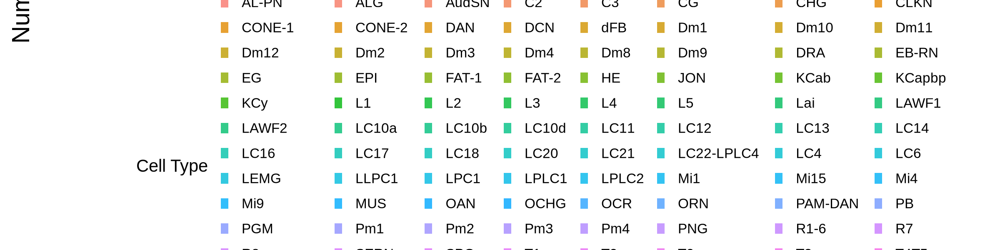

In [34]:
# ─── 0) Load libraries ───────────────────────────────────────────────
library(monocle)    # cds_aggregate_by_type(), exprs(), fData()
library(dplyr)
library(purrr)
library(ggplot2)
library(tibble)     # for rownames_to_column()
library(MetaCycle)  # if you need meta2d later (not used here)

# ─── 1) Build pseudo-replicates & annotate celltype_Conditions ─────
number_of_replicates <- 2

cds$pseudo_replicate <- ave(
  cds$final_timepoints,
  cds$final_timepoints,
  cds$all_celltype,
  FUN = function(x) {
    n <- length(x)
    if (n == 1) {
      paste0(x, "_", sample(1:number_of_replicates, 1))
    } else {
      ids <- rep(1:number_of_replicates, length.out = n)
      ids <- sample(ids)
      paste0(x, "_", ids)
    }
  }
)

cds$Sum2 <- sapply(cds$pseudo_replicate, function(pr) {
  parts   <- strsplit(pr, "_")[[1]]
  base_tp <- as.numeric(gsub("\\D", "", parts[1]))
  rep_id  <- as.integer(parts[2])
  new_tp  <- if (rep_id == 1) base_tp else base_tp + 24
  as.character(new_tp)
})

cds$celltype_Conditions <- paste0(cds$all_celltype, "_", cds$Sum2)

# ─── 2) Subset the CDS for each condition ───────────────────────────
wtzt <- cds[, (cds$light_condition == "LD") & (cds$genotype == "Wild-type")]
wtct <- cds[, (cds$light_condition == "DD") & (cds$genotype == "Wild-type")]
mtzt <- cds[, (cds$light_condition == "LD") & (cds$genotype == "per0")]
mtct <- cds[, (cds$light_condition == "DD") & (cds$genotype == "per0")]

# ─── 3) Helper: aggregate & log1p-CPM normalize by grouping vector ───
cds_cell_type_exprs <- function(cds_obj, grouping) {
  cds_agg <- cds_aggregate_by_type(cds_obj, grouping)
  mat     <- exprs(cds_agg)
  mat     <- t(t(mat) / colSums(mat)) * 1e6
  mat     <- log1p(mat)
  colnames(mat) <- cds_agg$sample
  mat
}

# ─── 4) Build a meta_input list (one DF per pure cell type) ────────
build_meta_input <- function(cds_obj) {
  # mat_all: columns = e.g. "Photoreceptor_0", "Photoreceptor_4", …
  mat_all <- cds_cell_type_exprs(cds_obj, cds_obj$celltype_Conditions)
  # label rows
  rownames(mat_all) <- fData(cds_obj)$gene_short_name
  
  # identify pure cell types
  cts <- unique(sub("_.*$", "", colnames(mat_all)))
  
  # split into one data.frame per cell type
  meta_input <- setNames(vector("list", length(cts)), cts)
  for (ct in cts) {
    mat_ct <- mat_all[, grepl(paste0("^", ct, "_"), colnames(mat_all)), drop = FALSE]
    # extract time
    times  <- as.numeric(sub(".*_(\\d+)$", "\\1", colnames(mat_ct)))
    ord    <- order(times)
    mat_ct <- mat_ct[, ord, drop = FALSE]
    colnames(mat_ct) <- times[ord]
    
    df     <- as.data.frame(mat_ct)
    df$Gene <- rownames(df)
    meta_input[[ct]] <- df[, c("Gene", setdiff(colnames(df), "Gene"))]
  }
  meta_input
}

meta_input_WTLD <- build_meta_input(wtzt)
meta_input_WTDD <- build_meta_input(wtct)
meta_input_MTLD <- build_meta_input(mtzt)
meta_input_MTDD <- build_meta_input(mtct)

# ─── 5) Load your MetaCycle replicate results ───────────────────────
WTLD_1 <- readRDS("results_JTK_ARS_WTLD.rds")
WTLD_2 <- readRDS("results_JTK_ARS_WTLD_2.rds")
WTLD_3 <- readRDS("results_JTK_ARS_WTLD_3.rds")

WTDD_1 <- readRDS("results_JTK_ARS_WTDD.rds")
WTDD_2 <- readRDS("results_JTK_ARS_WTDD_2.rds")
WTDD_3 <- readRDS("results_JTK_ARS_WTDD_3.rds")

MTLD_1 <- readRDS("results_JTK_ARS_MTLD.rds")
MTLD_2 <- readRDS("results_JTK_ARS_MTLD_2.rds")
MTLD_3 <- readRDS("results_JTK_ARS_MTLD_3.rds")

MTDD_1 <- readRDS("results_JTK_ARS_MTDD.rds")
MTDD_2 <- readRDS("results_JTK_ARS_MTDD_2.rds")
MTDD_3 <- readRDS("results_JTK_ARS_MTDD_3.rds")

# ─── 6) Set thresholds & define the filter function ────────────────
median_threshold      <- 1.0
fold_change_threshold <- 1.5
fold_change_threshold <- 0
p_threshold           <- 0.05

generate_averaged_filtered <- function(rep1, rep2, rep3,
                                       meta_input,
                                       median_threshold,
                                       fold_change_threshold,
                                       p_threshold) {
  # only keep cell types in all three reps & in meta_input
  cts <- intersect(intersect(names(rep1), names(rep2)), names(rep3))
  cts <- intersect(cts, names(meta_input))
  out <- list()
  
  for (ct in cts) {
    # pull out meta2d tables
    df1 <- rep1[[ct]]$meta[, c("CycID","meta2d_phase","meta2d_period","meta2d_pvalue")]
    df2 <- rep2[[ct]]$meta[, c("CycID","meta2d_phase","meta2d_period","meta2d_pvalue")]
    df3 <- rep3[[ct]]$meta[, c("CycID","meta2d_phase","meta2d_period","meta2d_pvalue")]
    colnames(df1)[4]   <- "p1"
    colnames(df2)[2:4] <- c("phase2","period2","p2")
    colnames(df3)[2:4] <- c("phase3","period3","p3")
    
    # merge & average, then p‐value filter
    merged <- purrr::reduce(
      list(df1, df2, df3),
      dplyr::inner_join,
      by = "CycID"
    ) %>%
      dplyr::mutate(
        avg_phase  = rowMeans(dplyr::select(., meta2d_phase, phase2, phase3), na.rm=TRUE),
        avg_period = rowMeans(dplyr::select(., meta2d_period, period2, period3), na.rm=TRUE),
        avg_p      = rowMeans(dplyr::select(., p1, p2, p3), na.rm=TRUE)
      ) %>%
      dplyr::filter(avg_p < p_threshold)
    
    # compute median & fold‐change on the same‐condition meta_input
    raw_df <- meta_input[[ct]]
    expr_mat <- as.matrix(raw_df[ , setdiff(names(raw_df), "Gene")])
    rownames(expr_mat) <- raw_df$Gene
    
    med <- apply(expr_mat, 1, median, na.rm=TRUE)
    fc  <- apply(expr_mat, 1, function(x) {
      pos <- x[x>0]
      m1  <- if (length(pos)>0) min(pos) else 1e-10
      max(x, na.rm=TRUE) / m1
    })
    
    keep <- names(med)[ med >= median_threshold & fc >= fold_change_threshold ]
    out[[ct]] <- merged %>% dplyr::filter(CycID %in% keep)
  }
  out
}

# ─── 7) Apply filters per condition ─────────────────────────────────
WTLD <- generate_averaged_filtered(WTLD_1, WTLD_2, WTLD_3,
                                   meta_input_WTLD,
                                   median_threshold,
                                   fold_change_threshold,
                                   p_threshold)
WTDD <- generate_averaged_filtered(WTDD_1, WTDD_2, WTDD_3,
                                   meta_input_WTDD,
                                   median_threshold,
                                   fold_change_threshold,
                                   p_threshold)
MTLD <- generate_averaged_filtered(MTLD_1, MTLD_2, MTLD_3,
                                   meta_input_MTLD,
                                   median_threshold,
                                   fold_change_threshold,
                                   p_threshold)
MTDD <- generate_averaged_filtered(MTDD_1, MTDD_2, MTDD_3,
                                   meta_input_MTDD,
                                   median_threshold,
                                   fold_change_threshold,
                                   p_threshold)

# ─── 8) Bin into 2 h windows & stack for plotting ────────────────────
tidy_counts <- function(dataset_list, label) {
  purrr::map_dfr(dataset_list, function(df) {
    df %>%
      mutate(phase_bin = floor(avg_phase / 2) * 2) %>%
      group_by(phase_bin) %>%
      summarise(n = n(), .groups = "drop")
  }, .id = "cell_type") %>%
    mutate(dataset = label)
}

df_all <- bind_rows(
  tidy_counts(WTLD, "WTLD"),
  tidy_counts(WTDD, "WTDD"),
  tidy_counts(MTLD, "MTLD"),
  tidy_counts(MTDD, "MTDD")
) %>%
  mutate(
    dataset = factor(dataset, c("WTLD","WTDD","MTLD","MTDD")),
    time    = case_when(
      dataset == "WTLD" ~ phase_bin,
      dataset == "WTDD" ~ phase_bin + 24,
      dataset == "MTLD" ~ phase_bin + 48,
      dataset == "MTDD" ~ phase_bin + 72
    )
  )

# ─── 9) Final 2 h–binned stacked‐area plot ───────────────────────────
ggplot(df_all, aes(x = time, y = n, fill = cell_type)) +
  geom_area(position = "stack", alpha = 0.8) +
  geom_vline(xintercept = 48, linetype = "dashed") +
  scale_x_continuous(
    breaks = seq(0, 96, 12),
    labels = c("ZT0","ZT12","CT0","CT12","ZT0","ZT12","CT0","CT12",""),
    limits = c(0, 96), expand = c(0, 0)
  ) +
  labs(
    x    = "Time (ZT/CT, 2 h bins)",
    y    = "Number of rhythmic genes",
    fill = "Cell Type"
  ) +
  theme_minimal(base_size = 14) +
  theme(
    panel.grid      = element_blank(),
    legend.position = "bottom",
    legend.key.size = unit(0.4, "lines"),
    legend.title    = element_text(size = 10),
    legend.text     = element_text(size = 8)
  ) +
  guides(fill = guide_legend(ncol = 8, byrow = TRUE))


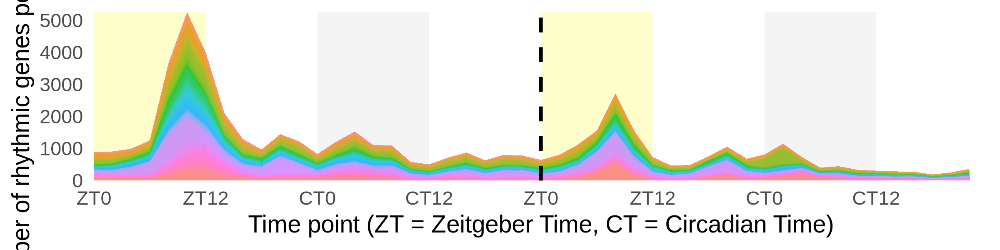

In [35]:
ggplot(df_all, aes(x=time, y=n, fill=cell_type)) +
  annotate("rect", xmin=0,   xmax=12,  ymin=0, ymax=Inf, fill="yellow", alpha=0.2) +
  annotate("rect", xmin=24,  xmax=36,  ymin=0, ymax=Inf, fill="gray80", alpha=0.2) +
  annotate("rect", xmin=48,  xmax=60,  ymin=0, ymax=Inf, fill="yellow", alpha=0.2) +
  annotate("rect", xmin=72,  xmax=84,  ymin=0, ymax=Inf, fill="gray80", alpha=0.2) +
  geom_area(position="stack", alpha=0.8) +
  geom_vline(xintercept=48, color="black", linetype="dashed", size=1) +
  scale_x_continuous(
    breaks = seq(0,96,12),
    labels = c("ZT0","ZT12","CT0","CT12","ZT0","ZT12","CT0","CT12",""),
    limits = c(0,96), expand = c(0,0)
  ) +
  scale_y_continuous(expand=c(0,0)) +
  labs(
    x    = "Time point (ZT = Zeitgeber Time, CT = Circadian Time)",
    y    = "Number of rhythmic genes per cell type",
    fill = "Cell Type"
  ) +
  theme_minimal(base_size=14) +
  theme(
    panel.grid   = element_blank(),
    legend.position = "none",
    legend.key.size = unit(0.4,"lines"),
    legend.title    = element_text(size=10),
    legend.text     = element_text(size=8)
  ) +
  guides(fill = guide_legend(ncol=8, byrow=TRUE, keywidth=unit(1.2,"lines")))

In [9]:
options(repr.plot.width = 8,   # width in inches
        repr.plot.height = 2,  # height in inches
        repr.plot.res = 300)   # resolution in DPI


The following `from` values were not present in `x`: gene_name

The following `from` values were not present in `x`: gene_name

The following `from` values were not present in `x`: gene_name

The following `from` values were not present in `x`: gene_name



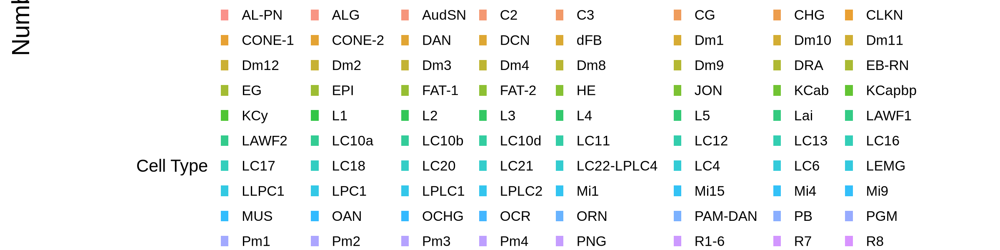

In [18]:
# ─── 0) Load libraries ───────────────────────────────────────────────
library(monocle)    # cds_aggregate_by_type(), exprs(), fData()
library(dplyr)
library(purrr)
library(ggplot2)
library(tibble)     # for rownames_to_column()

# ─── 1) Build pseudo-replicates & annotate celltype_Conditions ─────
number_of_replicates <- 2

cds$pseudo_replicate <- ave(
  cds$final_timepoints,
  cds$final_timepoints,
  cds$all_celltype,
  FUN = function(x) {
    n <- length(x)
    if (n == 1) {
      paste0(x, "_", sample(1:number_of_replicates, 1))
    } else {
      ids <- rep(1:number_of_replicates, length.out = n)
      ids <- sample(ids)
      paste0(x, "_", ids)
    }
  }
)

cds$Sum2 <- sapply(cds$pseudo_replicate, function(pr) {
  parts   <- strsplit(pr, "_")[[1]]
  base_tp <- as.numeric(gsub("\\D", "", parts[1]))
  rep_id  <- as.integer(parts[2])
  new_tp  <- if (rep_id == 1) base_tp else base_tp + 24
  as.character(new_tp)
})

cds$celltype_Conditions <- paste0(cds$all_celltype, "_", cds$Sum2)

# ─── 2) Subset the CDS for each condition ───────────────────────────
wtzt <- cds[, (cds$light_condition == "LD")  & (cds$genotype == "Wild-type")]
wtct <- cds[, (cds$light_condition == "DD")  & (cds$genotype == "Wild-type")]
mtzt <- cds[, (cds$light_condition == "LD")  & (cds$genotype == "per0")]
mtct <- cds[, (cds$light_condition == "DD")  & (cds$genotype == "per0")]

# ─── 3) Helper: aggregate & log1p-CPM normalize by grouping vector ───
cds_cell_type_exprs <- function(cds_obj, grouping) {
  cds_agg <- cds_aggregate_by_type(cds_obj, grouping)
  mat     <- exprs(cds_agg)
  mat     <- t(t(mat) / colSums(mat)) * 1e6
  mat     <- log1p(mat)
  colnames(mat) <- cds_agg$sample
  mat
}

# ─── 4) Build a meta_input list (one DF per pure cell type) ────────
build_meta_input <- function(cds_obj) {
  mat_all <- cds_cell_type_exprs(cds_obj, cds_obj$celltype_Conditions)
  rownames(mat_all) <- fData(cds_obj)$gene_short_name
  cts <- unique(sub("_.*$", "", colnames(mat_all)))
  cts <- Filter(function(ct) any(grepl(paste0("^", ct, "_"), colnames(mat_all))), cts)
  meta_input <- list()
  for (ct in cts) {
    mat_ct <- mat_all[, grepl(paste0("^", ct, "_"), colnames(mat_all)), drop = FALSE]
    if (ncol(mat_ct) == 0) next
    times  <- as.numeric(sub(".*_(\\d+)$", "\\1", colnames(mat_ct)))
    ord    <- order(times)
    mat_ct <- mat_ct[, ord, drop = FALSE]
    colnames(mat_ct) <- times[ord]
    df_ct <- as.data.frame(mat_ct)
    df_ct$Gene <- rownames(df_ct)
    meta_input[[ct]] <- df_ct[, c("Gene", setdiff(colnames(df_ct), "Gene"))]
  }
  meta_input
}

meta_input_WTLD <- build_meta_input(wtzt)
meta_input_WTDD <- build_meta_input(wtct)
meta_input_MTLD <- build_meta_input(mtzt)
meta_input_MTDD <- build_meta_input(mtct)

# ─── 5) Load your MetaCycle replicate results ───────────────────────
WTLD_1 <- readRDS("results_JTK_ARS_WTLD_M_1.rds")
WTLD_2 <- readRDS("results_JTK_ARS_WTLD_M_2.rds")
WTLD_3 <- readRDS("results_JTK_ARS_WTLD_M_3.rds")

WTDD_1 <- readRDS("results_JTK_ARS_WTDD_M_1.rds")
WTDD_2 <- readRDS("results_JTK_ARS_WTDD_M_2.rds")
WTDD_3 <- readRDS("results_JTK_ARS_WTDD_M_3.rds")

MTLD_1 <- readRDS("results_JTK_ARS_MTLD_M_1.rds")
MTLD_2 <- readRDS("results_JTK_ARS_MTLD_M_2.rds")
MTLD_3 <- readRDS("results_JTK_ARS_MTLD_M_3.rds")

MTDD_1 <- readRDS("results_JTK_ARS_MTDD_M_1.rds")
MTDD_2 <- readRDS("results_JTK_ARS_MTDD_M_2.rds")
MTDD_3 <- readRDS("results_JTK_ARS_MTDD_M_3.rds")

# ─── 6) Set thresholds & define the filter function ────────────────
median_threshold      <- 1.0
fold_change_threshold <- 1.0
p_threshold           <- 0.05

generate_averaged_filtered <- function(rep1, rep2, rep3,
                                       meta_input,
                                       median_threshold,
                                       fold_change_threshold,
                                       p_threshold) {
  required_cols <- c("CycID","meta2d_phase","meta2d_period","meta2d_pvalue")
  cts <- intersect(intersect(names(rep1), names(rep2)), names(rep3))
  cts <- intersect(cts, names(meta_input))
  out <- list()
  for (ct in cts) {
    # check that meta exists and has required columns
    metas <- list(rep1, rep2, rep3)
    if (any(sapply(metas, function(r) is.null(r[[ct]]$meta)))) {
      warning("Skipping ", ct, ": missing meta table")
      next
    }
    if (any(sapply(metas, function(r) !all(required_cols %in% colnames(r[[ct]]$meta))))) {
      warning("Skipping ", ct, ": incomplete meta2d columns")
      next
    }
    df1 <- rep1[[ct]]$meta[, required_cols]
    df2 <- rep2[[ct]]$meta[, required_cols]
    df3 <- rep3[[ct]]$meta[, required_cols]
    colnames(df1)[4]   <- "p1"
    colnames(df2)[2:4] <- c("phase2","period2","p2")
    colnames(df3)[2:4] <- c("phase3","period3","p3")
    merged <- purrr::reduce(
      list(df1, df2, df3),
      dplyr::inner_join,
      by = "CycID"
    ) %>%
      dplyr::mutate(
        avg_phase  = rowMeans(dplyr::select(., meta2d_phase, phase2, phase3), na.rm = TRUE),
        avg_period = rowMeans(dplyr::select(., meta2d_period, period2, period3), na.rm = TRUE),
        avg_p      = rowMeans(dplyr::select(., p1, p2, p3), na.rm = TRUE)
      ) %>%
      dplyr::filter(avg_p < p_threshold)
    raw_df <- meta_input[[ct]]
    if (is.null(raw_df) || ncol(raw_df) < 2) {
      warning("Skipping ", ct, ": no expression columns")
      next
    }
    expr_mat <- as.matrix(raw_df[, setdiff(colnames(raw_df), "Gene")])
    rownames(expr_mat) <- raw_df$Gene
    med <- apply(expr_mat, 1, median, na.rm = TRUE)
    fc  <- apply(expr_mat, 1, function(x) {
      pos <- x[x > 0]
      m1  <- if (length(pos) > 0) min(pos) else 1e-10
      max(x, na.rm = TRUE) / m1
    })
    keep <- names(med)[med >= median_threshold & fc >= fold_change_threshold]
    out[[ct]] <- merged %>% dplyr::filter(CycID %in% keep)
  }
  out
}

# ─── 7) Apply filters per condition ─────────────────────────────────
WTLD <- generate_averaged_filtered(WTLD_1, WTLD_2, WTLD_3,
                                   meta_input_WTLD,
                                   median_threshold,
                                   fold_change_threshold,
                                   p_threshold)
WTDD <- generate_averaged_filtered(WTDD_1, WTDD_2, WTDD_3,
                                   meta_input_WTDD,
                                   median_threshold,
                                   fold_change_threshold,
                                   p_threshold)
MTLD <- generate_averaged_filtered(MTLD_1, MTLD_2, MTLD_3,
                                   meta_input_MTLD,
                                   median_threshold,
                                   fold_change_threshold,
                                   p_threshold)
MTDD <- generate_averaged_filtered(MTDD_1, MTDD_2, MTDD_3,
                                   meta_input_MTDD,
                                   median_threshold,
                                   fold_change_threshold,
                                   p_threshold)

# ─── 8) Bin into 2 h windows & stack for plotting ────────────────────
tidy_counts <- function(dataset_list, label) {
  purrr::map_dfr(dataset_list, function(df) {
    df %>%
      mutate(phase_bin = floor(avg_phase / 2) * 2) %>%
      group_by(phase_bin) %>%
      summarise(n = n(), .groups = "drop")
  }, .id = "cell_type") %>%
    mutate(dataset = label)
}

df_all <- bind_rows(
  tidy_counts(WTLD, "WTLD"),
  tidy_counts(WTDD, "WTDD"),
  tidy_counts(MTLD, "MTLD"),
  tidy_counts(MTDD, "MTDD")
) %>%
  mutate(
    dataset = factor(dataset, c("WTLD","WTDD","MTLD","MTDD")),
    time    = case_when(
      dataset == "WTLD" ~ phase_bin,
      dataset == "WTDD" ~ phase_bin + 24,
      dataset == "MTLD" ~ phase_bin + 48,
      dataset == "MTDD" ~ phase_bin + 72
    )
  )

# ─── 9) Final 2 h–binned stacked-area plot ───────────────────────────
ggplot(df_all, aes(x = time, y = n, fill = cell_type)) +
  geom_area(position = "stack", alpha = 0.8) +
  geom_vline(xintercept = 48, linetype = "dashed") +
  scale_x_continuous(
    breaks = seq(0, 96, 12),
    labels = c("ZT0","ZT12","CT0","CT12","ZT0","ZT12","CT0","CT12",""),
    limits = c(0, 96), expand = c(0, 0)
  ) +
  labs(
    x    = "Time (ZT/CT, 2 h bins)",
    y    = "Number of rhythmic genes",
    fill = "Cell Type"
  ) +
  theme_minimal(base_size = 14) +
  theme(
    panel.grid      = element_blank(),
    legend.position = "bottom",
    legend.key.size = unit(0.4, "lines"),
    legend.title    = element_text(size = 10),
    legend.text     = element_text(size = 8)
  ) +
  guides(fill = guide_legend(ncol = 8, byrow = TRUE))


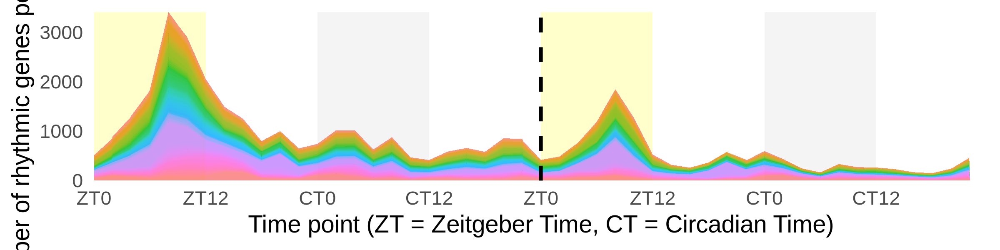

In [19]:
ggplot(df_all, aes(x=time, y=n, fill=cell_type)) +
  annotate("rect", xmin=0,   xmax=12,  ymin=0, ymax=Inf, fill="yellow", alpha=0.2) +
  annotate("rect", xmin=24,  xmax=36,  ymin=0, ymax=Inf, fill="gray80", alpha=0.2) +
  annotate("rect", xmin=48,  xmax=60,  ymin=0, ymax=Inf, fill="yellow", alpha=0.2) +
  annotate("rect", xmin=72,  xmax=84,  ymin=0, ymax=Inf, fill="gray80", alpha=0.2) +
  geom_area(position="stack", alpha=0.8) +
  geom_vline(xintercept=48, color="black", linetype="dashed", size=1) +
  scale_x_continuous(
    breaks = seq(0,96,12),
    labels = c("ZT0","ZT12","CT0","CT12","ZT0","ZT12","CT0","CT12",""),
    limits = c(0,96), expand = c(0,0)
  ) +
  scale_y_continuous(expand=c(0,0)) +
  labs(
    x    = "Time point (ZT = Zeitgeber Time, CT = Circadian Time)",
    y    = "Number of rhythmic genes per cell type",
    fill = "Cell Type"
  ) +
  theme_minimal(base_size=14) +
  theme(
    panel.grid   = element_blank(),
    legend.position = "none",
    legend.key.size = unit(0.4,"lines"),
    legend.title    = element_text(size=10),
    legend.text     = element_text(size=8)
  ) +
  guides(fill = guide_legend(ncol=8, byrow=TRUE, keywidth=unit(1.2,"lines")))

The following `from` values were not present in `x`: gene_name

The following `from` values were not present in `x`: gene_name

The following `from` values were not present in `x`: gene_name

The following `from` values were not present in `x`: gene_name



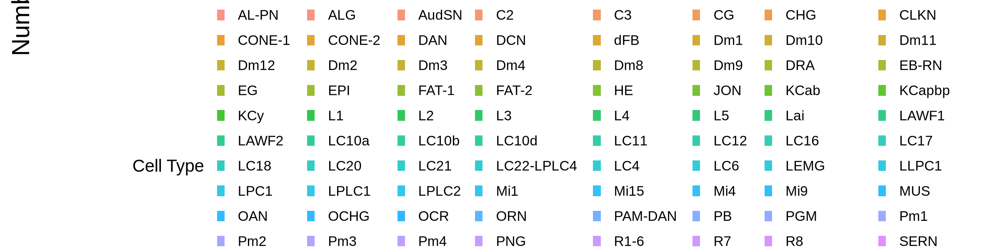

In [14]:
# ─── 0) Load libraries ───────────────────────────────────────────────
library(monocle)    # cds_aggregate_by_type(), exprs(), fData()
library(dplyr)
library(purrr)
library(ggplot2)
library(tibble)     # for rownames_to_column()

# ─── 1) Build pseudo-replicates & annotate celltype_Conditions ─────
number_of_replicates <- 2

cds$pseudo_replicate <- ave(
  cds$final_timepoints,
  cds$final_timepoints,
  cds$all_celltype,
  FUN = function(x) {
    n <- length(x)
    if (n == 1) {
      paste0(x, "_", sample(1:number_of_replicates, 1))
    } else {
      ids <- rep(1:number_of_replicates, length.out = n)
      ids <- sample(ids)
      paste0(x, "_", ids)
    }
  }
)

cds$Sum2 <- sapply(cds$pseudo_replicate, function(pr) {
  parts   <- strsplit(pr, "_")[[1]]
  base_tp <- as.numeric(gsub("\\D", "", parts[1]))
  rep_id  <- as.integer(parts[2])
  new_tp  <- if (rep_id == 1) base_tp else base_tp + 24
  as.character(new_tp)
})

cds$celltype_Conditions <- paste0(cds$all_celltype, "_", cds$Sum2)

# ─── 2) Subset the CDS for each condition ───────────────────────────
wtzt <- cds[, (cds$light_condition == "LD")  & (cds$genotype == "Wild-type")]
wtct <- cds[, (cds$light_condition == "DD")  & (cds$genotype == "Wild-type")]
mtzt <- cds[, (cds$light_condition == "LD")  & (cds$genotype == "per0")]
mtct <- cds[, (cds$light_condition == "DD")  & (cds$genotype == "per0")]

# ─── 3) Helper: aggregate & log1p-CPM normalize by grouping vector ───
cds_cell_type_exprs <- function(cds_obj, grouping) {
  cds_agg <- cds_aggregate_by_type(cds_obj, grouping)
  mat     <- exprs(cds_agg)
  mat     <- t(t(mat) / colSums(mat)) * 1e6
  mat     <- log1p(mat)
  colnames(mat) <- cds_agg$sample
  mat
}

# ─── 4) Build a meta_input list (one DF per pure cell type) ────────
build_meta_input <- function(cds_obj) {
  mat_all <- cds_cell_type_exprs(cds_obj, cds_obj$celltype_Conditions)
  rownames(mat_all) <- fData(cds_obj)$gene_short_name
  cts <- unique(sub("_.*$", "", colnames(mat_all)))
  cts <- Filter(function(ct) any(grepl(paste0("^", ct, "_"), colnames(mat_all))), cts)
  meta_input <- list()
  for (ct in cts) {
    mat_ct <- mat_all[, grepl(paste0("^", ct, "_"), colnames(mat_all)), drop = FALSE]
    if (ncol(mat_ct) == 0) next
    times  <- as.numeric(sub(".*_(\\d+)$", "\\1", colnames(mat_ct)))
    ord    <- order(times)
    mat_ct <- mat_ct[, ord, drop = FALSE]
    colnames(mat_ct) <- times[ord]
    df_ct <- as.data.frame(mat_ct)
    df_ct$Gene <- rownames(df_ct)
    meta_input[[ct]] <- df_ct[, c("Gene", setdiff(colnames(df_ct), "Gene"))]
  }
  meta_input
}

meta_input_WTLD <- build_meta_input(wtzt)
meta_input_WTDD <- build_meta_input(wtct)
meta_input_MTLD <- build_meta_input(mtzt)
meta_input_MTDD <- build_meta_input(mtct)

# ─── 5) Load your MetaCycle replicate results ───────────────────────
WTLD_1 <- readRDS("results_JTK_ARS_WTLD_F_1.rds")
WTLD_2 <- readRDS("results_JTK_ARS_WTLD_F_2.rds")
WTLD_3 <- readRDS("results_JTK_ARS_WTLD_F_3.rds")

WTDD_1 <- readRDS("results_JTK_ARS_WTDD_F_1.rds")
WTDD_2 <- readRDS("results_JTK_ARS_WTDD_F_2.rds")
WTDD_3 <- readRDS("results_JTK_ARS_WTDD_F_3.rds")

MTLD_1 <- readRDS("results_JTK_ARS_MTLD_F_1.rds")
MTLD_2 <- readRDS("results_JTK_ARS_MTLD_F_2.rds")
MTLD_3 <- readRDS("results_JTK_ARS_MTLD_F_3.rds")

MTDD_1 <- readRDS("results_JTK_ARS_MTDD_F_1.rds")
MTDD_2 <- readRDS("results_JTK_ARS_MTDD_F_2.rds")
MTDD_3 <- readRDS("results_JTK_ARS_MTDD_F_3.rds")

# ─── 6) Set thresholds & define the filter function ────────────────
median_threshold      <- 1.0
fold_change_threshold <- 1.0
p_threshold           <- 0.05

generate_averaged_filtered <- function(rep1, rep2, rep3,
                                       meta_input,
                                       median_threshold,
                                       fold_change_threshold,
                                       p_threshold) {
  required_cols <- c("CycID","meta2d_phase","meta2d_period","meta2d_pvalue")
  cts <- intersect(intersect(names(rep1), names(rep2)), names(rep3))
  cts <- intersect(cts, names(meta_input))
  out <- list()
  for (ct in cts) {
    # check that meta exists and has required columns
    metas <- list(rep1, rep2, rep3)
    if (any(sapply(metas, function(r) is.null(r[[ct]]$meta)))) {
      warning("Skipping ", ct, ": missing meta table")
      next
    }
    if (any(sapply(metas, function(r) !all(required_cols %in% colnames(r[[ct]]$meta))))) {
      warning("Skipping ", ct, ": incomplete meta2d columns")
      next
    }
    df1 <- rep1[[ct]]$meta[, required_cols]
    df2 <- rep2[[ct]]$meta[, required_cols]
    df3 <- rep3[[ct]]$meta[, required_cols]
    colnames(df1)[4]   <- "p1"
    colnames(df2)[2:4] <- c("phase2","period2","p2")
    colnames(df3)[2:4] <- c("phase3","period3","p3")
    merged <- purrr::reduce(
      list(df1, df2, df3),
      dplyr::inner_join,
      by = "CycID"
    ) %>%
      dplyr::mutate(
        avg_phase  = rowMeans(dplyr::select(., meta2d_phase, phase2, phase3), na.rm = TRUE),
        avg_period = rowMeans(dplyr::select(., meta2d_period, period2, period3), na.rm = TRUE),
        avg_p      = rowMeans(dplyr::select(., p1, p2, p3), na.rm = TRUE)
      ) %>%
      dplyr::filter(avg_p < p_threshold)
    raw_df <- meta_input[[ct]]
    if (is.null(raw_df) || ncol(raw_df) < 2) {
      warning("Skipping ", ct, ": no expression columns")
      next
    }
    expr_mat <- as.matrix(raw_df[, setdiff(colnames(raw_df), "Gene")])
    rownames(expr_mat) <- raw_df$Gene
    med <- apply(expr_mat, 1, median, na.rm = TRUE)
    fc  <- apply(expr_mat, 1, function(x) {
      pos <- x[x > 0]
      m1  <- if (length(pos) > 0) min(pos) else 1e-10
      max(x, na.rm = TRUE) / m1
    })
    keep <- names(med)[med >= median_threshold & fc >= fold_change_threshold]
    out[[ct]] <- merged %>% dplyr::filter(CycID %in% keep)
  }
  out
}

# ─── 7) Apply filters per condition ─────────────────────────────────
WTLD <- generate_averaged_filtered(WTLD_1, WTLD_2, WTLD_3,
                                   meta_input_WTLD,
                                   median_threshold,
                                   fold_change_threshold,
                                   p_threshold)
WTDD <- generate_averaged_filtered(WTDD_1, WTDD_2, WTDD_3,
                                   meta_input_WTDD,
                                   median_threshold,
                                   fold_change_threshold,
                                   p_threshold)
MTLD <- generate_averaged_filtered(MTLD_1, MTLD_2, MTLD_3,
                                   meta_input_MTLD,
                                   median_threshold,
                                   fold_change_threshold,
                                   p_threshold)
MTDD <- generate_averaged_filtered(MTDD_1, MTDD_2, MTDD_3,
                                   meta_input_MTDD,
                                   median_threshold,
                                   fold_change_threshold,
                                   p_threshold)

# ─── 8) Bin into 2 h windows & stack for plotting ────────────────────
tidy_counts <- function(dataset_list, label) {
  purrr::map_dfr(dataset_list, function(df) {
    df %>%
      mutate(phase_bin = floor(avg_phase / 2) * 2) %>%
      group_by(phase_bin) %>%
      summarise(n = n(), .groups = "drop")
  }, .id = "cell_type") %>%
    mutate(dataset = label)
}

df_all <- bind_rows(
  tidy_counts(WTLD, "WTLD"),
  tidy_counts(WTDD, "WTDD"),
  tidy_counts(MTLD, "MTLD"),
  tidy_counts(MTDD, "MTDD")
) %>%
  mutate(
    dataset = factor(dataset, c("WTLD","WTDD","MTLD","MTDD")),
    time    = case_when(
      dataset == "WTLD" ~ phase_bin,
      dataset == "WTDD" ~ phase_bin + 24,
      dataset == "MTLD" ~ phase_bin + 48,
      dataset == "MTDD" ~ phase_bin + 72
    )
  )

# ─── 9) Final 2 h–binned stacked-area plot ───────────────────────────
ggplot(df_all, aes(x = time, y = n, fill = cell_type)) +
  geom_area(position = "stack", alpha = 0.8) +
  geom_vline(xintercept = 48, linetype = "dashed") +
  scale_x_continuous(
    breaks = seq(0, 96, 12),
    labels = c("ZT0","ZT12","CT0","CT12","ZT0","ZT12","CT0","CT12",""),
    limits = c(0, 96), expand = c(0, 0)
  ) +
  labs(
    x    = "Time (ZT/CT, 2 h bins)",
    y    = "Number of rhythmic genes",
    fill = "Cell Type"
  ) +
  theme_minimal(base_size = 14) +
  theme(
    panel.grid      = element_blank(),
    legend.position = "bottom",
    legend.key.size = unit(0.4, "lines"),
    legend.title    = element_text(size = 10),
    legend.text     = element_text(size = 8)
  ) +
  guides(fill = guide_legend(ncol = 8, byrow = TRUE))


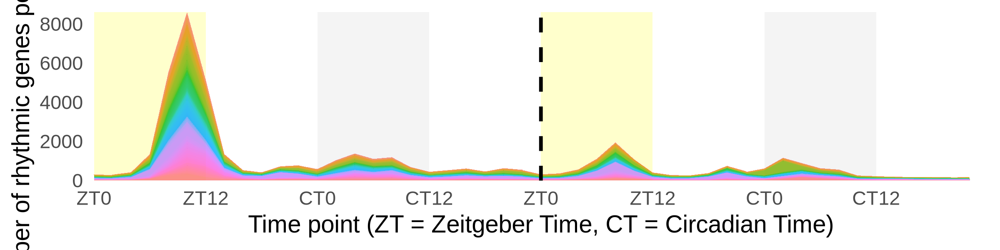

In [15]:
ggplot(df_all, aes(x=time, y=n, fill=cell_type)) +
  annotate("rect", xmin=0,   xmax=12,  ymin=0, ymax=Inf, fill="yellow", alpha=0.2) +
  annotate("rect", xmin=24,  xmax=36,  ymin=0, ymax=Inf, fill="gray80", alpha=0.2) +
  annotate("rect", xmin=48,  xmax=60,  ymin=0, ymax=Inf, fill="yellow", alpha=0.2) +
  annotate("rect", xmin=72,  xmax=84,  ymin=0, ymax=Inf, fill="gray80", alpha=0.2) +
  geom_area(position="stack", alpha=0.8) +
  geom_vline(xintercept=48, color="black", linetype="dashed", size=1) +
  scale_x_continuous(
    breaks = seq(0,96,12),
    labels = c("ZT0","ZT12","CT0","CT12","ZT0","ZT12","CT0","CT12",""),
    limits = c(0,96), expand = c(0,0)
  ) +
  scale_y_continuous(expand=c(0,0)) +
  labs(
    x    = "Time point (ZT = Zeitgeber Time, CT = Circadian Time)",
    y    = "Number of rhythmic genes per cell type",
    fill = "Cell Type"
  ) +
  theme_minimal(base_size=14) +
  theme(
    panel.grid   = element_blank(),
    legend.position = "none",
    legend.key.size = unit(0.4,"lines"),
    legend.title    = element_text(size=10),
    legend.text     = element_text(size=8)
  ) +
  guides(fill = guide_legend(ncol=8, byrow=TRUE, keywidth=unit(1.2,"lines")))

In [20]:
# ─── 8) Save each filtered result to CSV ──────────────────────────────────────
save_filtered <- function(dataset_list, prefix) {
  for (ct in names(dataset_list)) {
    # build filename, e.g. "WTLD_Photoreceptor.csv" or "WTDD_Glia.csv"
    fname <- paste0(prefix, "_", ct, ".csv")
    write.csv(dataset_list[[ct]], file = fname, row.names = FALSE)
  }
}

save_filtered(WTLD, "WTLD_M")
save_filtered(WTDD, "WTDD_M")
save_filtered(MTLD, "MTLD_M")
save_filtered(MTDD, "MTDD_M")
